# GUC Clustering Project

**Objective:**
The objective of this project teach students how to apply clustering to real data sets

The projects aims to teach student:
* Which clustering approach to use
* Compare between Kmeans, Hierarchal, DBScan, and Gaussian Mixtures  
* How to tune the parameters of each data approach
* What is the effect of different distance functions (optional)
* How to evaluate clustering approachs
* How to display the output
* What is the effect of normalizing the data

Students in this project will use ready-made functions from Sklearn, plotnine, numpy and pandas




In [ ]:
# if plotnine is not installed in Jupter then use the following command to install it


Running this project require the following imports

In [ ]:
import warnings
warnings.filterwarnings('ignore')
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import sklearn.preprocessing as prep
from sklearn.datasets import make_blobs
from plotnine import *
# StandardScaler is a function to normalize the data
# You may also check MinMaxScaler and MaxAbsScaler
#from sklearn.preprocessing import StandardScaler
from sklearn.neighbors import NearestNeighbors

from sklearn.cluster import DBSCAN


from sklearn.cluster import KMeans
from sklearn.mixture import GaussianMixture

from sklearn.metrics import silhouette_score

%matplotlib inline

In [ ]:
# helper function that allows us to display data in 2 dimensions an highlights the clusters
def display_cluster(X,km=[],num_clusters=0):
    color = ['b', 'r', 'g', 'c', 'm', 'y', 'k', 'violet', 'aqua', 'pink']   #List colors
    alpha = 0.5  #color obaque
    s = 20
    if num_clusters == 0:
        plt.scatter(X[:,0],X[:,1],c = color[0],alpha = alpha,s = s)
    else:
        for i in range(num_clusters):
            plt.scatter(X[km.labels_==i,0],X[km.labels_==i,1],c = color[i],alpha = alpha,s=s)
            plt.scatter(km.cluster_centers_[i][0],km.cluster_centers_[i][1],c = color[i], marker = 'x', s = 100)

## Multi Blob Data Set
* The Data Set generated below has 6 cluster with varying number of users and varing densities
* Cluster the data set below using



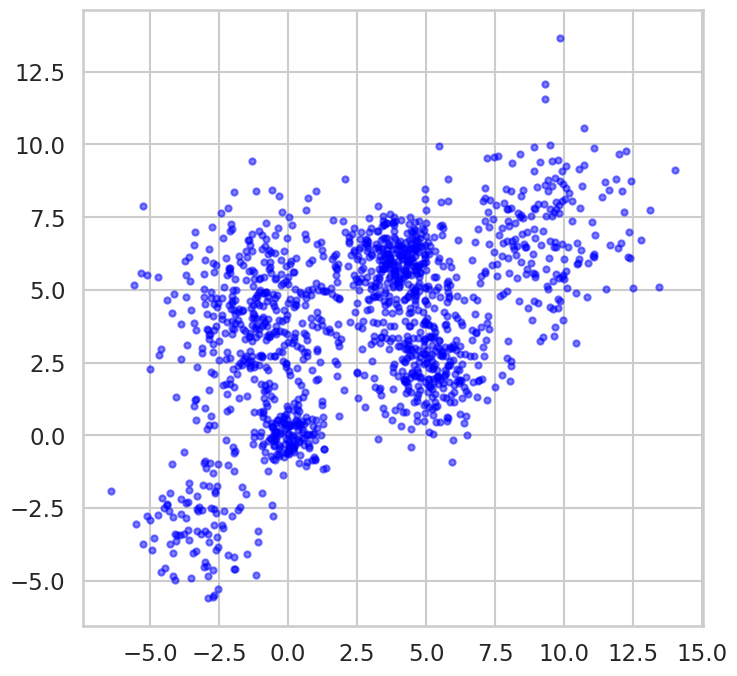

In [ ]:
plt.rcParams['figure.figsize'] = [8,8]
sns.set_style("whitegrid")
sns.set_context("talk")

n_bins = 6
centers = [(-3, -3), (0, 0), (5,2.5),(-1, 4), (4, 6), (9,7)]
Multi_blob_Data, y = make_blobs(n_samples=[100,150, 300, 400,300, 200], n_features=2, cluster_std=[1.3,0.6, 1.2, 1.7,0.9,1.7],
                  centers=centers, shuffle=False, random_state=42)
display_cluster(Multi_blob_Data)

### Kmeans
* Use Kmeans with different values of K to cluster the above data
* Display the outcome of each value of K
* Plot distortion function versus K and choose the approriate value of k
* Plot the silhouette_score versus K and use it to choose the best K
* Store the silhouette_score for the best K for later comparison with other clustering techniques.

Best value of K based on silhouette score: 6
Best silhouette score: 0.48614459735646176


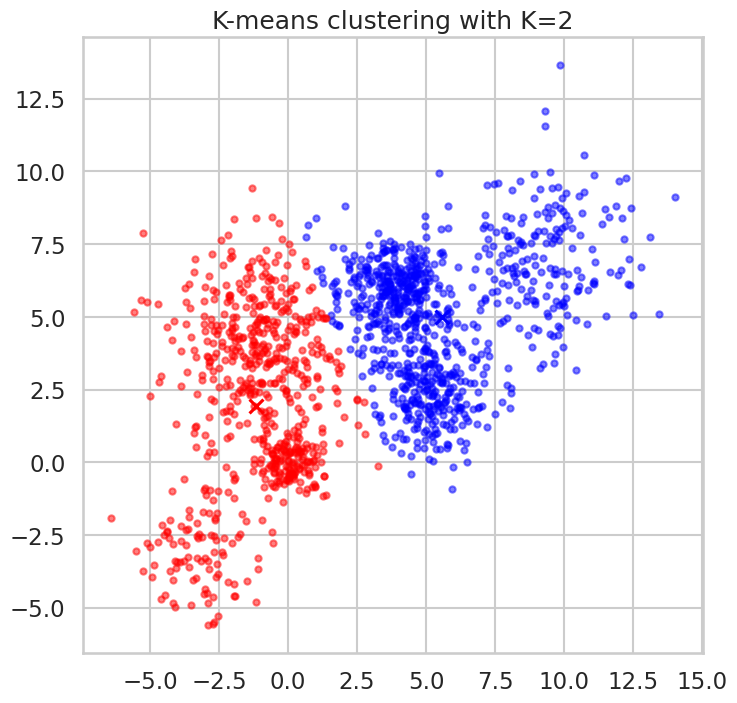

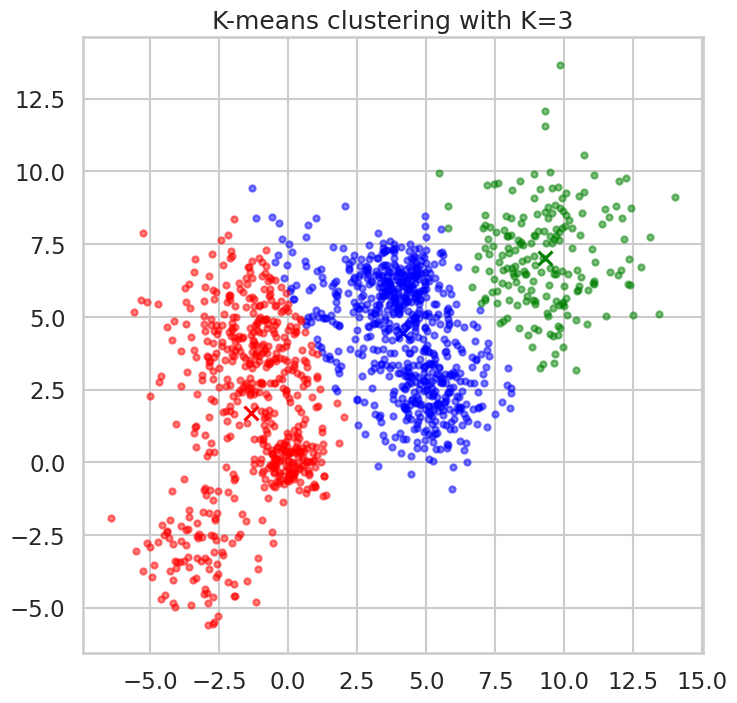

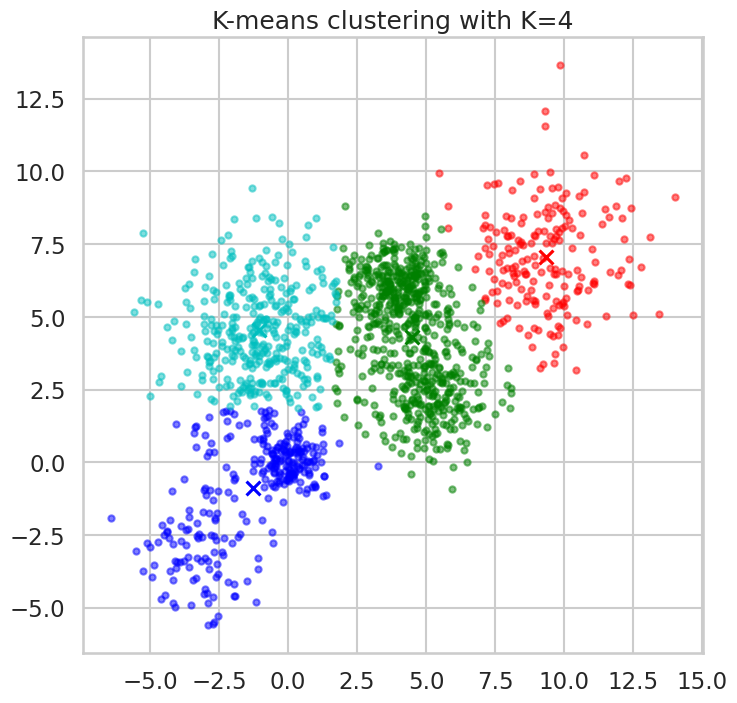

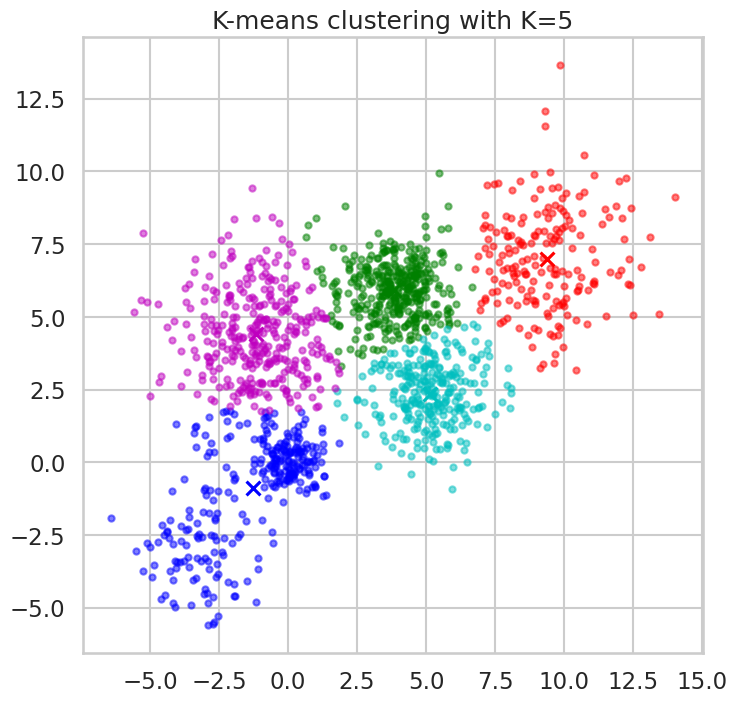

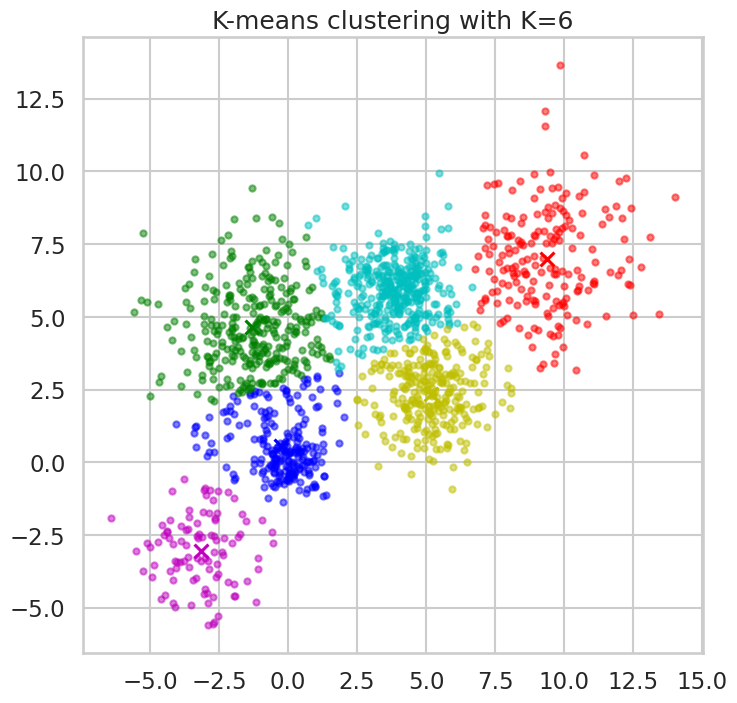

...

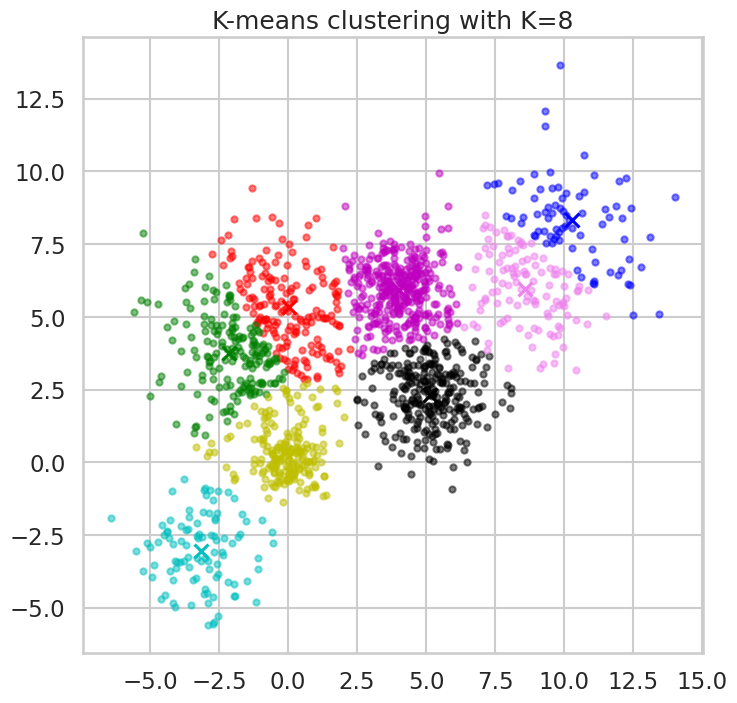

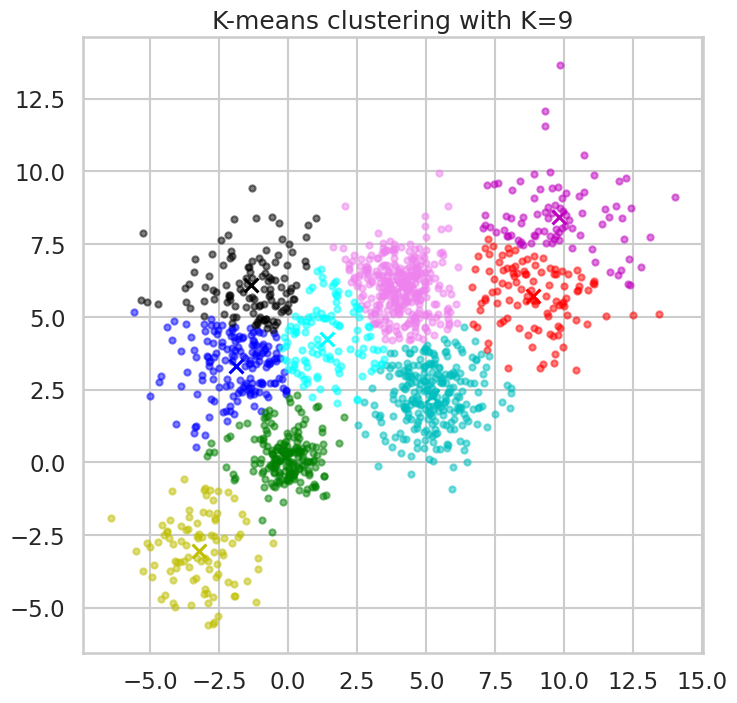

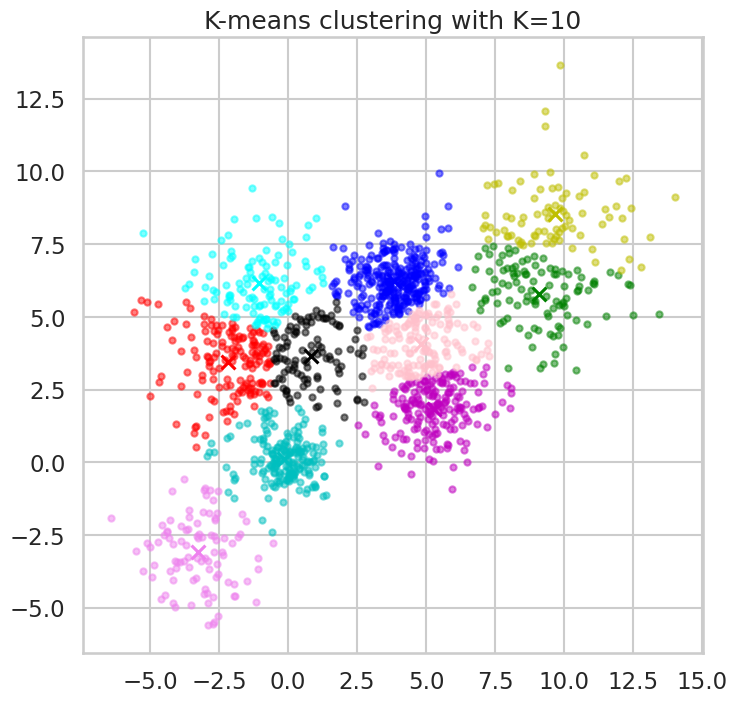

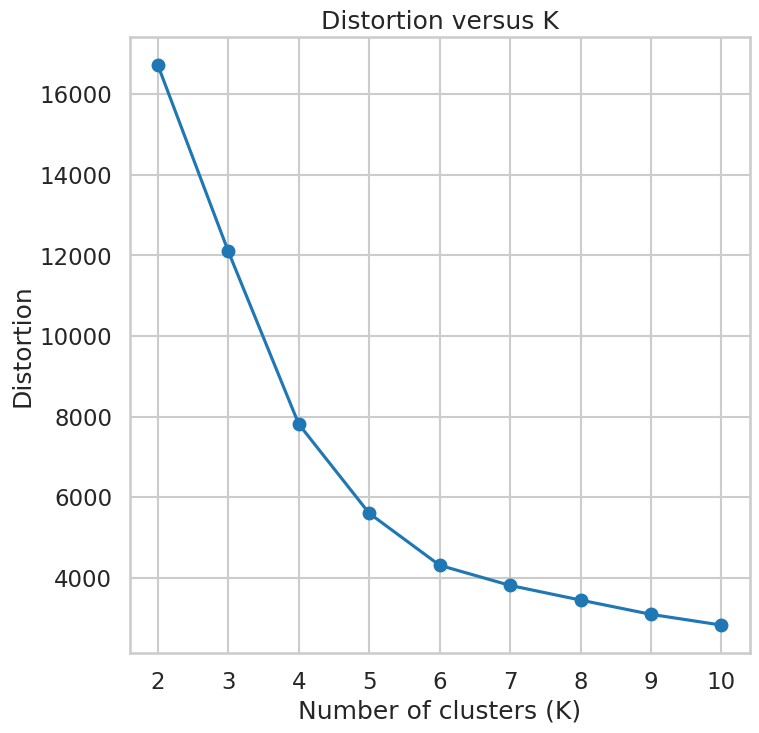

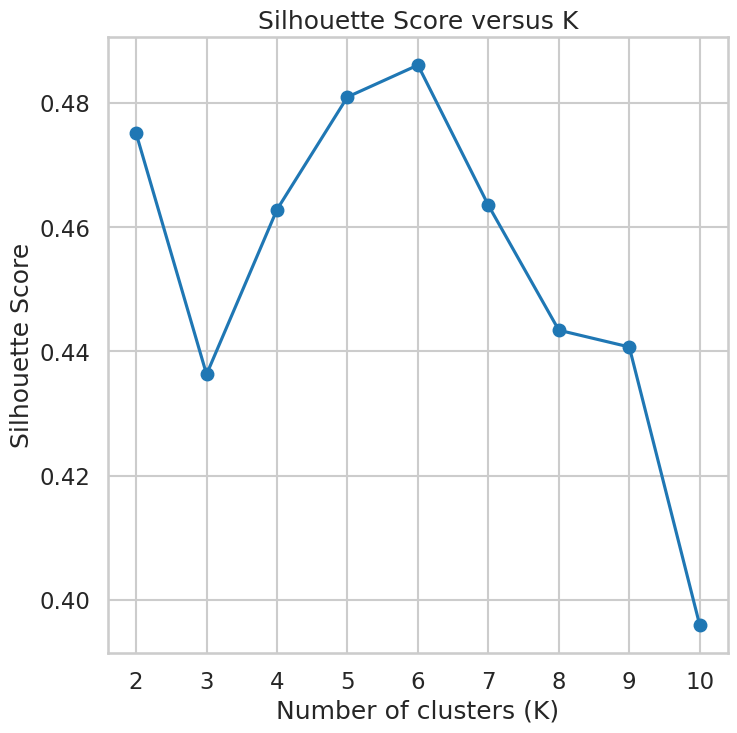

In [ ]:
# Perform K-means clustering with different values of K
K_values = range(2, 11)  # Values of K to try
distortions = []  # List to store distortion values
silhouette_scores = []  # List to store silhouette scores

for k in K_values:
    km = KMeans(n_clusters=k, random_state=42)
    km.fit(Multi_blob_Data)
    distortions.append(km.inertia_)  # Sum of squared distances to closest cluster center
    silhouette_scores.append(silhouette_score(Multi_blob_Data, km.labels_))  # Silhouette score

    # Display clusters for each value of K
    plt.figure()
    plt.title("K-means clustering with K={}".format(k))
    display_cluster(Multi_blob_Data, km, k)

# Plot distortion function versus K
plt.figure()
plt.plot(K_values, distortions, marker='o')
plt.xlabel('Number of clusters (K)')
plt.ylabel('Distortion')
plt.title('Distortion versus K')

# Plot silhouette score versus K
plt.figure()
plt.plot(K_values, silhouette_scores, marker='o')
plt.xlabel('Number of clusters (K)')
plt.ylabel('Silhouette Score')
plt.title('Silhouette Score versus K')

# Find the best value of K based on silhouette score
best_K = K_values[np.argmax(silhouette_scores)]
print("Best value of K based on silhouette score:", best_K)
print("Best silhouette score:",np.max(silhouette_scores) )
plt.show()

### Hierarchal Clustering
* Use AgglomerativeClustering function to  to cluster the above data
* In the  AgglomerativeClustering change the following parameters
    * Affinity (use euclidean, manhattan and cosine)
    * Linkage( use average and single )
    * Distance_threshold (try different)
* For each of these trials plot the Dendograph , calculate the silhouette_score and display the resulting clusters  
* Find the set of paramters that would find result in the best silhouette_score and store this score for later comparison with other clustering techniques.
* Record your observation

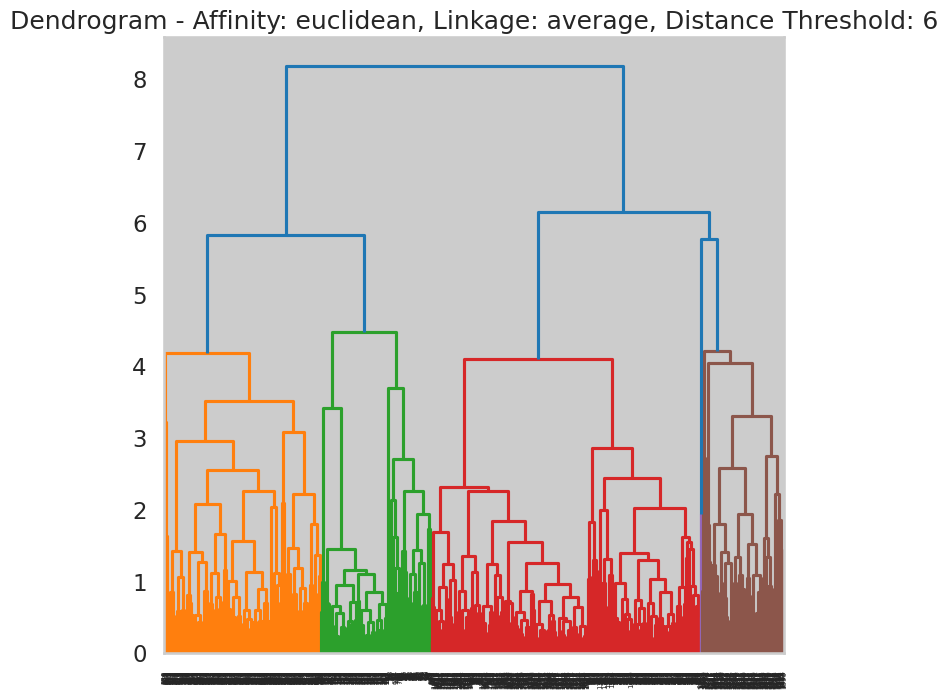

LENGTHHHHHHHHH ::::::::::::::::: 3


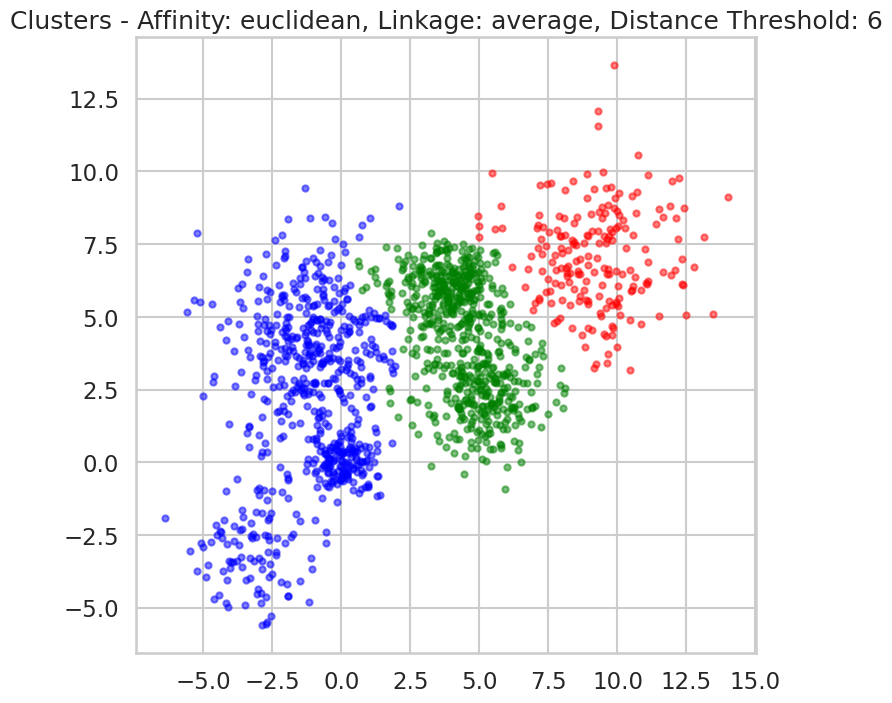

Silhouette Score - Affinity: euclidean, Linkage: average, Distance Threshold: 6: 0.4307906732655957


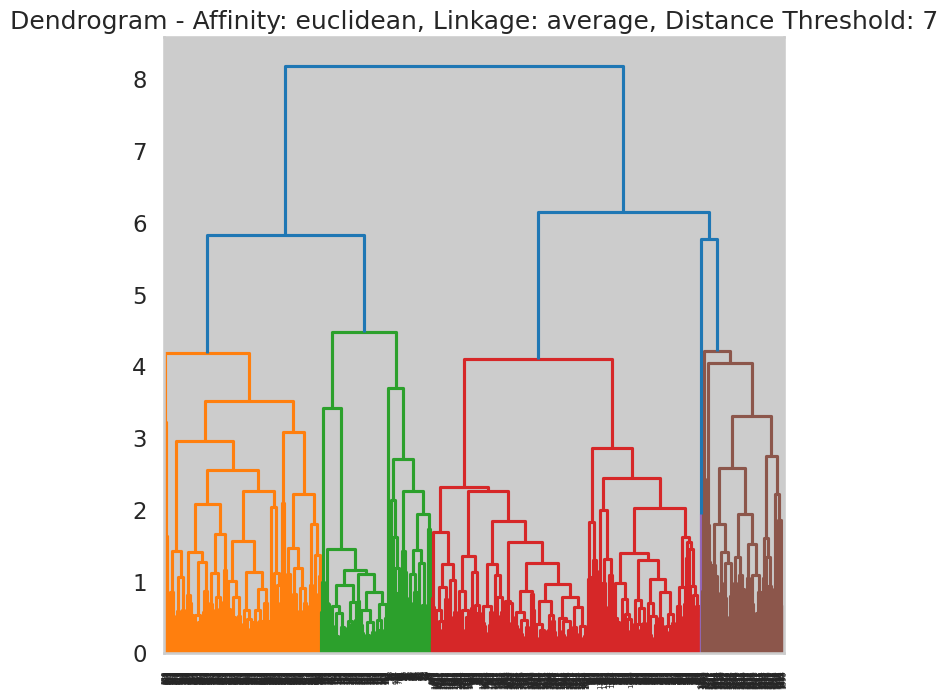

LENGTHHHHHHHHH ::::::::::::::::: 2


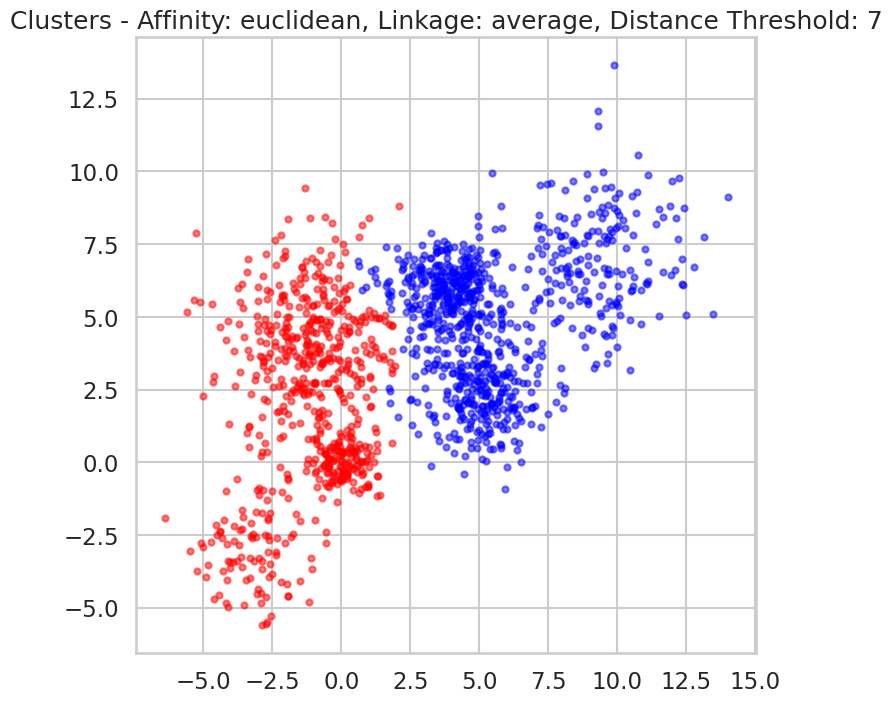

Silhouette Score - Affinity: euclidean, Linkage: average, Distance Threshold: 7: 0.4716908069861964


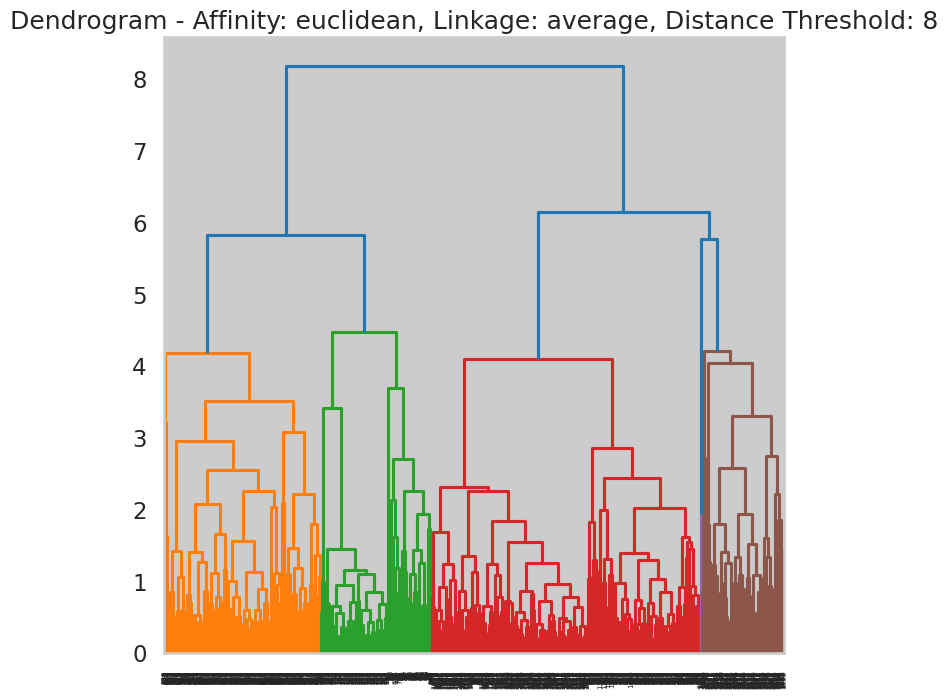

LENGTHHHHHHHHH ::::::::::::::::: 2


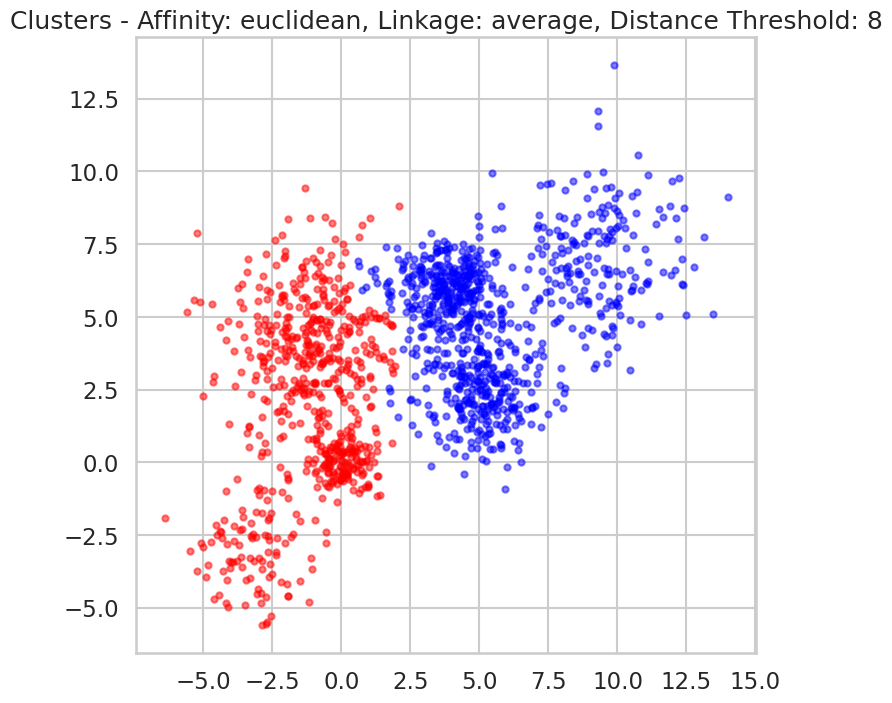

Silhouette Score - Affinity: euclidean, Linkage: average, Distance Threshold: 8: 0.4716908069861964
Only one cluster created - Affinity: euclidean, Linkage: single, Distance Threshold: 6. Skipping...
Only one cluster created - Affinity: euclidean, Linkage: single, Distance Threshold: 7. Skipping...
Only one cluster created - Affinity: euclidean, Linkage: single, Distance Threshold: 8. Skipping...


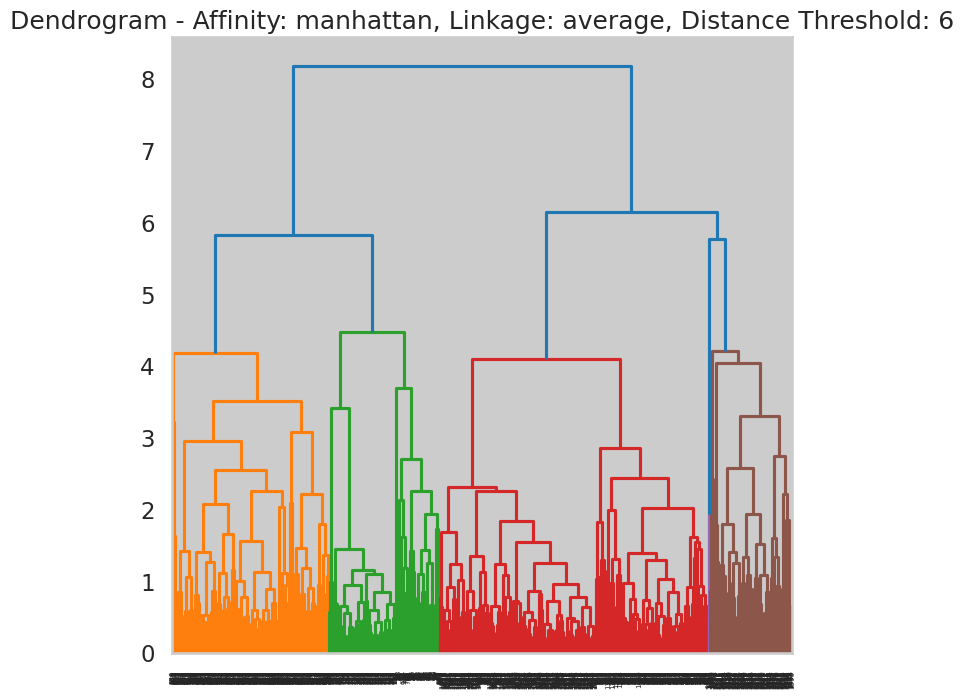

LENGTHHHHHHHHH ::::::::::::::::: 6


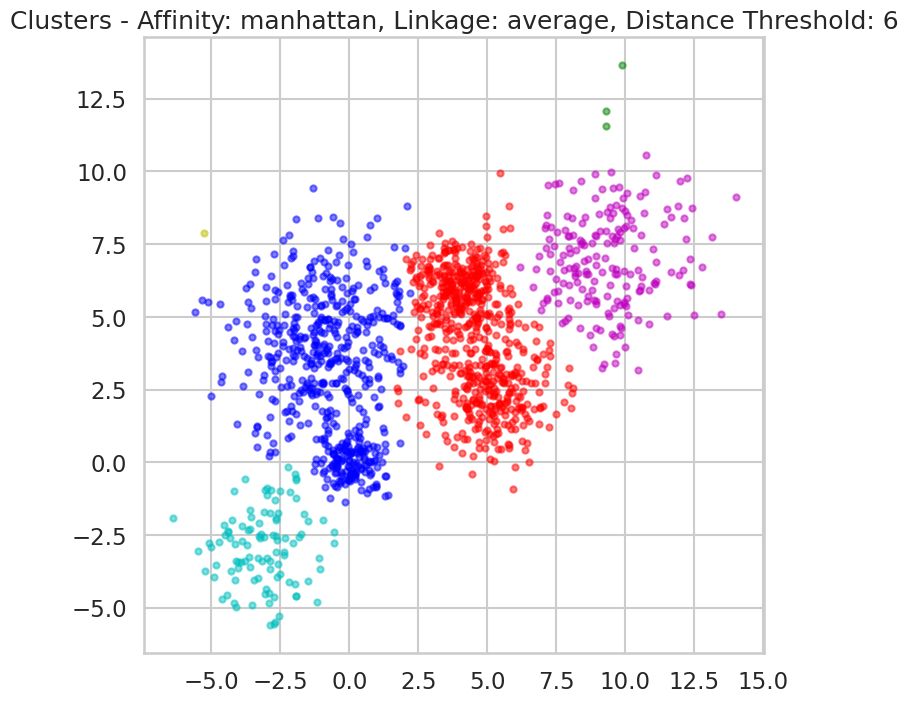

Silhouette Score - Affinity: manhattan, Linkage: average, Distance Threshold: 6: 0.38029768112070367


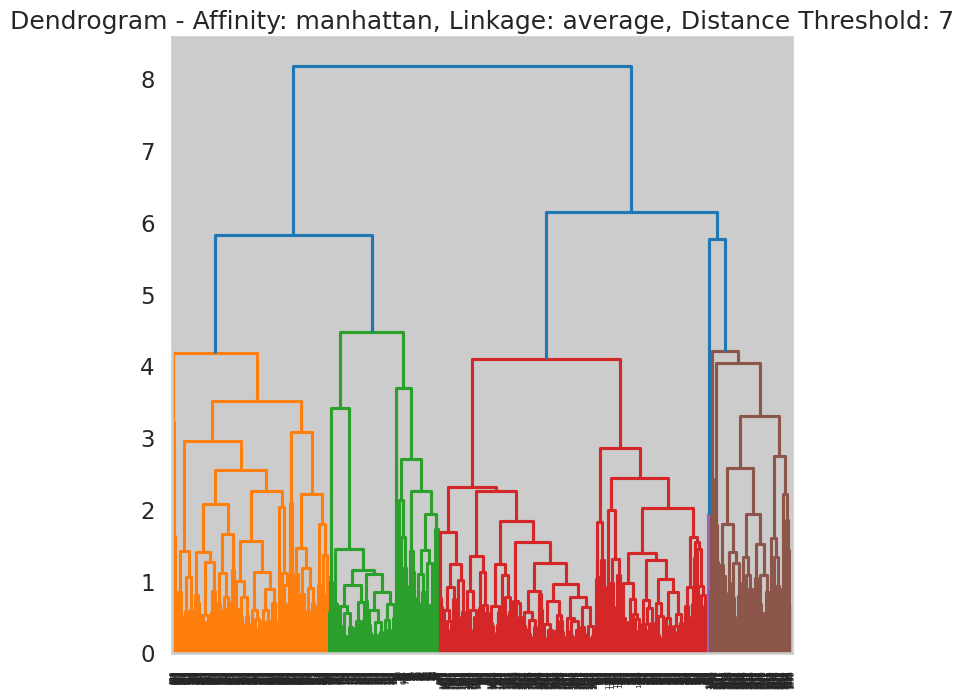

LENGTHHHHHHHHH ::::::::::::::::: 5


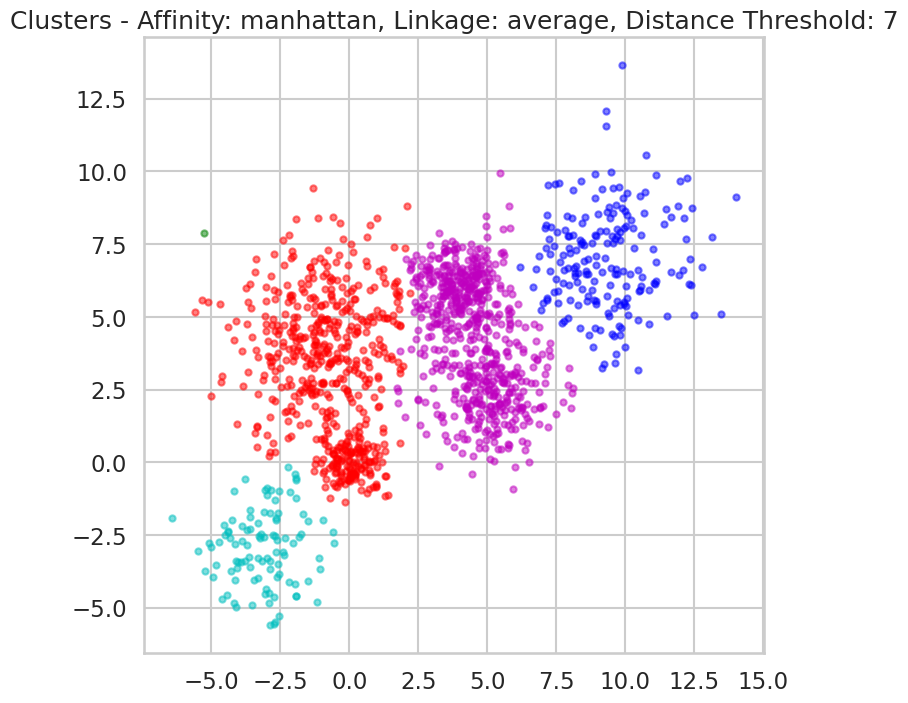

Silhouette Score - Affinity: manhattan, Linkage: average, Distance Threshold: 7: 0.39540970031359807


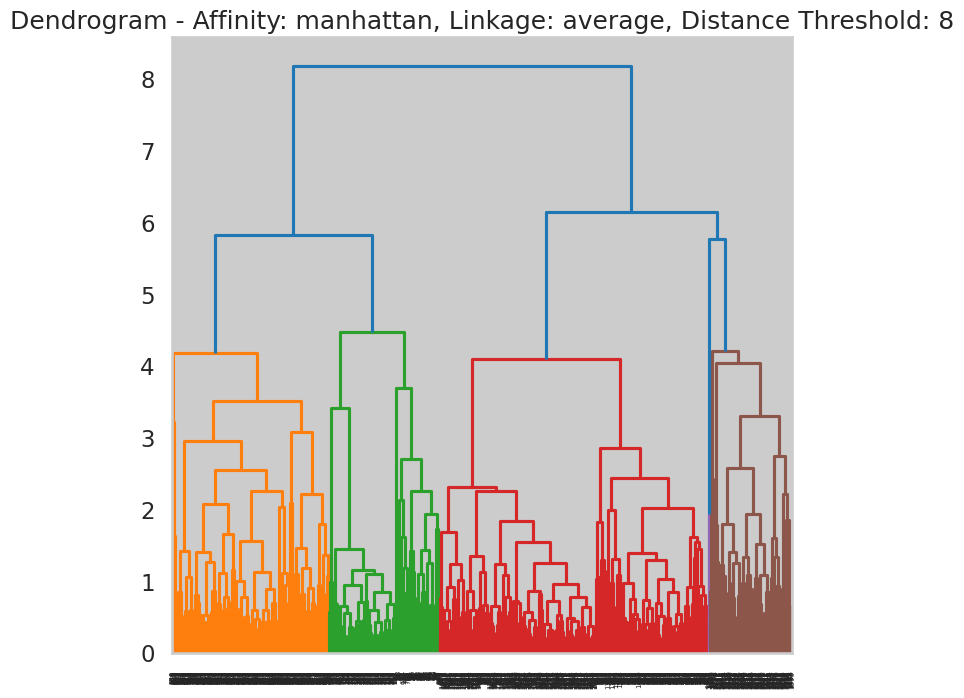

LENGTHHHHHHHHH ::::::::::::::::: 4


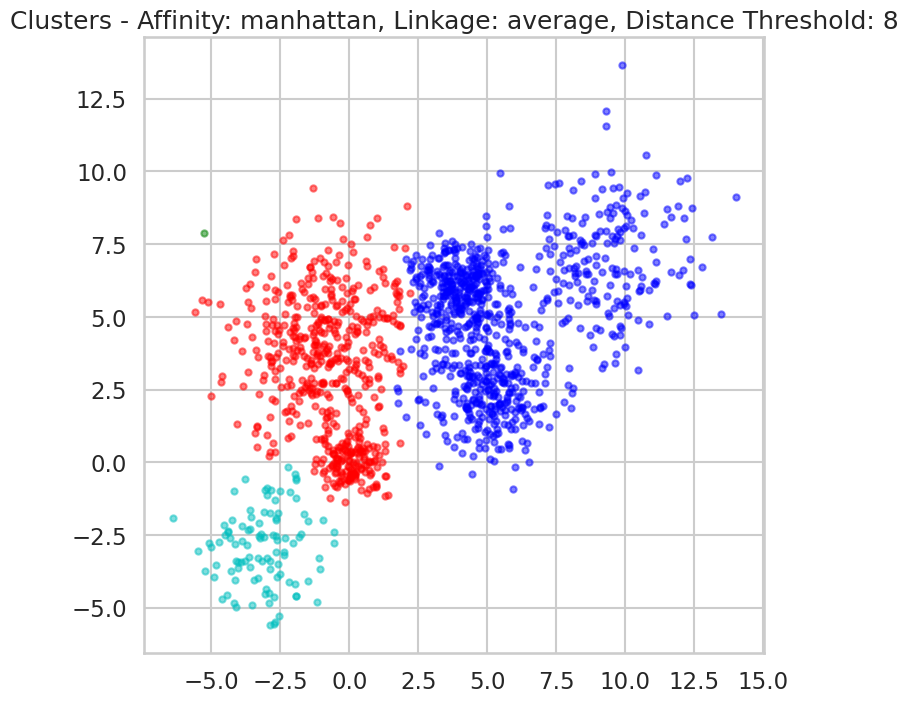

Silhouette Score - Affinity: manhattan, Linkage: average, Distance Threshold: 8: 0.38321869346484616
Only one cluster created - Affinity: manhattan, Linkage: single, Distance Threshold: 6. Skipping...
Only one cluster created - Affinity: manhattan, Linkage: single, Distance Threshold: 7. Skipping...
Only one cluster created - Affinity: manhattan, Linkage: single, Distance Threshold: 8. Skipping...
Only one cluster created - Affinity: cosine, Linkage: average, Distance Threshold: 6. Skipping...
Only one cluster created - Affinity: cosine, Linkage: average, Distance Threshold: 7. Skipping...
Only one cluster created - Affinity: cosine, Linkage: average, Distance Threshold: 8. Skipping...
Only one cluster created - Affinity: cosine, Linkage: single, Distance Threshold: 6. Skipping...
Only one cluster created - Affinity: cosine, Linkage: single, Distance Threshold: 7. Skipping...
Only one cluster created - Affinity: cosine, Linkage: single, Distance Threshold: 8. Skipping...

Best paramete

In [ ]:
from scipy.cluster.hierarchy import dendrogram
from sklearn.cluster import AgglomerativeClustering
import seaborn as sns
from scipy.cluster.hierarchy import dendrogram, linkage
import scipy


# Helper function to display clusters
def display_cluster(X, labels):
    color = ['b', 'r', 'g', 'c', 'm', 'y', 'k', 'violet', 'aqua', 'pink', 'violet','grey', 'coral', 'brown']  # List of colors
    alpha = 0.5  # Color opacity
    s = 20
    print('LENGTHHHHHHHHH :::::::::::::::::',len(np.unique(labels)))
    for i in range(len(np.unique(labels))):
        plt.scatter(X[labels == i, 0], X[labels == i, 1], c=colors[i], alpha=alpha, s=s)



# Define parameter values to try
affinities = ['euclidean', 'manhattan', 'cosine']
linkages = ['average', 'single']
distance_thresholds = [6, 7, 8]

best_score = -1
best_params = {}

# Iterate over different parameter combinations
for affinity in affinities:
    for linkage in linkages:
        for distance_threshold in distance_thresholds:
            n_clusters = None
            model = AgglomerativeClustering(n_clusters=n_clusters, affinity=affinity, linkage=linkage, distance_threshold=distance_threshold)
            labels = model.fit_predict(Multi_blob_Data)
            if len(np.unique(labels)) > 1:
                score = silhouette_score(Multi_blob_Data, labels)

                # Display dendrogram
                Z = scipy.cluster.hierarchy.linkage(Multi_blob_Data, method=linkage)
                plt.figure()
                plt.title(f'Dendrogram - Affinity: {affinity}, Linkage: {linkage}, Distance Threshold: {distance_threshold}')
                dendrogram(Z)
                plt.show()

                # Display resulting clusters
                plt.figure()
                plt.title(f'Clusters - Affinity: {affinity}, Linkage: {linkage}, Distance Threshold: {distance_threshold}')
                display_cluster(Multi_blob_Data, labels)
                plt.show()

                print(f'Silhouette Score - Affinity: {affinity}, Linkage: {linkage}, Distance Threshold: {distance_threshold}: {score}')

                # Update best score and parameters if current score is better
                if score > best_score:
                    best_score = score
                    best_params['affinity'] = affinity
                    best_params['linkage'] = linkage
                    best_params['distance_threshold'] = distance_threshold
            else:
                print(f'Only one cluster created - Affinity: {affinity}, Linkage: {linkage}, Distance Threshold: {distance_threshold}. Skipping...')
                # best_params['distance_threshold'] = distance_threshold

# Print best parameters and score
print("\nBest parameters:", best_params)
print("Best silhouette score:", best_score)


In [ ]:
colors = [
    'b', 'r', 'g', 'c', 'm', 'y', 'k', 'violet', 'aqua', 'pink', 'violet','grey', 'coral', 'brown',"aliceblue", "antiquewhite", "aqua", "aquamarine", "azure",
    "beige", "bisque", "black", "blanchedalmond", "blue",
    "blueviolet", "brown", "burlywood", "cadetblue", "chartreuse",
    "chocolate", "coral", "cornflowerblue", "cornsilk", "crimson",
    "cyan", "darkblue", "darkcyan", "darkgoldenrod", "darkgray",
    "darkgreen", "darkgrey", "darkkhaki", "darkmagenta", "darkolivegreen",
    "darkorange", "darkorchid", "darkred", "darksalmon", "darkseagreen",
    "darkslateblue", "darkslategray", "darkslategrey", "darkturquoise",
    "darkviolet", "deeppink", "deepskyblue", "dimgray", "dimgrey",
    "dodgerblue", "firebrick", "floralwhite", "forestgreen", "fuchsia",
    "gainsboro", "ghostwhite", "gold", "goldenrod", "gray",
    "green", "greenyellow", "grey", "honeydew", "hotpink",
    "indianred", "indigo", "ivory", "khaki", "lavender",
    "lavenderblush", "lawngreen", "lemonchiffon", "lightblue", "lightcoral",
    "lightcyan", "lightgoldenrodyellow", "lightgray", "lightgreen", "lightgrey",
    "lightpink", "lightsalmon", "lightseagreen", "lightskyblue", "lightslategray",
    "lightslategrey", "lightsteelblue", "lightyellow", "lime", "limegreen",
    "linen", "magenta", "maroon", "mediumaquamarine", "mediumblue",
    "mediumorchid", "mediumpurple", "mediumseagreen", "mediumslateblue", "mediumspringgreen",
    "mediumturquoise", "mediumvioletred", "midnightblue", "mintcream", "mistyrose",
    "moccasin", "navajowhite", "navy", "oldlace", "olive",
    "olivedrab", "orange", "orangered", "orchid", "palegoldenrod",
    "palegreen", "paleturquoise", "palevioletred", "papayawhip", "peachpuff",
    "peru", "pink", "plum", "powderblue", "purple", "red",'b', 'r', 'g', 'c', 'm', 'y', 'k', 'violet', 'aqua', 'pink', 'violet','grey', 'coral', 'brown',"aliceblue", "antiquewhite", "aqua", "aquamarine", "azure",
    "beige", "bisque", "black", "blanchedalmond", "blue",
    "blueviolet", "brown", "burlywood", "cadetblue", "chartreuse",
    "chocolate", "coral", "cornflowerblue", "cornsilk", "crimson",
    "cyan", "darkblue", "darkcyan", "darkgoldenrod", "darkgray",
    "darkgreen", "darkgrey", "darkkhaki", "darkmagenta", "darkolivegreen",
    "darkorange", "darkorchid", "darkred", "darksalmon", "darkseagreen",
    "darkslateblue", "darkslategray", "darkslategrey", "darkturquoise",
    "darkviolet", "deeppink", "deepskyblue", "dimgray", "dimgrey",
    "dodgerblue", "firebrick", "floralwhite", "forestgreen", "fuchsia",
    "gainsboro", "ghostwhite", "gold", "goldenrod", "gray",
    "green", "greenyellow", "grey", "honeydew", "hotpink",
    "indianred", "indigo", "ivory", "khaki", "lavender",
    "lavenderblush", "lawngreen", "lemonchiffon", "lightblue", "lightcoral",
    "lightcyan", "lightgoldenrodyellow", "lightgray", "lightgreen", "lightgrey",
    "lightpink", "lightsalmon", "lightseagreen", "lightskyblue", "lightslategray",
    "lightslategrey", "lightsteelblue", "lightyellow", "lime", "limegreen",
    "linen", "magenta", "maroon", "mediumaquamarine", "mediumblue",
    "mediumorchid", "mediumpurple", "mediumseagreen", "mediumslateblue", "mediumspringgreen",
    "mediumturquoise", "mediumvioletred", "midnightblue", "mintcream", "mistyrose",
    "moccasin", "navajowhite", "navy", "oldlace", "olive",
    "olivedrab", "orange", "orangered", "orchid", "palegoldenrod",
    "palegreen", "paleturquoise", "palevioletred", "papayawhip", "peachpuff",
    "peru", "pink", "plum", "powderblue", "purple", "red"
]


### DBScan
* Use DBScan function to  to cluster the above data
* In the  DBscan change the following parameters
    * EPS (from 0.1 to 3)
    * Min_samples (from 5 to 25)
* Plot the silhouette_score versus the variation in the EPS and the min_samples
* Plot the resulting Clusters in this case
* Find the set of paramters that would find result in the best silhouette_score and store this score for later comparison with other clustering techniques.
* Record your observations and comments

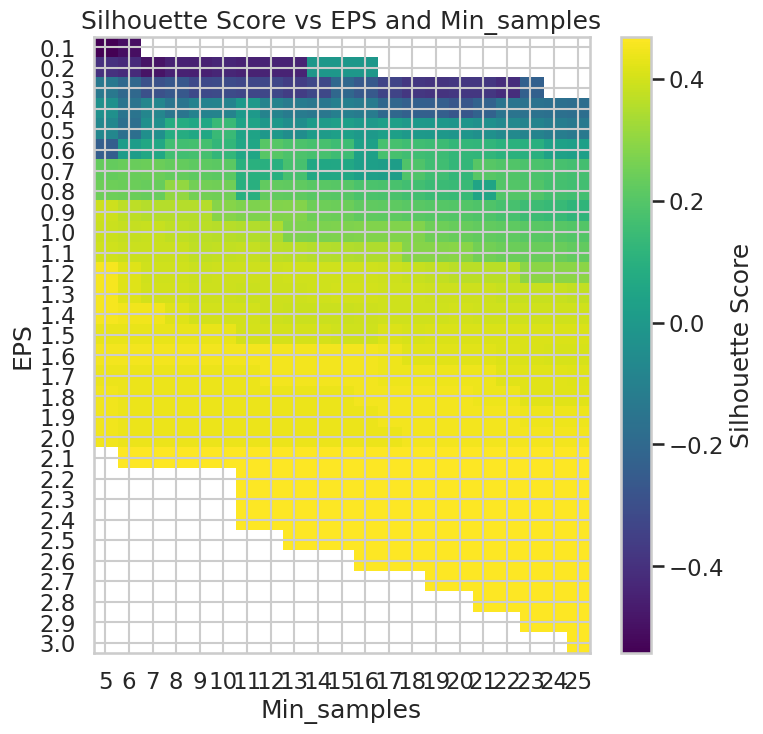


Best parameters: {'EPS': 2.0999999999999996, 'Min_samples': 6}
Best silhouette score: 0.4685207355522043


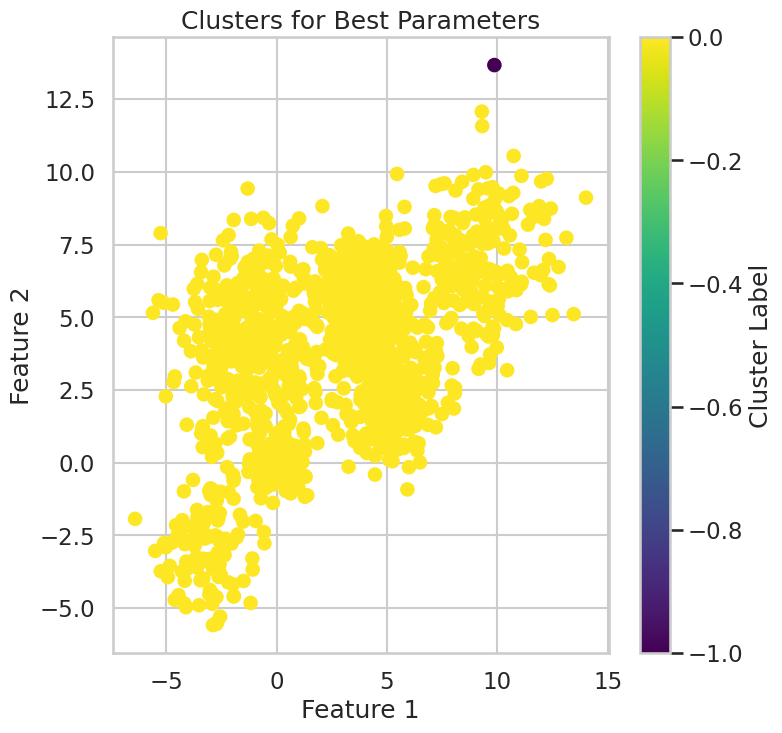

In [ ]:
# Define parameter values to try
EPS_values = np.linspace(0.1, 3, 30)
Min_samples_values = np.arange(5, 26)

best_score = -1
best_params = {}

# Iterate over different parameter combinations
for EPS in EPS_values:
    for Min_samples in Min_samples_values:
        model = DBSCAN(eps=EPS, min_samples=Min_samples)
        labels = model.fit_predict(Multi_blob_Data)

        # Exclude outliers (-1) from silhouette score calculation
        if len(np.unique(labels)) > 1:
            score = silhouette_score(Multi_blob_Data, labels)
            # Update best score and parameters if current score is better
            if score > best_score:
                best_score = score
                best_params['EPS'] = EPS
                best_params['Min_samples'] = Min_samples

# Plot silhouette score versus EPS and Min_samples
scores = np.zeros((len(EPS_values), len(Min_samples_values)))
for i, EPS in enumerate(EPS_values):
    for j, Min_samples in enumerate(Min_samples_values):
        model = DBSCAN(eps=EPS, min_samples=Min_samples)
        labels = model.fit_predict(Multi_blob_Data)
        if len(np.unique(labels)) > 1:
            scores[i, j] = silhouette_score(Multi_blob_Data, labels)
        else:
            scores[i, j] = np.nan

plt.figure()
plt.imshow(scores, interpolation='nearest', cmap='viridis', aspect='auto')
plt.colorbar(label='Silhouette Score')
plt.xticks(np.arange(len(Min_samples_values)), Min_samples_values)
plt.xlabel('Min_samples')
plt.yticks(np.arange(len(EPS_values)), np.round(EPS_values, 2))
plt.ylabel('EPS')
plt.title('Silhouette Score vs EPS and Min_samples')
plt.show()

# Print best parameters and score
model = DBSCAN(eps=best_params['EPS'], min_samples=best_params['Min_samples'])
best_labels = model.fit_predict(Multi_blob_Data)
print("\nBest parameters:", best_params)
print("Best silhouette score:", best_score)
plt.figure()
plt.scatter(Multi_blob_Data[:, 0], Multi_blob_Data[:, 1], c=best_labels, cmap='viridis')
plt.title('Clusters for Best Parameters')
plt.xlabel('Feature 1')
plt.ylabel('Feature 2')
plt.colorbar(label='Cluster Label')
plt.show()

### Gaussian Mixture
* Use GaussianMixture function to cluster the above data
* In GMM change the covariance_type and check the difference in the resulting proabability fit
* Use a 2D contour plot to plot the resulting distribution (the components of the GMM) as well as the total Gaussian mixture

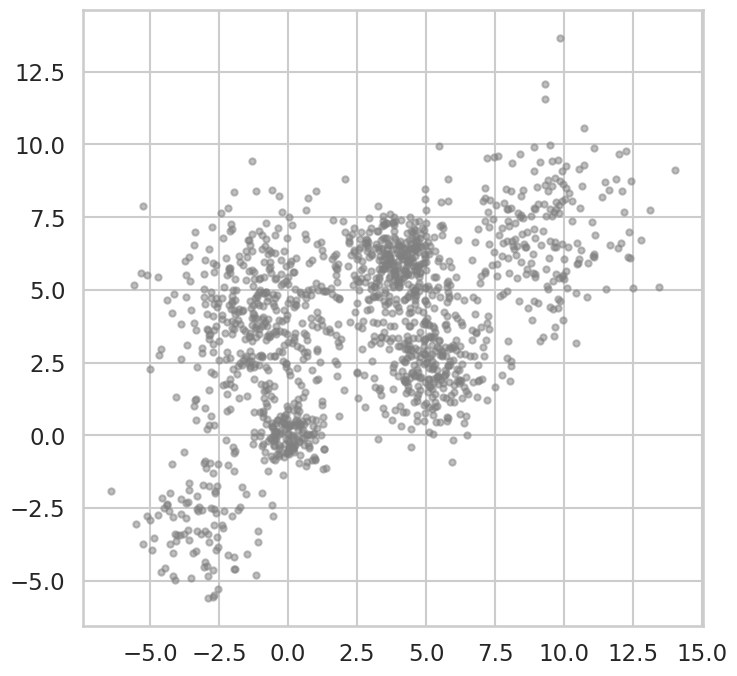

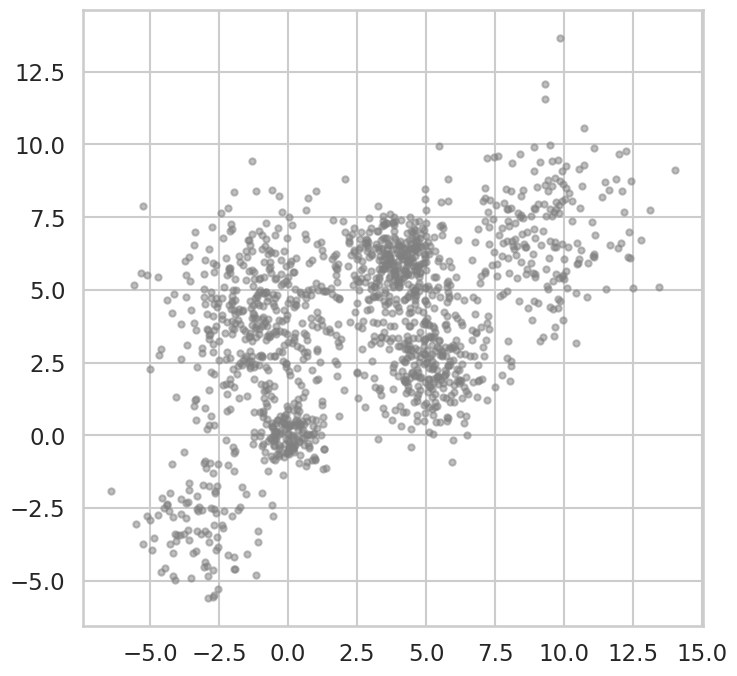

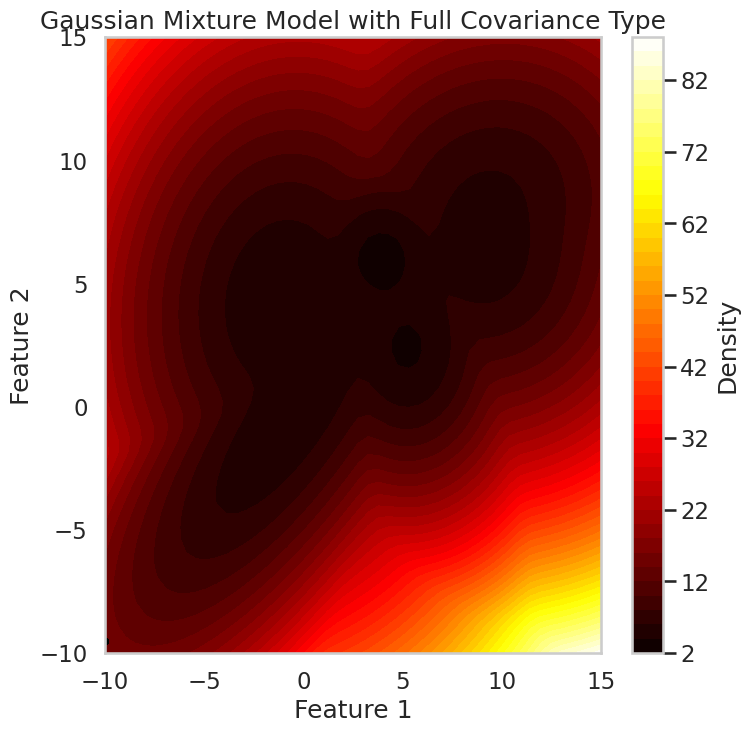

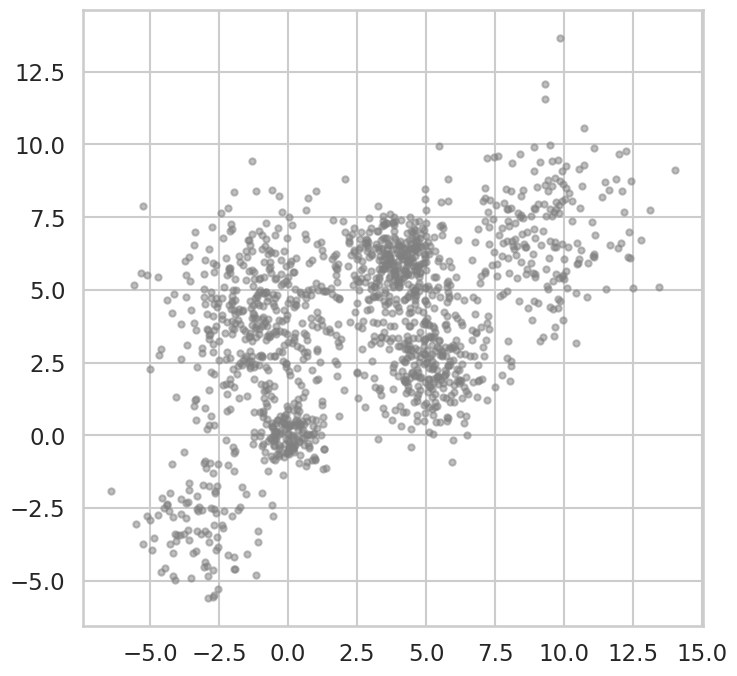

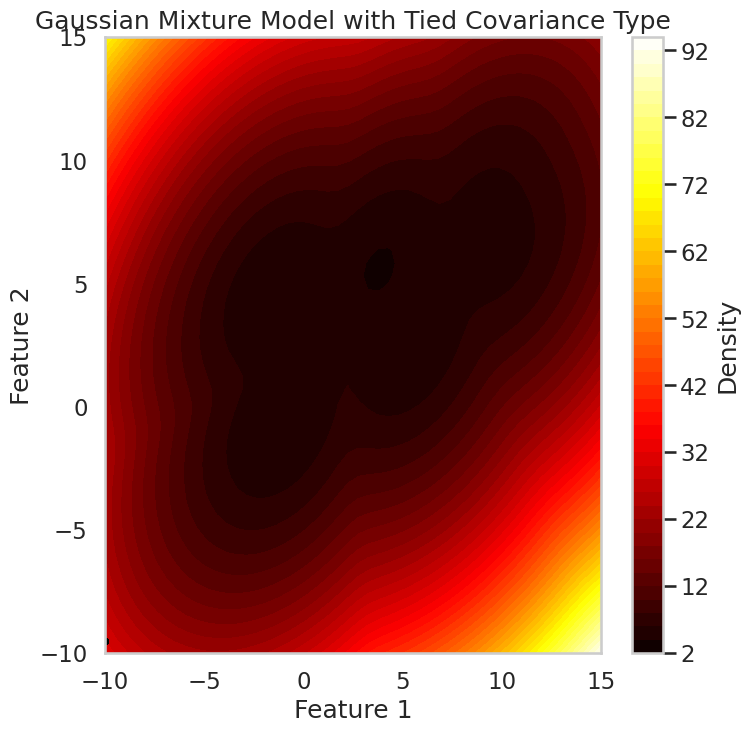

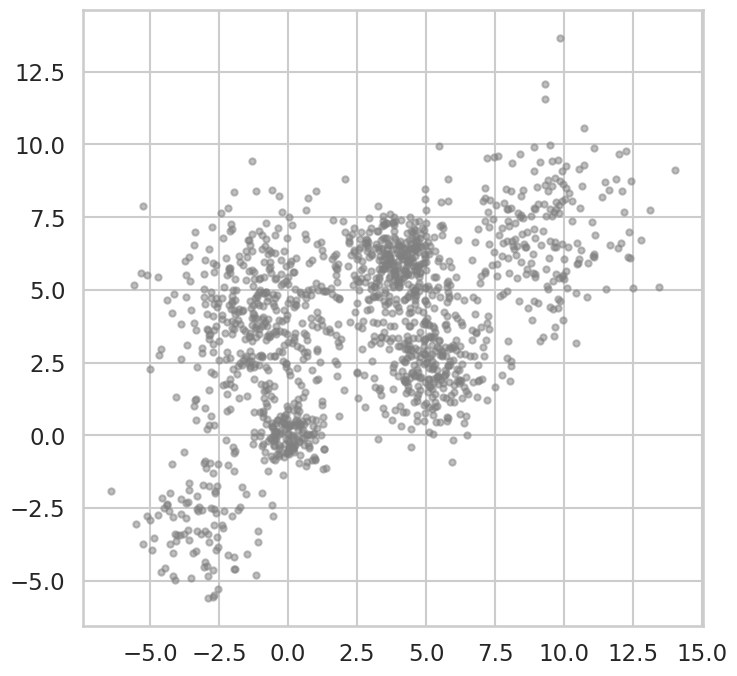

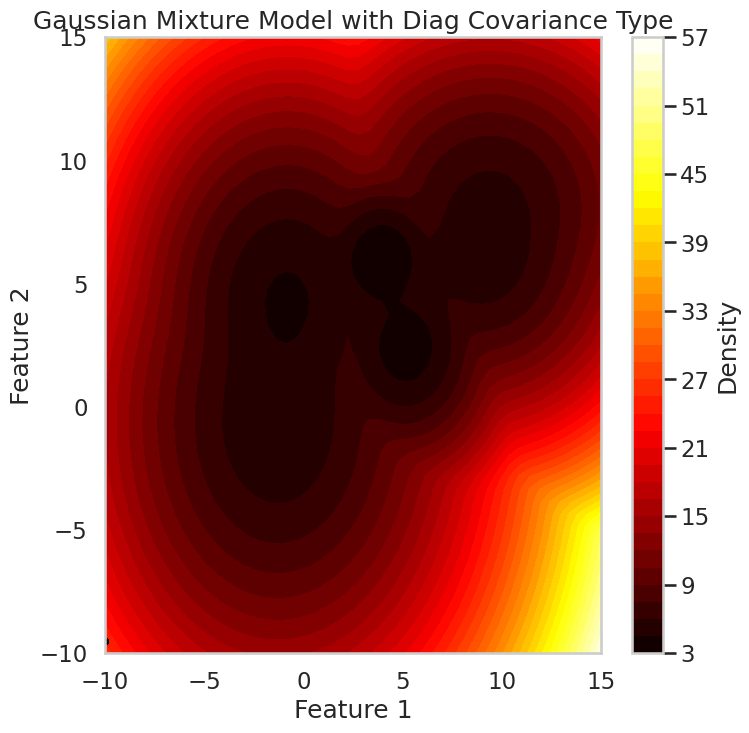

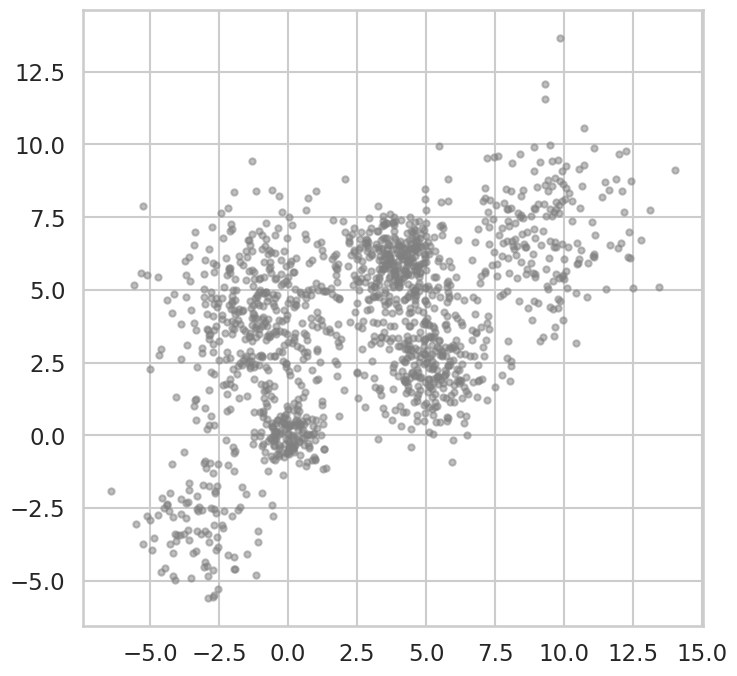

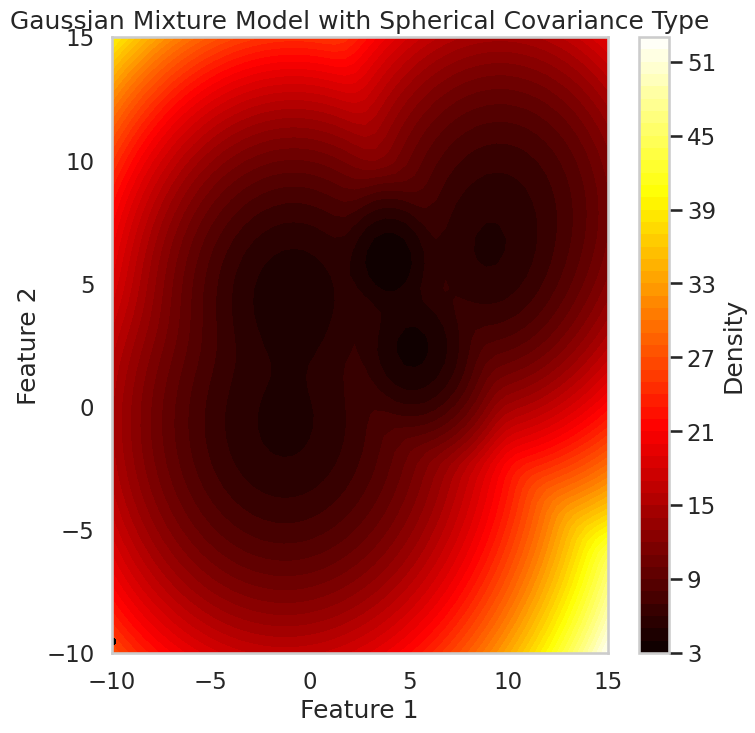

In [ ]:
# Define covariance types to try
covariance_types = ['full', 'tied', 'diag', 'spherical']

# Fit Gaussian mixture models with different covariance types
plt.figure()
plt.scatter(Multi_blob_Data[:, 0], Multi_blob_Data[:, 1], marker='.', color='gray', alpha=0.5, label='Data')

for cov_type in covariance_types:
    plt.figure()
    plt.scatter(Multi_blob_Data[:, 0], Multi_blob_Data[:, 1], marker='.', color='gray', alpha=0.5, label='Data')
    gmm = GaussianMixture(n_components=6, covariance_type=cov_type, random_state=42)
    gmm.fit(Multi_blob_Data)
    x = np.linspace(-10., 15.)
    y = np.linspace(-10., 15.)
    X, Y = np.meshgrid(x, y)
    XX = np.array([X.ravel(), Y.ravel()]).T
    Z = -gmm.score_samples(XX)
    Z = Z.reshape(X.shape)
    # CS = plt.contour(X, Y, Z, levels=10, linewidths=1, alpha=0.5, label=cov_type)
    # plt.colorbar(CS, shrink=0.8, extend='both')
    # string = 'Gaussian Mixture Models with '
    # string += str(cov_type)
    # plt.title(str(string))
    # plt.xlabel('X')
    # plt.ylabel('Y')
    # plt.legend()
    plt.figure()
    plt.contourf(X, Y, Z, cmap='hot', levels=50)  # 'hot' colormap for heatmap-like colors
    plt.colorbar(label='Density')
    plt.xlim(X.min(), X.max())
    plt.ylim(Y.min(), Y.max())
    plt.scatter(X[:, 0], X[:, 1], s=10, color='black')  # Scatter plot of the data points
    plt.title(f'Gaussian Mixture Model with {cov_type.capitalize()} Covariance Type')
    plt.xlabel('Feature 1')
    plt.ylabel('Feature 2')
    plt.show()

plt.show()


Best covariance type: full
Best log-likelihood score: -4.960814094046011


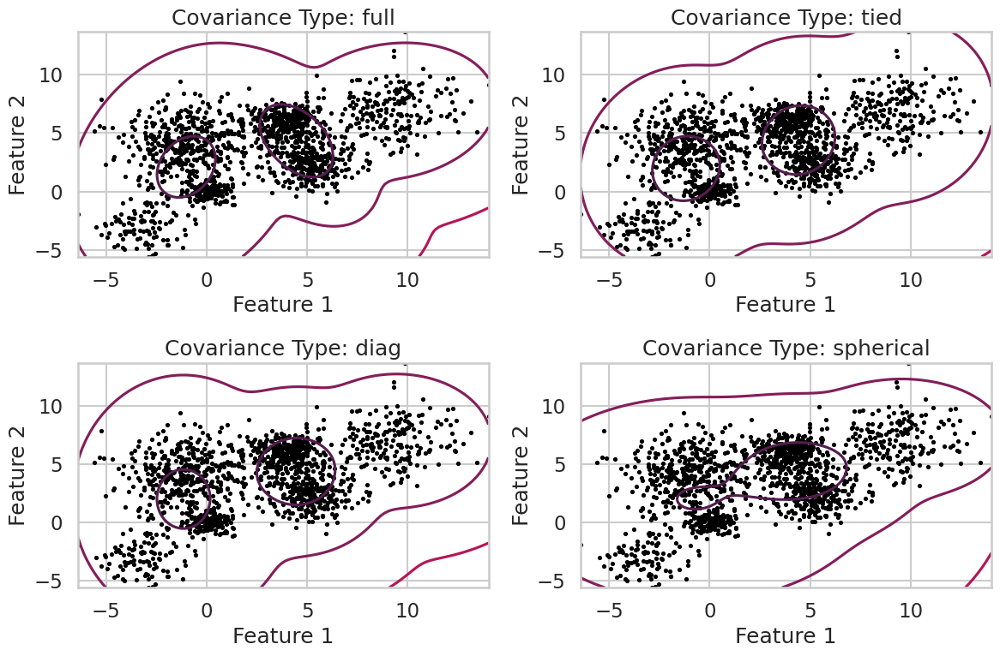

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.mixture import GaussianMixture
from matplotlib.colors import LogNorm

# Assuming Multi_blob_Data is your data array

# Define covariance types to try
covariance_types = ['full', 'tied', 'diag', 'spherical']

best_score = -np.inf
best_params = {}

# Iterate over different covariance types
for cov_type in covariance_types:
    model = GaussianMixture(n_components=3, covariance_type=cov_type, random_state=0)
    model.fit(Multi_blob_Data)
    score = model.score(Multi_blob_Data)

    # Update best score and parameters if current score is better
    if score > best_score:
        best_score = score
        best_params['covariance_type'] = cov_type

# Print best covariance type and score
print("\nBest covariance type:", best_params['covariance_type'])
print("Best log-likelihood score:", best_score)

# Plot resulting distribution with contour plots
x = np.linspace(np.min(Multi_blob_Data[:, 0]), np.max(Multi_blob_Data[:, 0]), 100)
y = np.linspace(np.min(Multi_blob_Data[:, 1]), np.max(Multi_blob_Data[:, 1]), 100)
X, Y = np.meshgrid(x, y)
XX = np.array([X.ravel(), Y.ravel()]).T

plt.figure(figsize=(12, 8))

for i, cov_type in enumerate(covariance_types):
    model = GaussianMixture(n_components=3, covariance_type=cov_type, random_state=0)
    model.fit(Multi_blob_Data)
    Z = -model.score_samples(XX)
    Z = Z.reshape(X.shape)

    plt.subplot(2, 2, i + 1)
    plt.scatter(Multi_blob_Data[:, 0], Multi_blob_Data[:, 1], s=5, color='black')
    plt.contour(X, Y, Z, norm=LogNorm(vmin=1.0, vmax=1000.0), levels=np.logspace(0, 3, 10))
    plt.title('Covariance Type: {}'.format(cov_type))
    plt.xlabel('Feature 1')
    plt.ylabel('Feature 2')

plt.tight_layout()
plt.show()


## iris data set
The iris data set is test data set that is part of the Sklearn module
which contains 150 records each with 4 features. All the features are represented by real numbers

The data represents three classes


In [ ]:
from sklearn.datasets import load_iris
iris_data = load_iris()
iris_data.target[[10, 25, 50]]
#array([0, 0, 1])
list(iris_data.target_names)
['setosa', 'versicolor', 'virginica']
iris_data = iris_data.data
iris_data

array([[5.1, 3.5, 1.4, 0.2],
       [4.9, 3. , 1.4, 0.2],
       [4.7, 3.2, 1.3, 0.2],
       [4.6, 3.1, 1.5, 0.2],
       [5. , 3.6, 1.4, 0.2],
       [5.4, 3.9, 1.7, 0.4],
       [4.6, 3.4, 1.4, 0.3],
       [5. , 3.4, 1.5, 0.2],
       [4.4, 2.9, 1.4, 0.2],
       [4.9, 3.1, 1.5, 0.1],
       [5.4, 3.7, 1.5, 0.2],
       [4.8, 3.4, 1.6, 0.2],
       [4.8, 3. , 1.4, 0.1],
       [4.3, 3. , 1.1, 0.1],
       [5.8, 4. , 1.2, 0.2],
       [5.7, 4.4, 1.5, 0.4],
       [5.4, 3.9, 1.3, 0.4],
       [5.1, 3.5, 1.4, 0.3],
       [5.7, 3.8, 1.7, 0.3],
       [5.1, 3.8, 1.5, 0.3],
       [5.4, 3.4, 1.7, 0.2],
       [5.1, 3.7, 1.5, 0.4],
       [4.6, 3.6, 1. , 0.2],
       [5.1, 3.3, 1.7, 0.5],
       [4.8, 3.4, 1.9, 0.2],
       [5. , 3. , 1.6, 0.2],
       [5. , 3.4, 1.6, 0.4],
       [5.2, 3.5, 1.5, 0.2],
       [5.2, 3.4, 1.4, 0.2],
       [4.7, 3.2, 1.6, 0.2],
       [4.8, 3.1, 1.6, 0.2],
       [5.4, 3.4, 1.5, 0.4],
       [5.2, 4.1, 1.5, 0.1],
       [5.5, 4.2, 1.4, 0.2],
       [4.9, 3

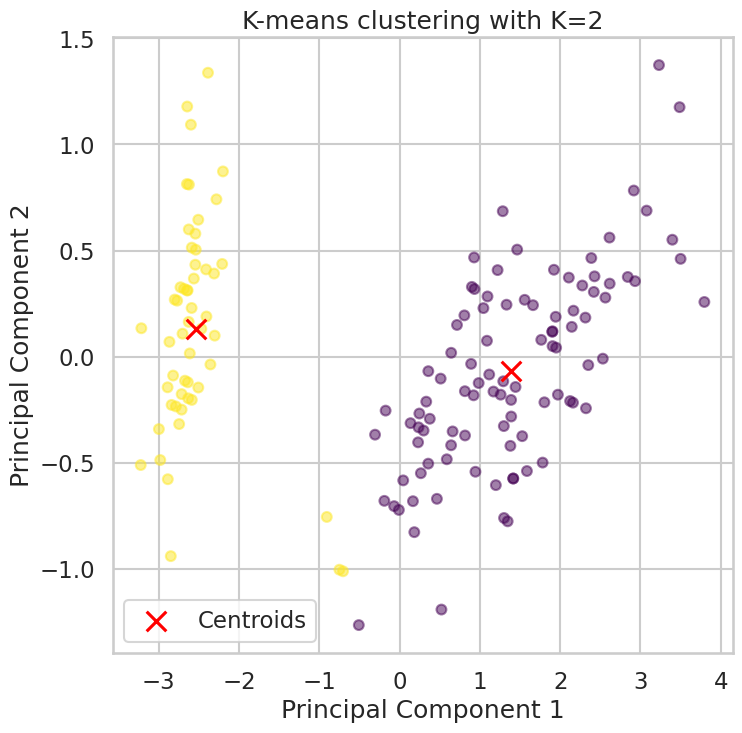

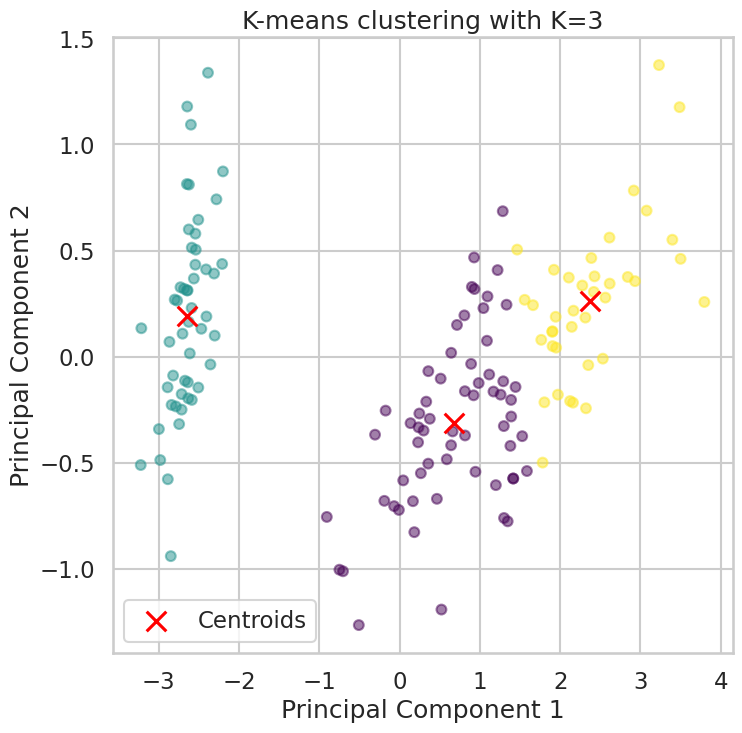

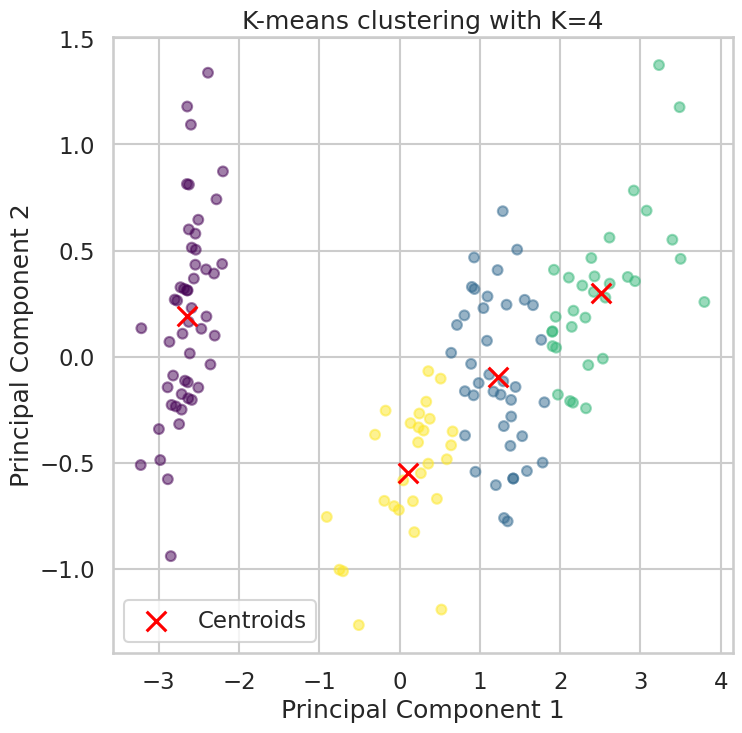

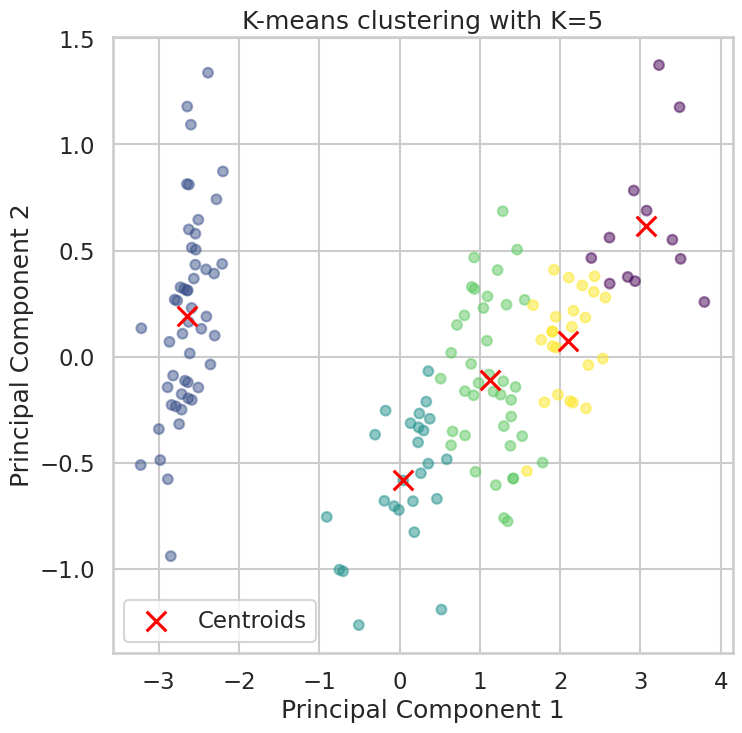

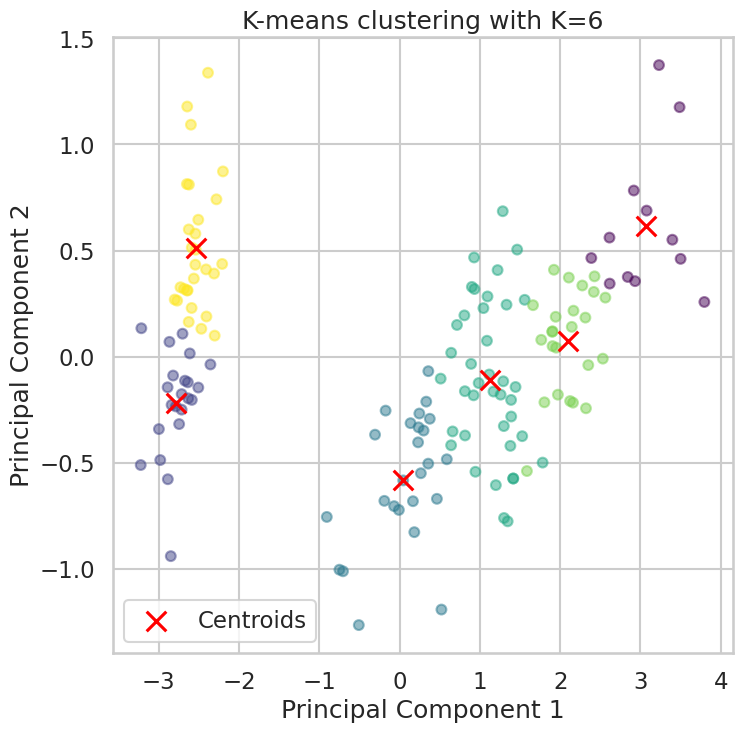

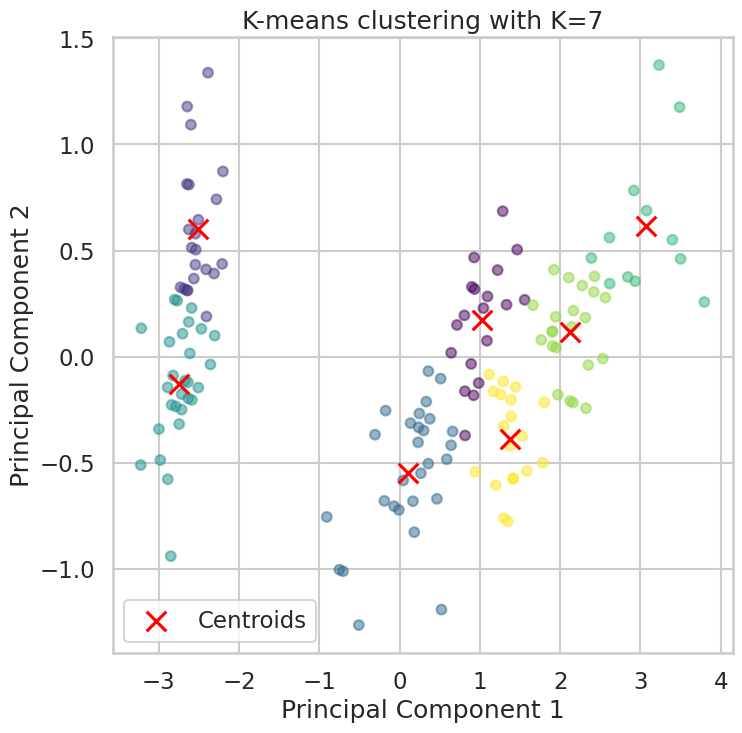

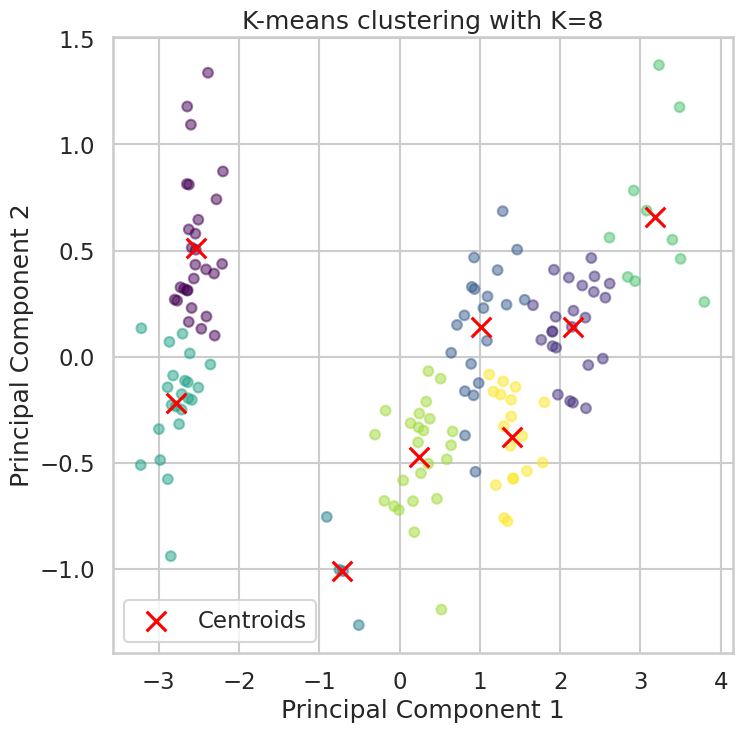

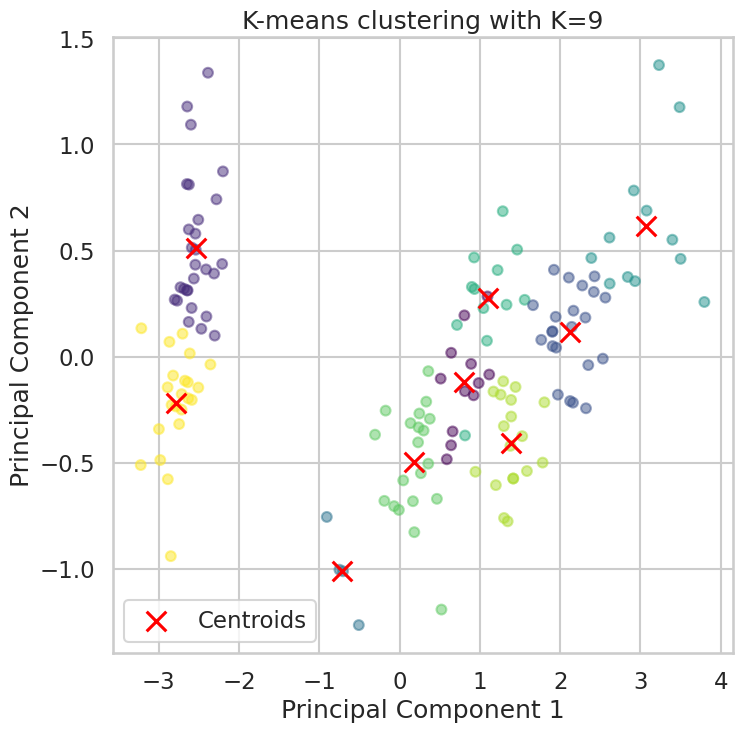

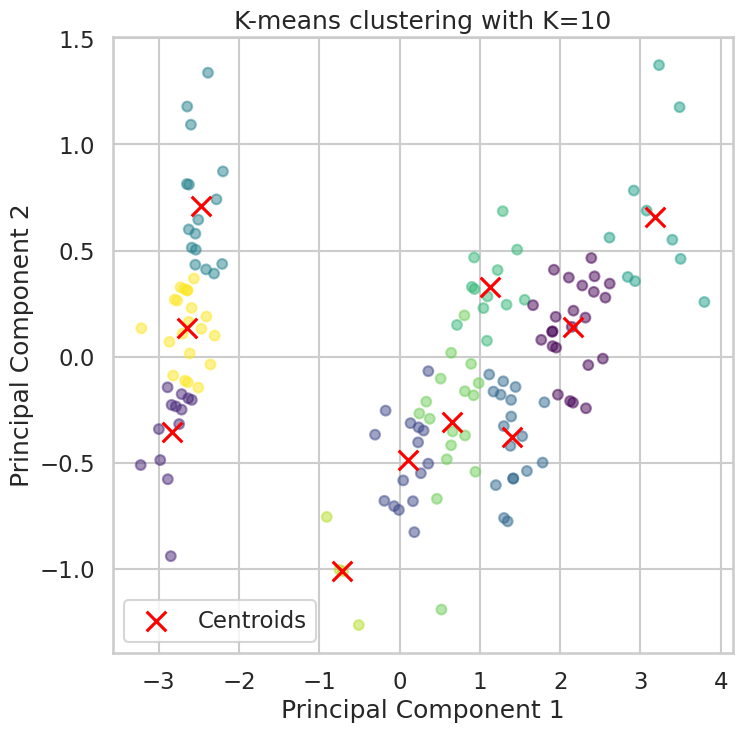

Best value of K based on silhouette score: 2
Best silhouette score: 0.6810461692117462


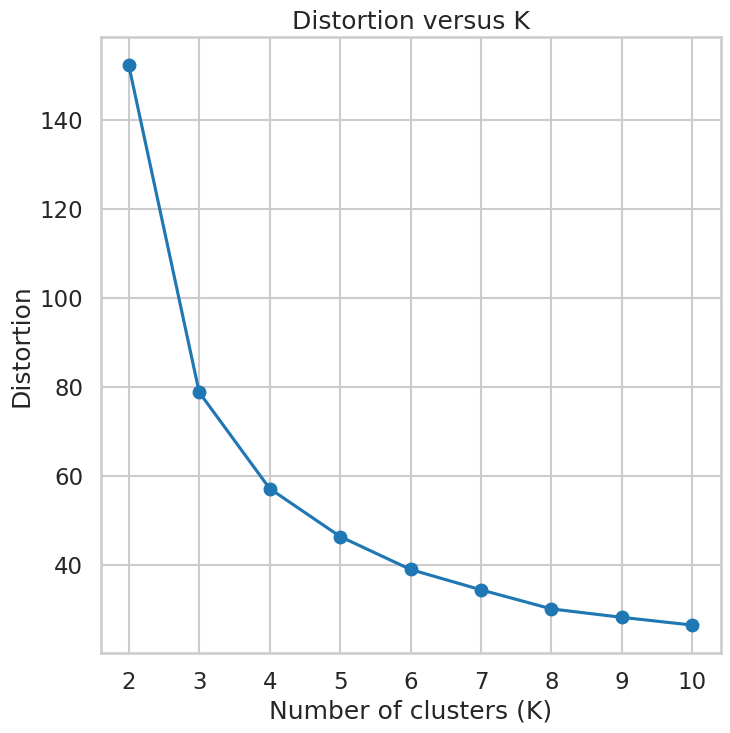

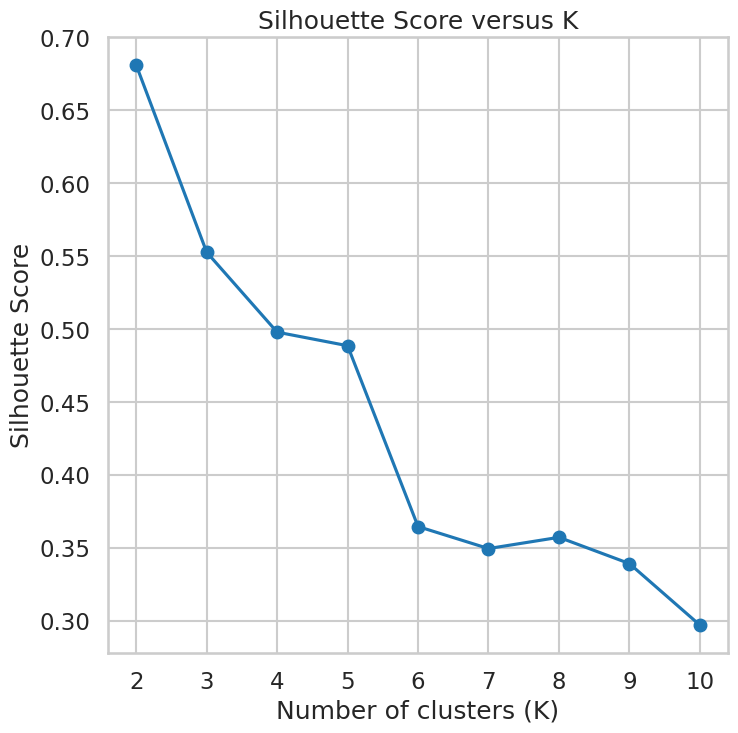

In [ ]:
from sklearn.decomposition import PCA

# Perform K-means clustering with different values of K
K_values = range(2, 11)  # Values of K to try
distortions = []  # List to store distortion values
silhouette_scores = []  # List to store silhouette scores

# Function to display clusters
def display_cluster(X, km, k):
    pca = PCA(n_components=2)
    X_pca = pca.fit_transform(X)
    centroids = pca.transform(km.cluster_centers_)
    plt.scatter(X_pca[:, 0], X_pca[:, 1], c=km.labels_, cmap='viridis', s=50, alpha=0.5)
    plt.scatter(centroids[:, 0], centroids[:, 1], c='red', marker='x', s=200, label='Centroids')
    plt.xlabel('Principal Component 1')
    plt.ylabel('Principal Component 2')
    plt.title('K-means clustering with K={}'.format(k))
    plt.legend()
    plt.show()

for k in K_values:
    km = KMeans(n_clusters=k, random_state=42)
    km.fit(iris_data)
    distortions.append(km.inertia_)  # Sum of squared distances to closest cluster center
    silhouette_scores.append(silhouette_score(iris_data, km.labels_))  # Silhouette score

    # Display clusters for each value of K
    plt.figure()
    plt.title("K-means clustering with K={}".format(k))
    display_cluster(iris_data, km, k)

# Plot distortion function versus K
plt.figure()
plt.plot(K_values, distortions, marker='o')
plt.xlabel('Number of clusters (K)')
plt.ylabel('Distortion')
plt.title('Distortion versus K')

# Plot silhouette score versus K
plt.figure()
plt.plot(K_values, silhouette_scores, marker='o')
plt.xlabel('Number of clusters (K)')
plt.ylabel('Silhouette Score')
plt.title('Silhouette Score versus K')

# Find the best value of K based on silhouette score
best_K = K_values[np.argmax(silhouette_scores)]
print("Best value of K based on silhouette score:", best_K)
print("Best silhouette score:", np.max(silhouette_scores))
plt.show()

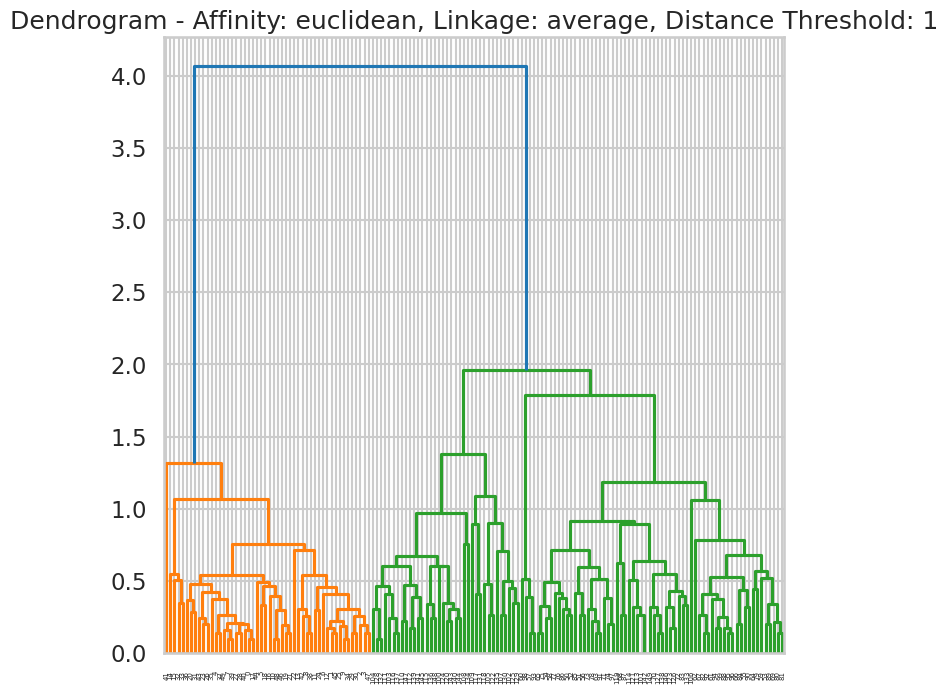

LENGTHHHHHHHHH ::::::::::::::::: 10


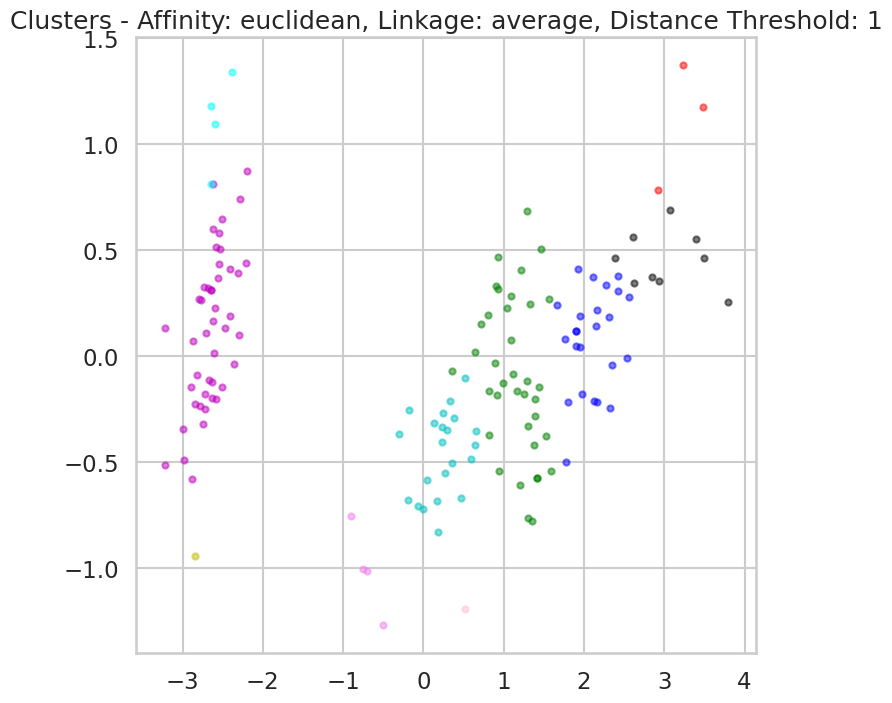

Silhouette Score - Affinity: euclidean, Linkage: average, Distance Threshold: 1: 0.30828513418773884


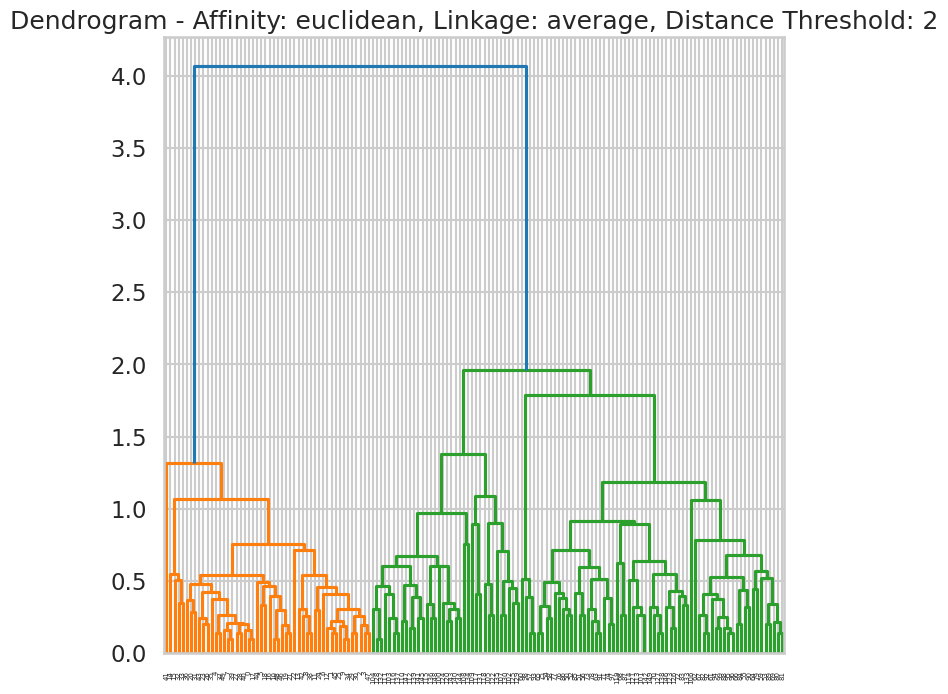

LENGTHHHHHHHHH ::::::::::::::::: 2


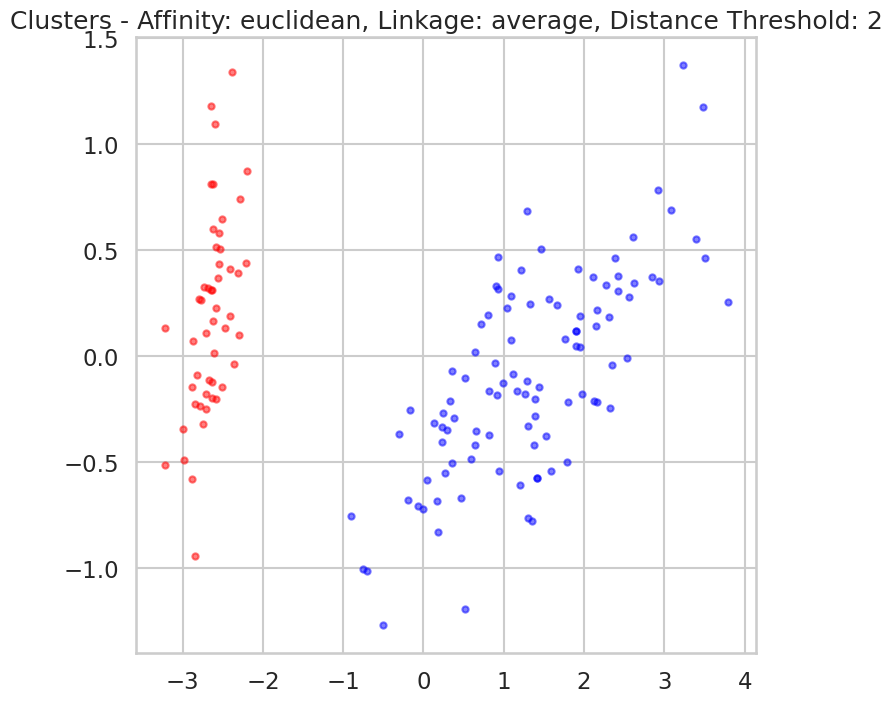

Silhouette Score - Affinity: euclidean, Linkage: average, Distance Threshold: 2: 0.6867350732769777


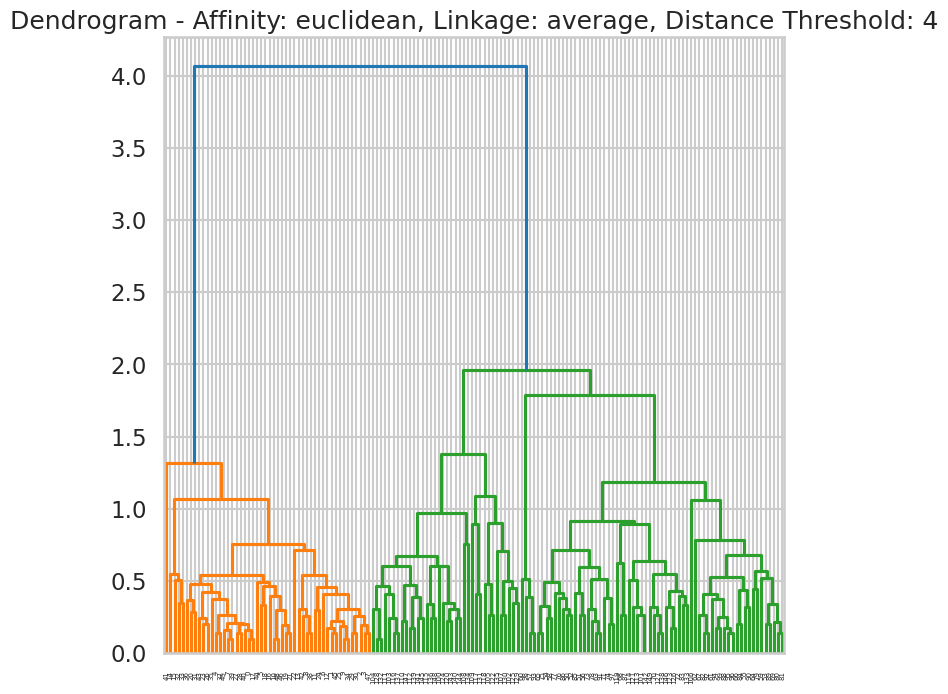

LENGTHHHHHHHHH ::::::::::::::::: 2


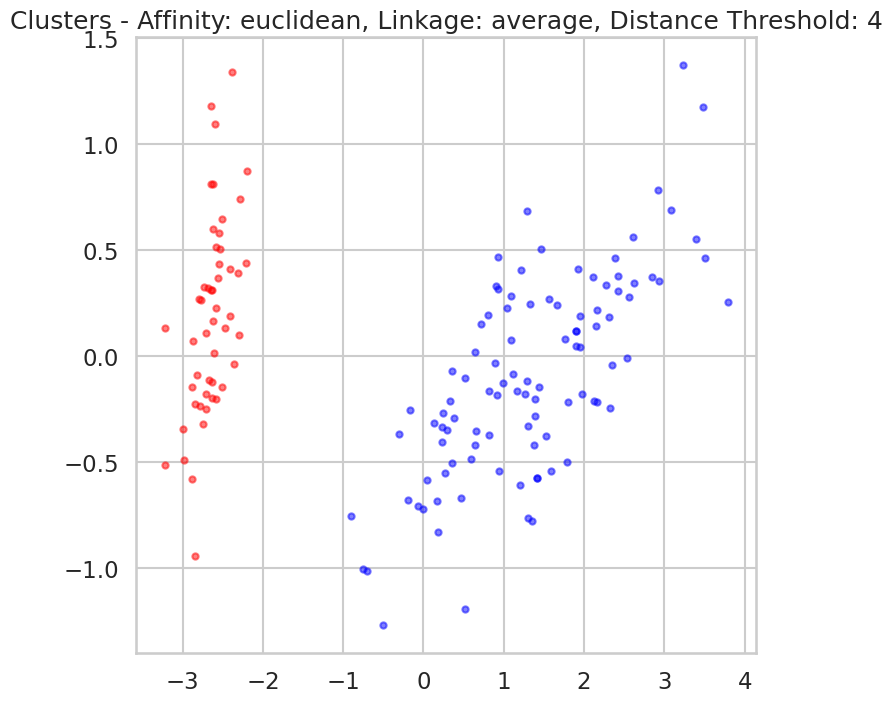

Silhouette Score - Affinity: euclidean, Linkage: average, Distance Threshold: 4: 0.6867350732769777


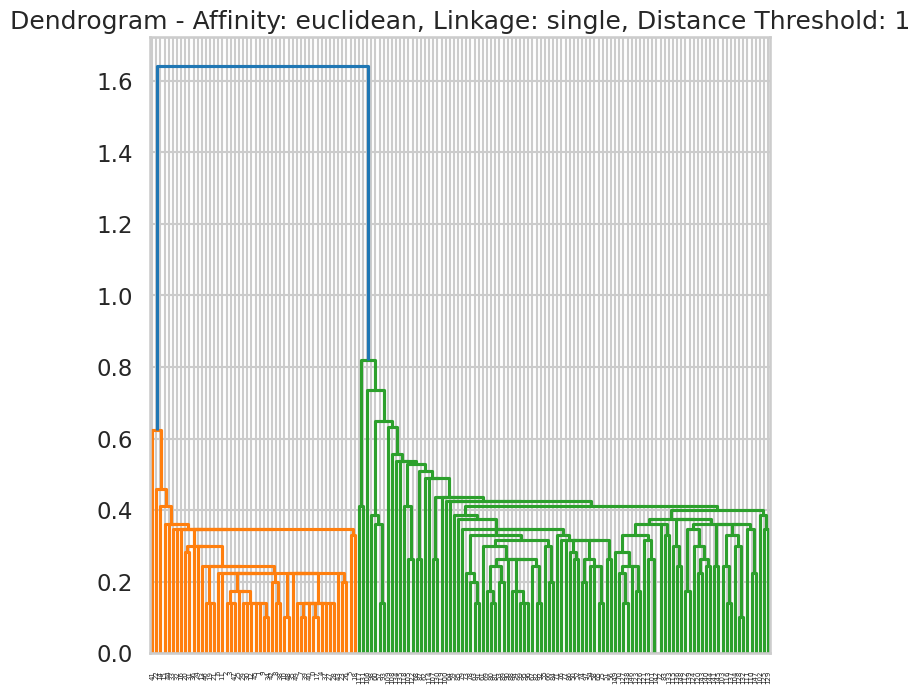

LENGTHHHHHHHHH ::::::::::::::::: 2


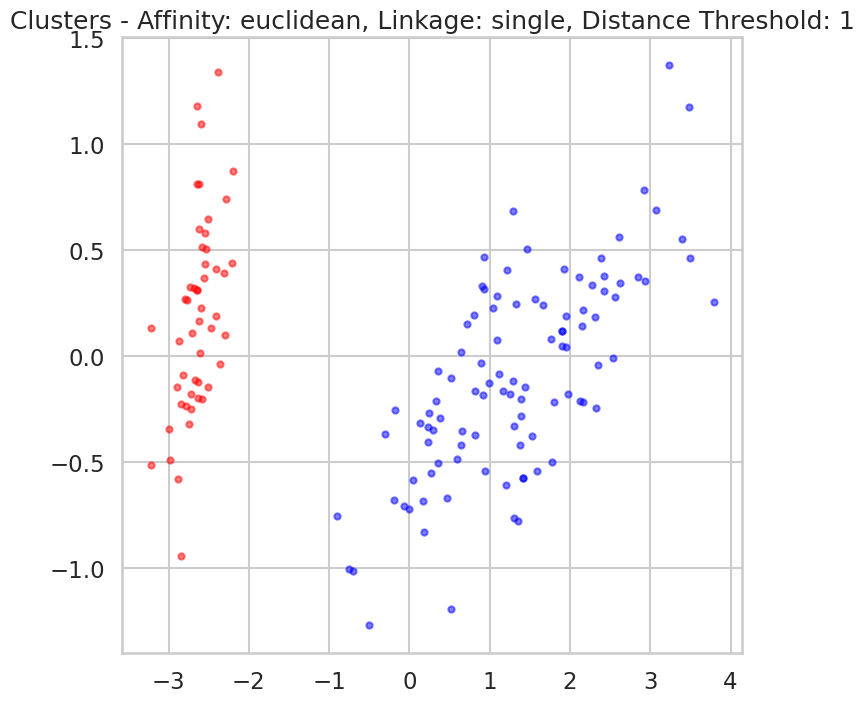

Silhouette Score - Affinity: euclidean, Linkage: single, Distance Threshold: 1: 0.6867350732769777
Only one cluster created - Affinity: euclidean, Linkage: single, Distance Threshold: 2. Skipping...
Only one cluster created - Affinity: euclidean, Linkage: single, Distance Threshold: 4. Skipping...


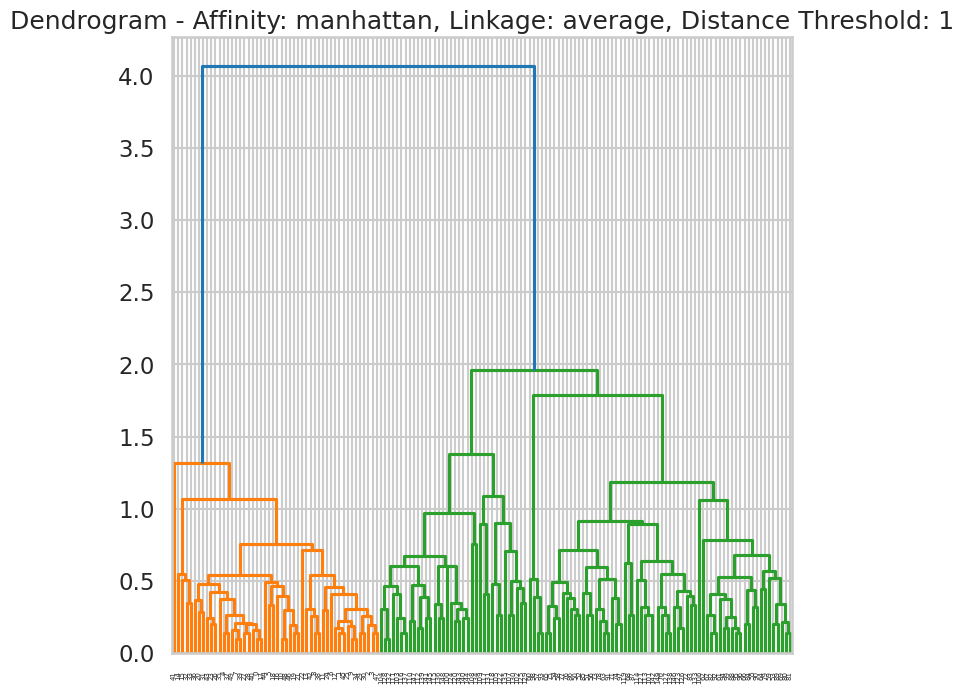

LENGTHHHHHHHHH ::::::::::::::::: 28


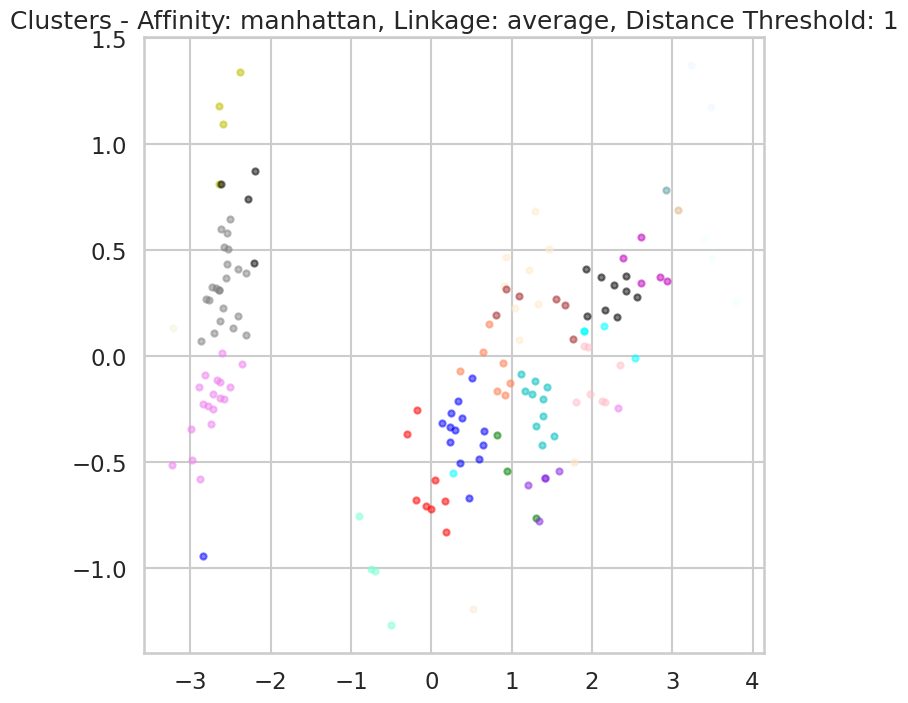

Silhouette Score - Affinity: manhattan, Linkage: average, Distance Threshold: 1: 0.26306030563698024


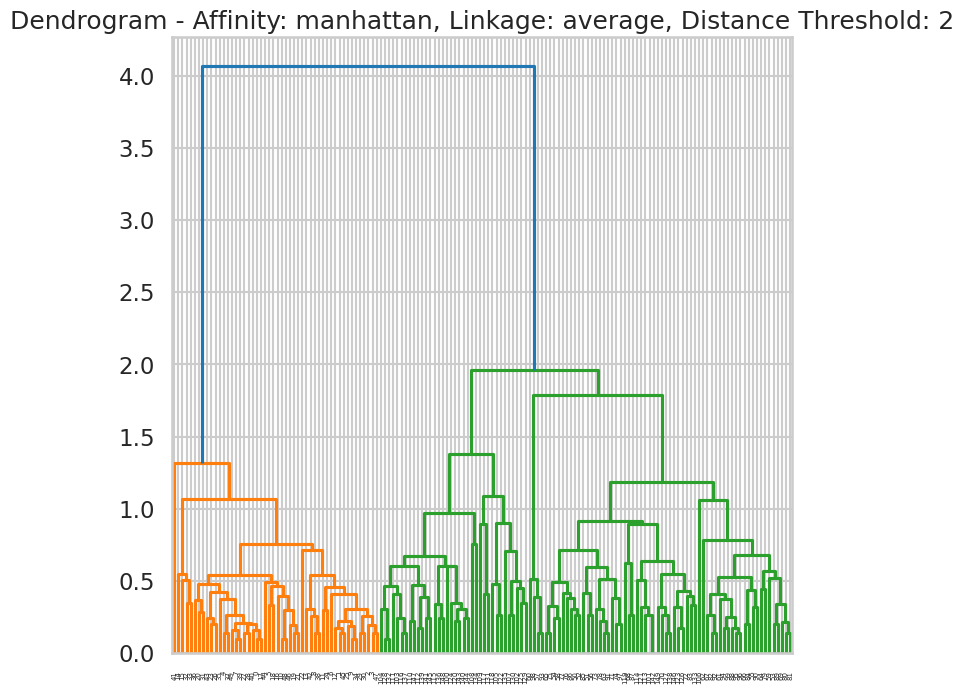

LENGTHHHHHHHHH ::::::::::::::::: 5


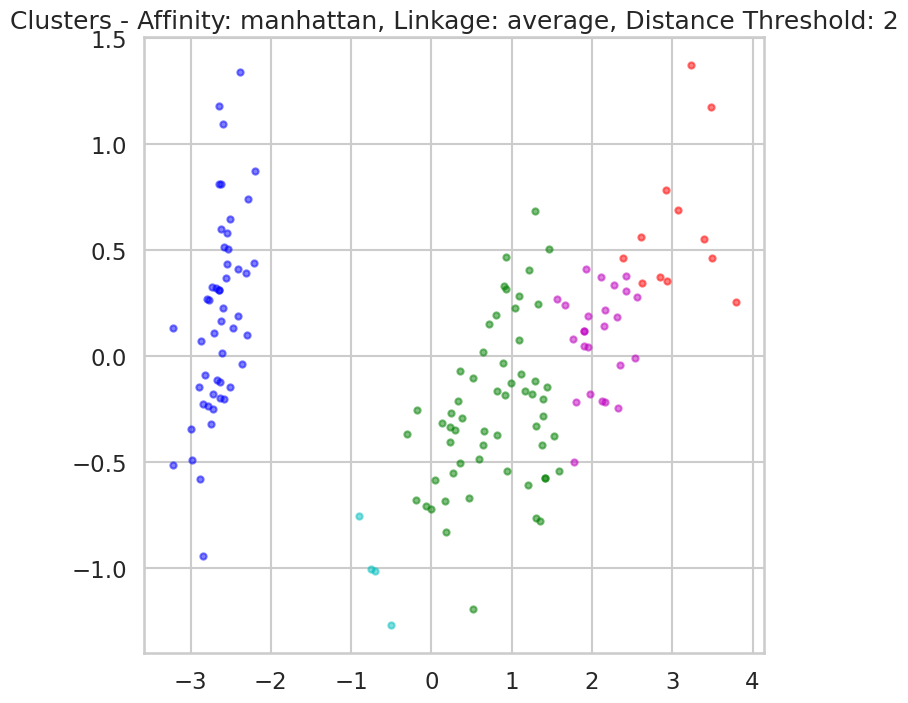

Silhouette Score - Affinity: manhattan, Linkage: average, Distance Threshold: 2: 0.43184804588959724


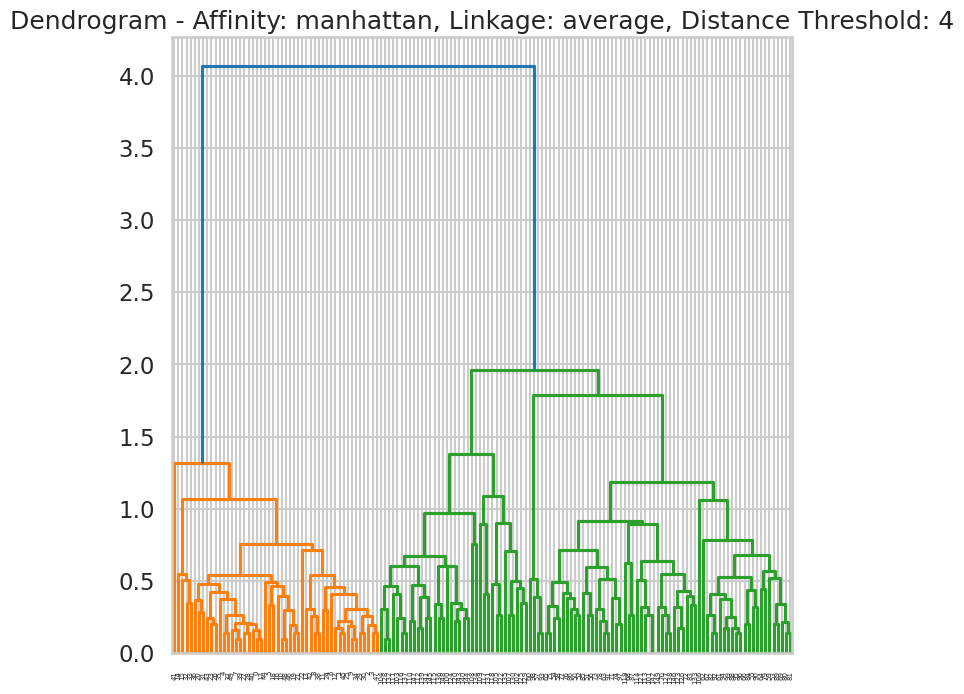

LENGTHHHHHHHHH ::::::::::::::::: 2


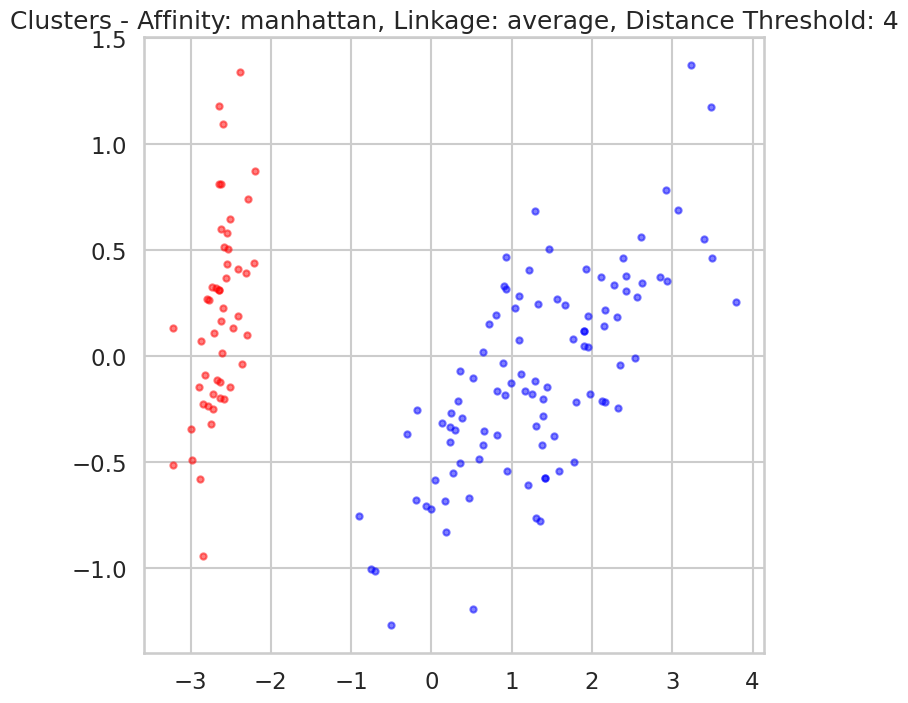

Silhouette Score - Affinity: manhattan, Linkage: average, Distance Threshold: 4: 0.6867350732769777


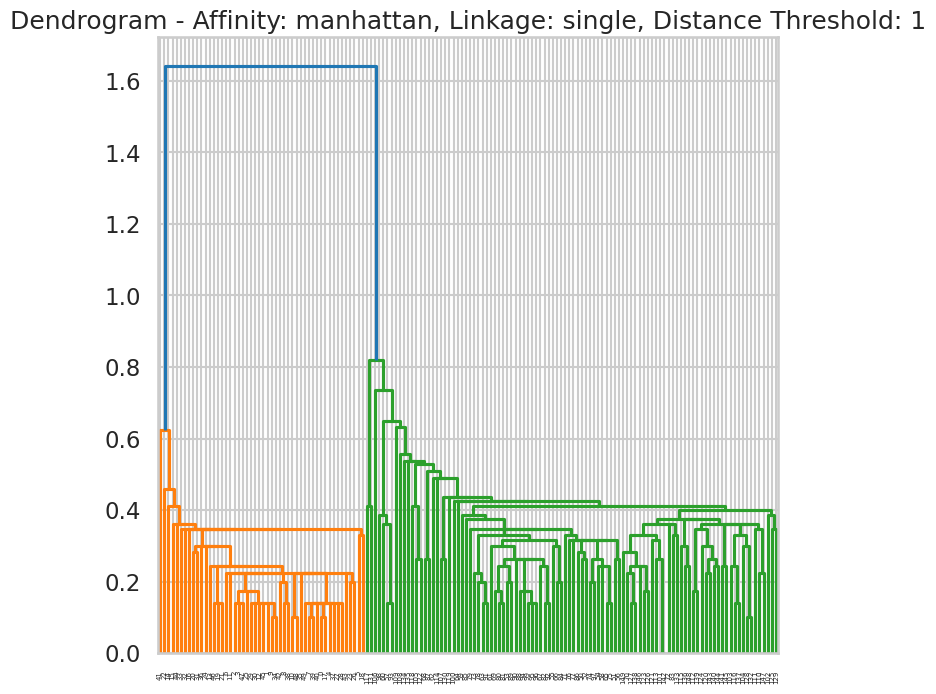

LENGTHHHHHHHHH ::::::::::::::::: 7


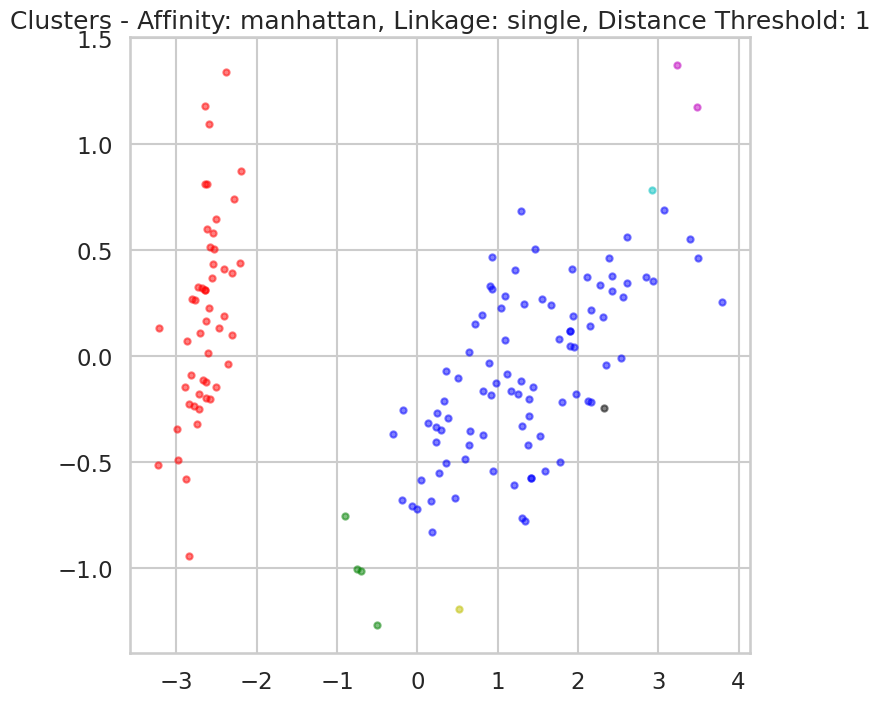

Silhouette Score - Affinity: manhattan, Linkage: single, Distance Threshold: 1: 0.14738244260973818


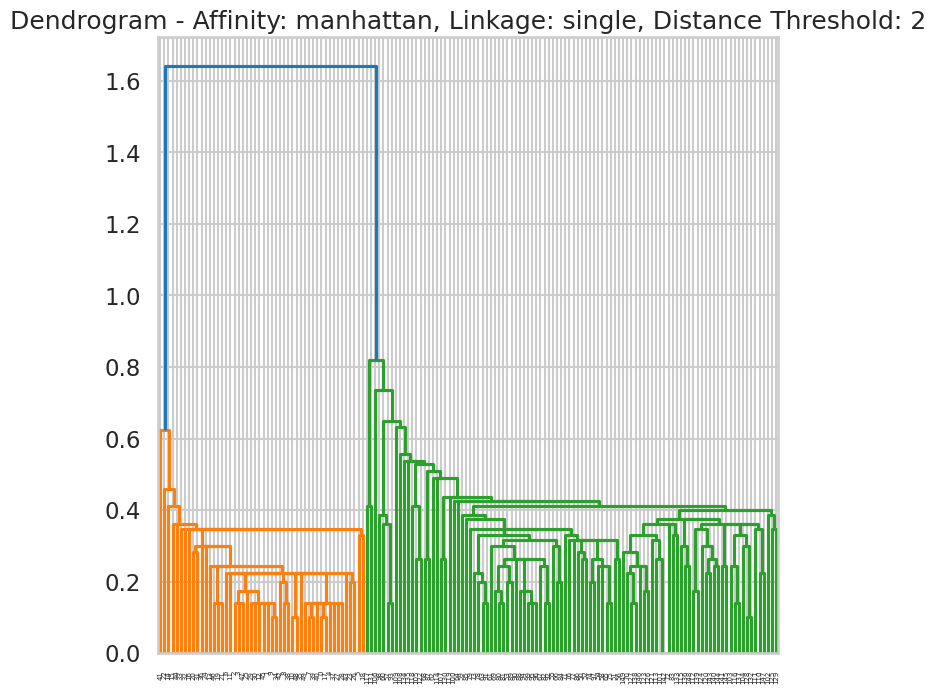

LENGTHHHHHHHHH ::::::::::::::::: 2


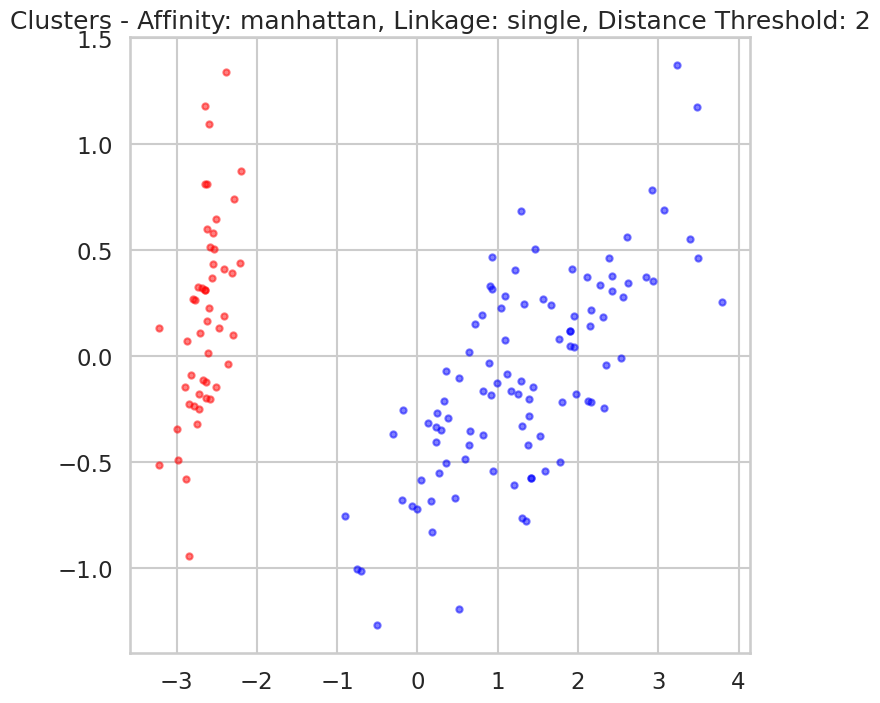

Silhouette Score - Affinity: manhattan, Linkage: single, Distance Threshold: 2: 0.6867350732769777
Only one cluster created - Affinity: manhattan, Linkage: single, Distance Threshold: 4. Skipping...
Only one cluster created - Affinity: cosine, Linkage: average, Distance Threshold: 1. Skipping...
Only one cluster created - Affinity: cosine, Linkage: average, Distance Threshold: 2. Skipping...
Only one cluster created - Affinity: cosine, Linkage: average, Distance Threshold: 4. Skipping...
Only one cluster created - Affinity: cosine, Linkage: single, Distance Threshold: 1. Skipping...
Only one cluster created - Affinity: cosine, Linkage: single, Distance Threshold: 2. Skipping...
Only one cluster created - Affinity: cosine, Linkage: single, Distance Threshold: 4. Skipping...

Best parameters: {'affinity': 'euclidean', 'linkage': 'average', 'distance_threshold': 2}
Best silhouette score: 0.6867350732769777


In [ ]:
from scipy.cluster.hierarchy import dendrogram
from sklearn.cluster import AgglomerativeClustering
import seaborn as sns
from scipy.cluster.hierarchy import dendrogram, linkage
import scipy


# Helper function to display clusters
def display_cluster(X, labels):
    pca = PCA(n_components=2)
    X_pca = pca.fit_transform(X)
    color = ['b', 'r', 'g', 'c', 'm', 'y', 'k', 'violet', 'aqua', 'pink', 'violet','grey', 'coral', 'brown']  # List of colors
    alpha = 0.5  # Color opacity
    s = 20
    print('LENGTHHHHHHHHH :::::::::::::::::',len(np.unique(labels)))
    for i in range(len(np.unique(labels))):
        plt.scatter(X_pca[labels == i, 0], X_pca[labels == i, 1], c=colors[i], alpha=alpha, s=s)



# Define parameter values to try
affinities = ['euclidean', 'manhattan', 'cosine']
linkages = ['average', 'single']
distance_thresholds = [1, 2, 4]

best_score = -1
best_params = {}

# Iterate over different parameter combinations
for affinity in affinities:
    for linkage in linkages:
        for distance_threshold in distance_thresholds:
            n_clusters = None
            model = AgglomerativeClustering(n_clusters=n_clusters, affinity=affinity, linkage=linkage, distance_threshold=distance_threshold)
            labels = model.fit_predict(iris_data)
            if len(np.unique(labels)) > 1:
                score = silhouette_score(iris_data, labels)

                # Display dendrogram
                Z = scipy.cluster.hierarchy.linkage(iris_data, method=linkage)
                plt.figure()
                plt.title(f'Dendrogram - Affinity: {affinity}, Linkage: {linkage}, Distance Threshold: {distance_threshold}')
                dendrogram(Z)
                plt.show()

                # Display resulting clusters
                plt.figure()
                plt.title(f'Clusters - Affinity: {affinity}, Linkage: {linkage}, Distance Threshold: {distance_threshold}')
                display_cluster(iris_data, labels)
                plt.show()

                print(f'Silhouette Score - Affinity: {affinity}, Linkage: {linkage}, Distance Threshold: {distance_threshold}: {score}')

                # Update best score and parameters if current score is better
                if score > best_score:
                    best_score = score
                    best_params['affinity'] = affinity
                    best_params['linkage'] = linkage
                    best_params['distance_threshold'] = distance_threshold
            else:
                print(f'Only one cluster created - Affinity: {affinity}, Linkage: {linkage}, Distance Threshold: {distance_threshold}. Skipping...')
                # best_params['distance_threshold'] = distance_threshold

# Print best parameters and score
print("\nBest parameters:", best_params)
print("Best silhouette score:", best_score)


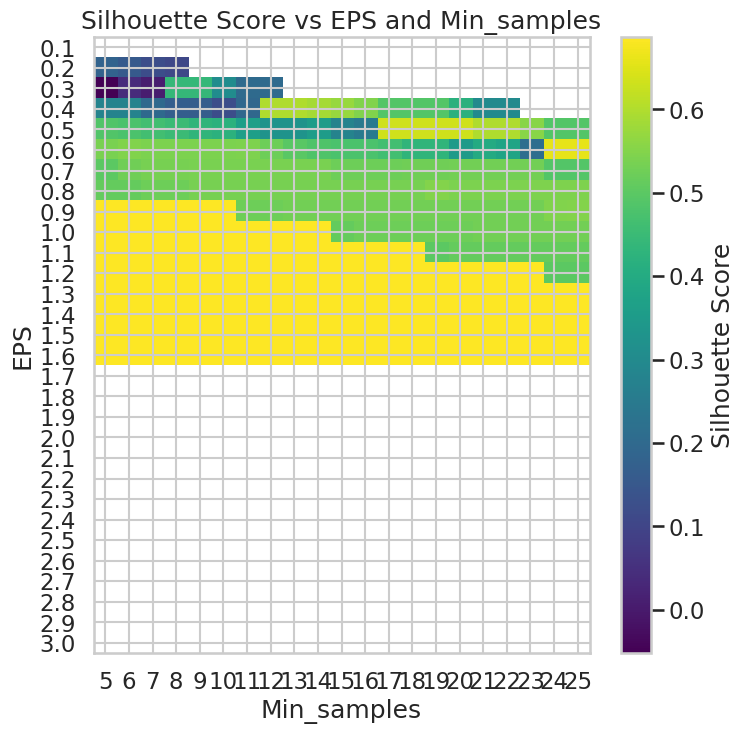


Best parameters: {'EPS': 0.8999999999999999, 'Min_samples': 5}
Best silhouette score: 0.6867350732769777


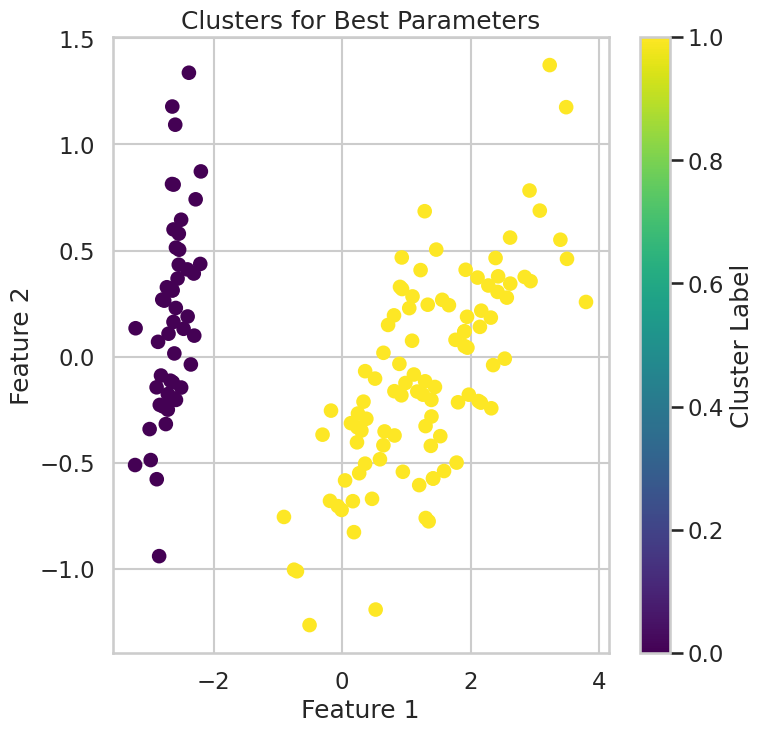

In [ ]:
# Define parameter values to try
EPS_values = np.linspace(0.1, 3, 30)
Min_samples_values = np.arange(5, 26)

best_score = -1
best_params = {}

# Iterate over different parameter combinations
for EPS in EPS_values:
    for Min_samples in Min_samples_values:
        model = DBSCAN(eps=EPS, min_samples=Min_samples)
        labels = model.fit_predict(iris_data)

        # Exclude outliers (-1) from silhouette score calculation
        if len(np.unique(labels)) > 1:
            score = silhouette_score(iris_data, labels)
            # Update best score and parameters if current score is better
            if score > best_score:
                best_score = score
                best_params['EPS'] = EPS
                best_params['Min_samples'] = Min_samples

# Plot silhouette score versus EPS and Min_samples
scores = np.zeros((len(EPS_values), len(Min_samples_values)))
for i, EPS in enumerate(EPS_values):
    for j, Min_samples in enumerate(Min_samples_values):
        model = DBSCAN(eps=EPS, min_samples=Min_samples)
        labels = model.fit_predict(iris_data)
        if len(np.unique(labels)) > 1:
            scores[i, j] = silhouette_score(iris_data, labels)
        else:
            scores[i, j] = np.nan

plt.figure()
plt.imshow(scores, interpolation='nearest', cmap='viridis', aspect='auto')
plt.colorbar(label='Silhouette Score')
plt.xticks(np.arange(len(Min_samples_values)), Min_samples_values)
plt.xlabel('Min_samples')
plt.yticks(np.arange(len(EPS_values)), np.round(EPS_values, 2))
plt.ylabel('EPS')
plt.title('Silhouette Score vs EPS and Min_samples')
plt.show()

# Print best parameters and score
print("\nBest parameters:", best_params)
print("Best silhouette score:", best_score)
best_model = DBSCAN(eps=best_params['EPS'], min_samples=best_params['Min_samples'])
best_labels = best_model.fit_predict(iris_data)

pca = PCA(n_components=2)
X_pca = pca.fit_transform(iris_data)
plt.figure()
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=best_model.labels_, cmap='viridis')
plt.title('Clusters for Best Parameters')
plt.xlabel('Feature 1')
plt.ylabel('Feature 2')
plt.colorbar(label='Cluster Label')
plt.show()


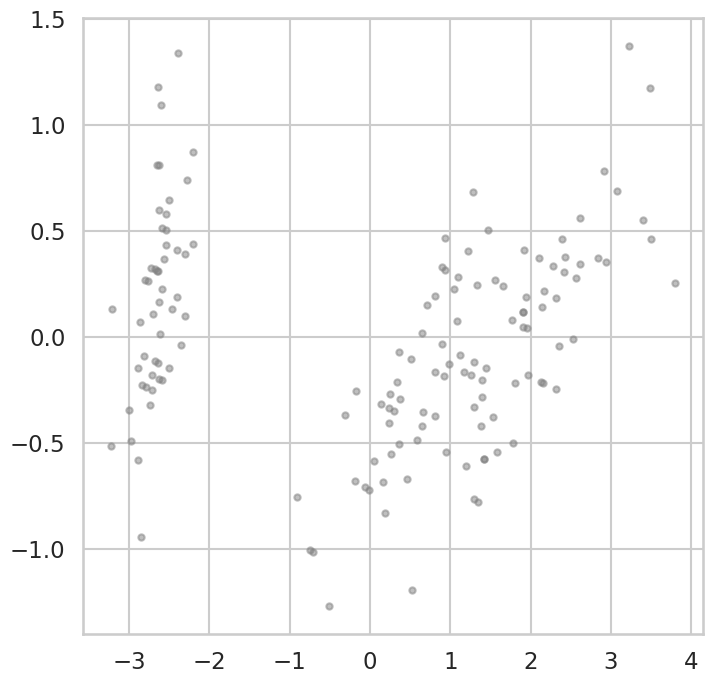

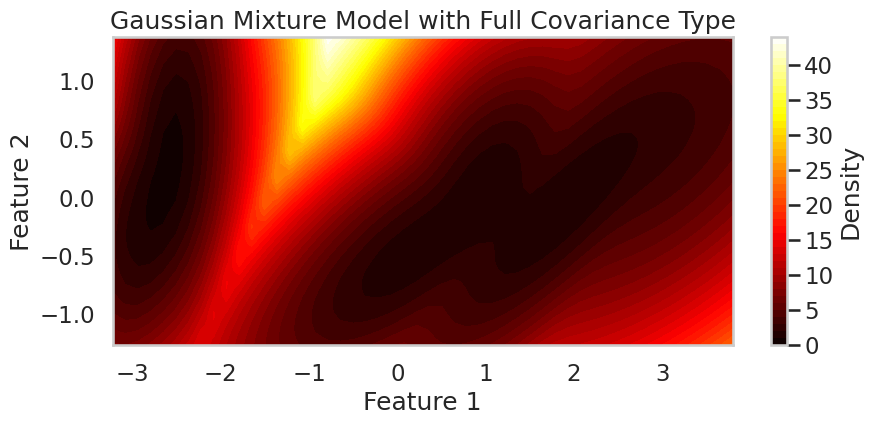

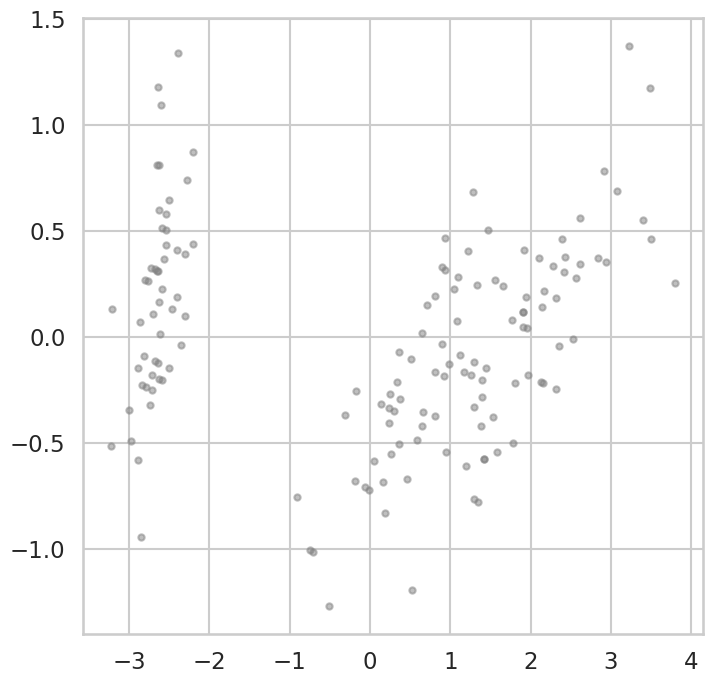

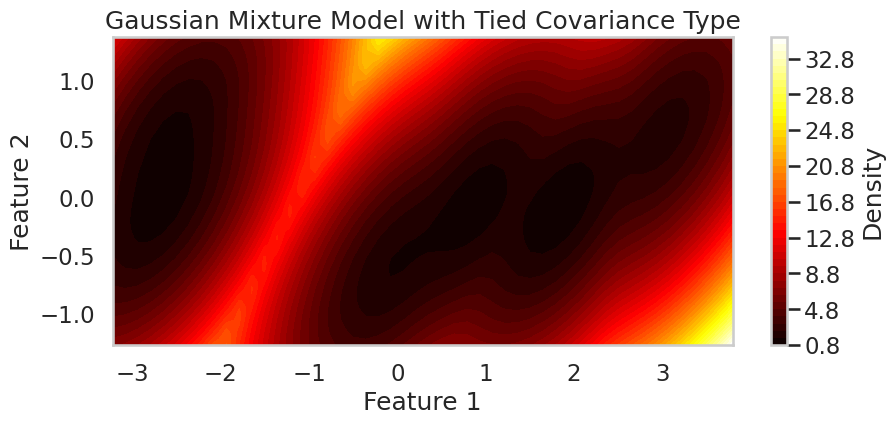

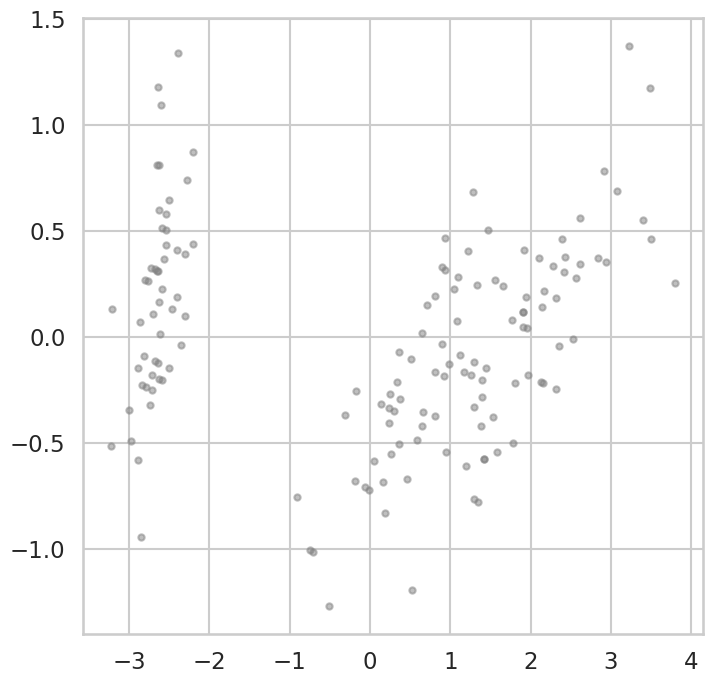

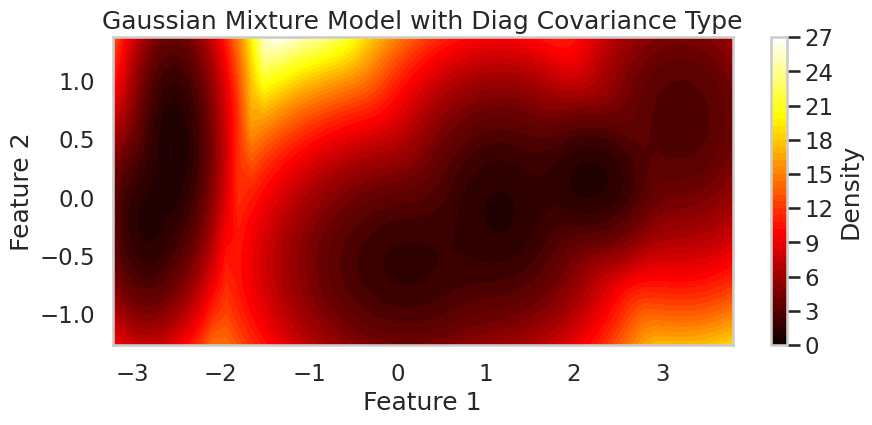

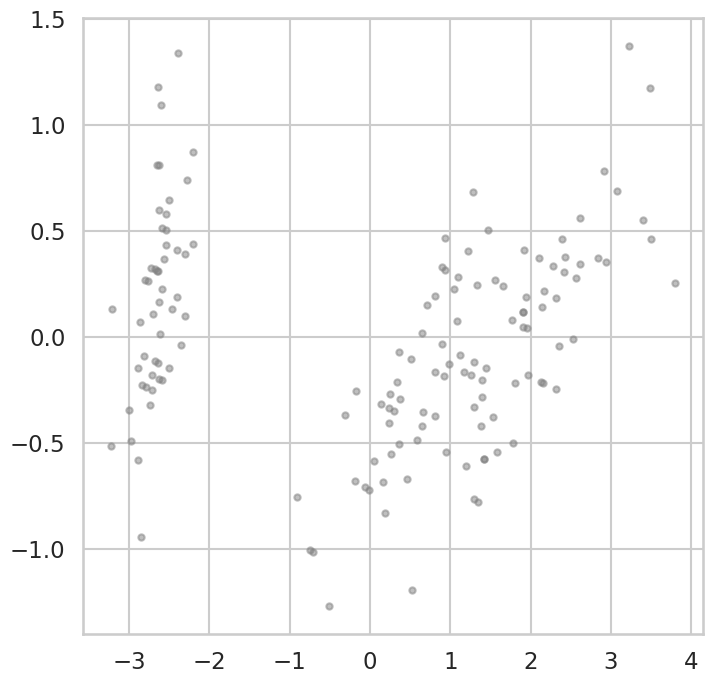

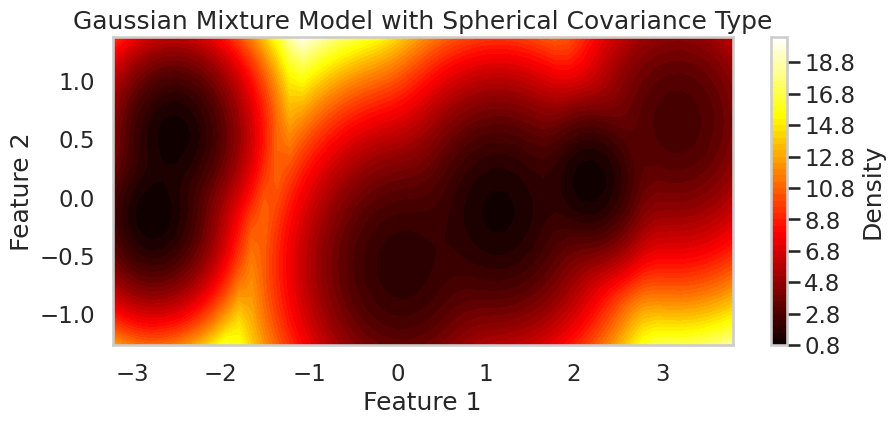

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.datasets import load_iris
from sklearn.mixture import GaussianMixture
import seaborn as sns

# Load the Iris dataset
iris_data = load_iris().data

# Define covariance types to try
covariance_types = ['full', 'tied', 'diag', 'spherical']

# Plot all features against each other in pairs
# sns.pairplot(sns.load_dataset("iris"), diag_kind='kde', markers='.')
# plt.suptitle('Pairplot of Iris Dataset', y=1.02)
# plt.show()

# Fit Gaussian mixture models with different covariance types
for cov_type in covariance_types:
    pca = PCA(n_components=2)
    X_pca = pca.fit_transform(iris_data)
    plt.figure()
    plt.scatter(X_pca[:, 0], X_pca[:, 1], marker='.', color='gray', alpha=0.5, label='Data')
    gmm = GaussianMixture(n_components=6, covariance_type=cov_type, random_state=42)
    gmm.fit(X_pca[:, :2])  # Use only the first two features for visualization
    x = np.linspace(X_pca[:, 0].min(), X_pca[:, 0].max())
    y = np.linspace(X_pca[:, 1].min(), X_pca[:, 1].max())
    X, Y = np.meshgrid(x, y)
    XX = np.array([X.ravel(), Y.ravel()]).T
    Z = -gmm.score_samples(XX)
    Z = Z.reshape(X.shape)
    plt.figure(figsize=(10, 4))
    plt.contourf(X, Y, Z, cmap='hot', levels=50)  # 'hot' colormap for heatmap-like colors
    plt.colorbar(label='Density')
    plt.xlim(X.min(), X.max())
    plt.ylim(Y.min(), Y.max())
    plt.scatter(X[:, 0], X[:, 1], s=10, color='black')  # Scatter plot of the data points
    plt.title(f'Gaussian Mixture Model with {cov_type.capitalize()} Covariance Type')
    plt.xlabel('Feature 1')
    plt.ylabel('Feature 2')
    plt.show()
    # CS = plt.contour(X, Y, Z, levels=10, linewidths=1, alpha=0.5, label=cov_type)
    # plt.colorbar(CS, shrink=0.8, extend='both')
    # plt.title(f'Gaussian Mixture Model with {cov_type.capitalize()} Covariance Type')
    # plt.xlabel('Feature 0')
    # plt.ylabel('Feature 1')
    # plt.legend()
    # plt.show()


In [ ]:
from sklearn.datasets import load_iris
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()

iris_data = load_iris().data

iris_data_normalized = scaler.fit_transform(iris_data)
# iris_data_normalized = iris_data_normalized.data
iris_data_normalized

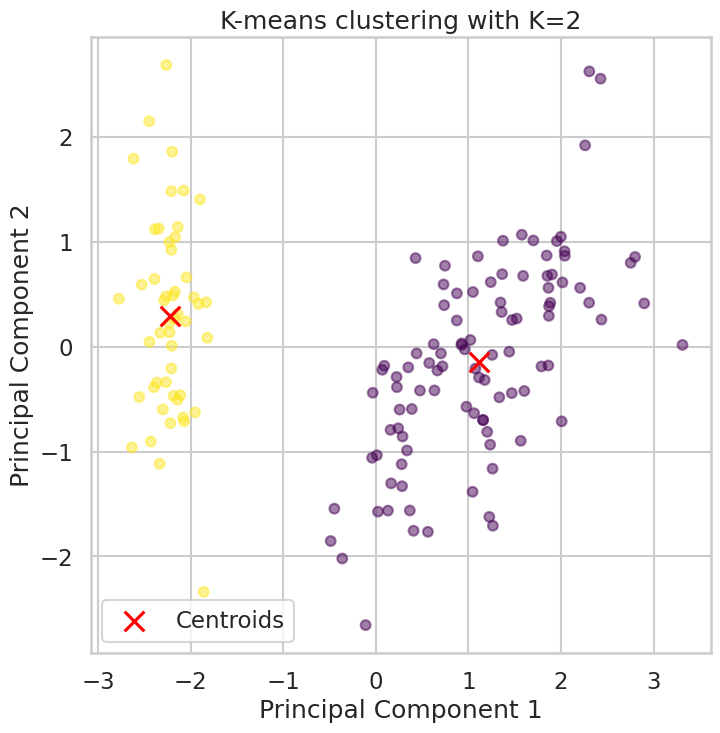

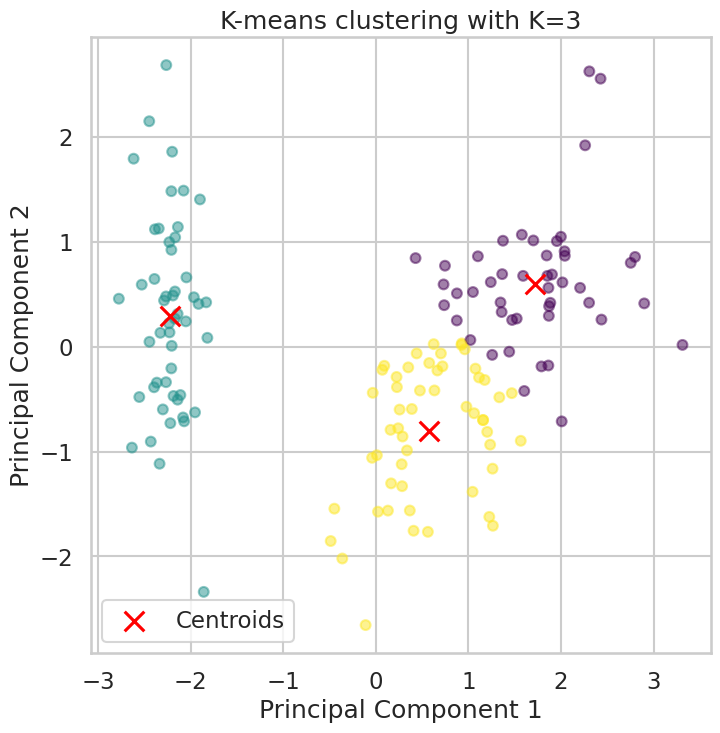

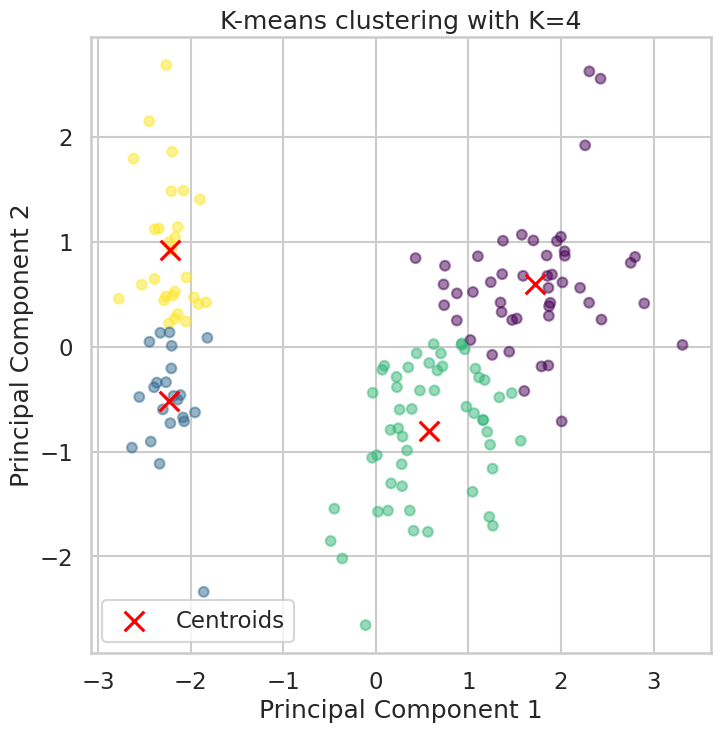

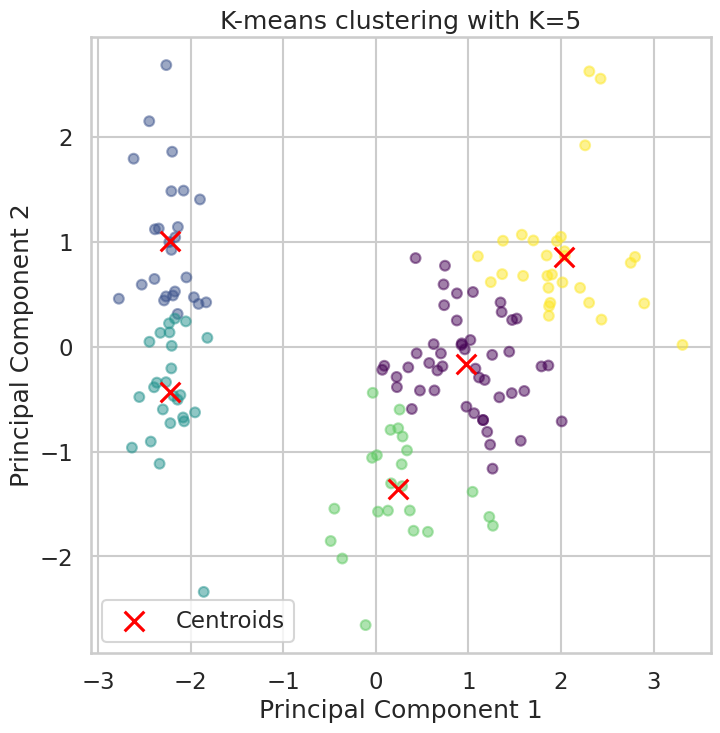

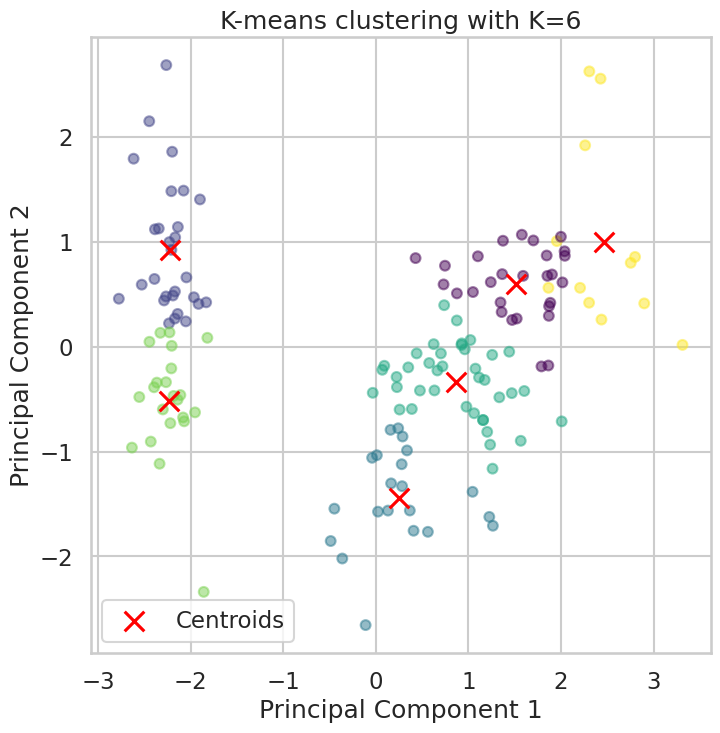

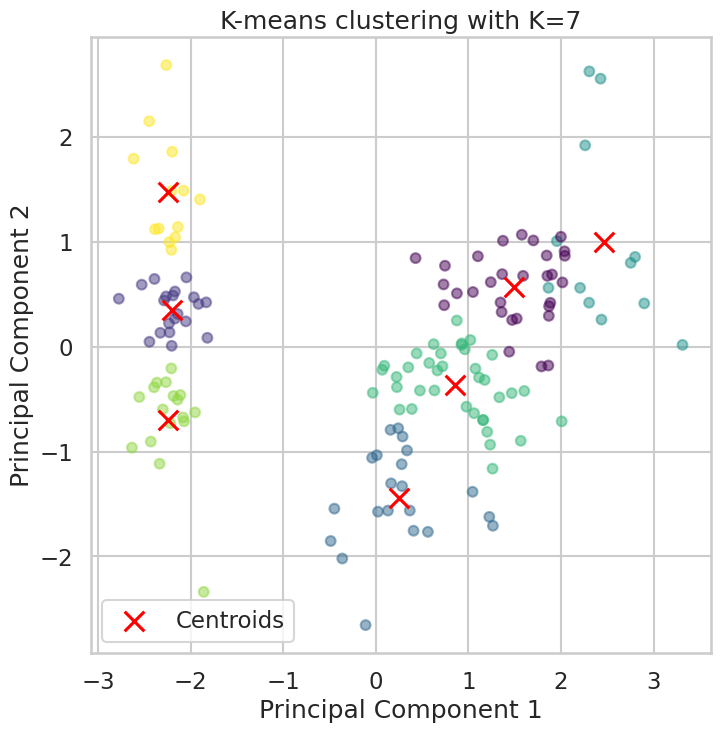

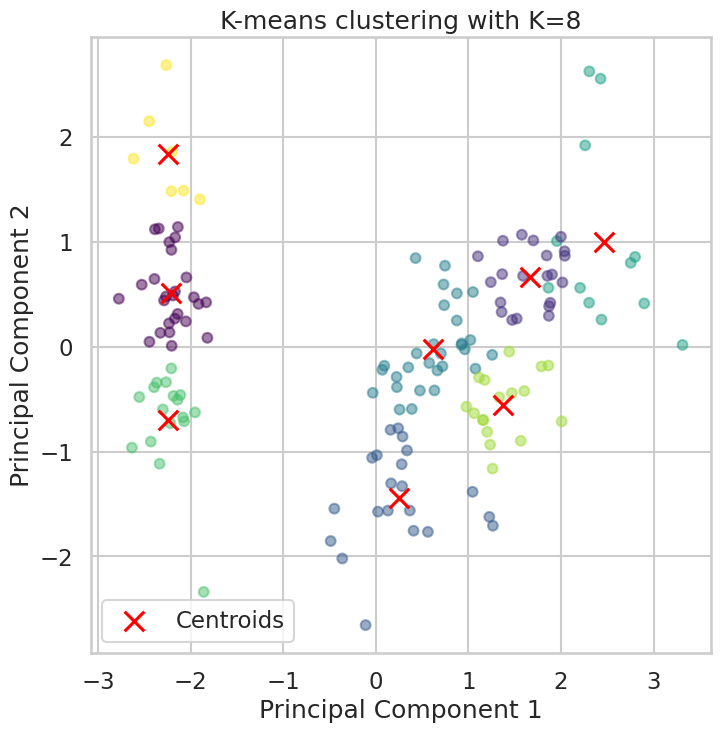

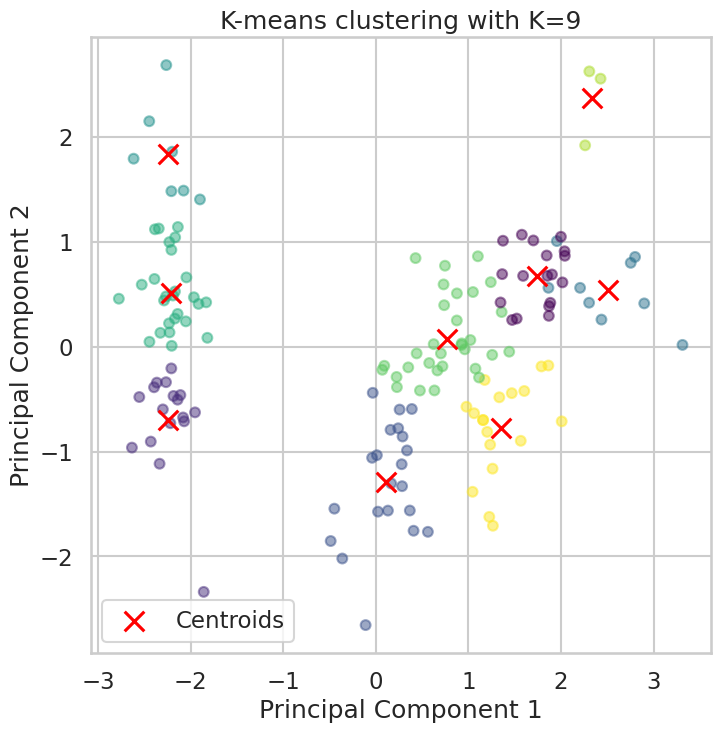

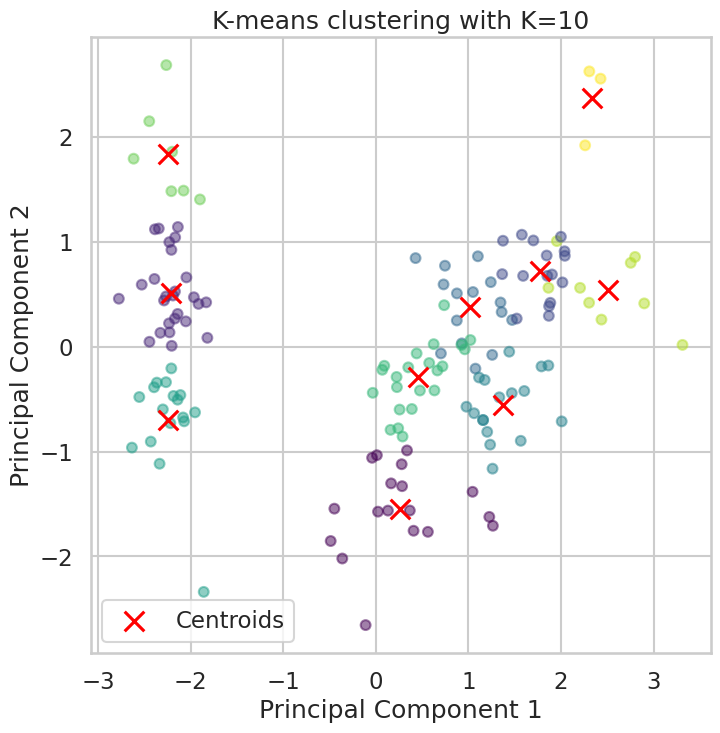

Best value of K based on silhouette score: 2
Best silhouette score: 0.5817500491982808


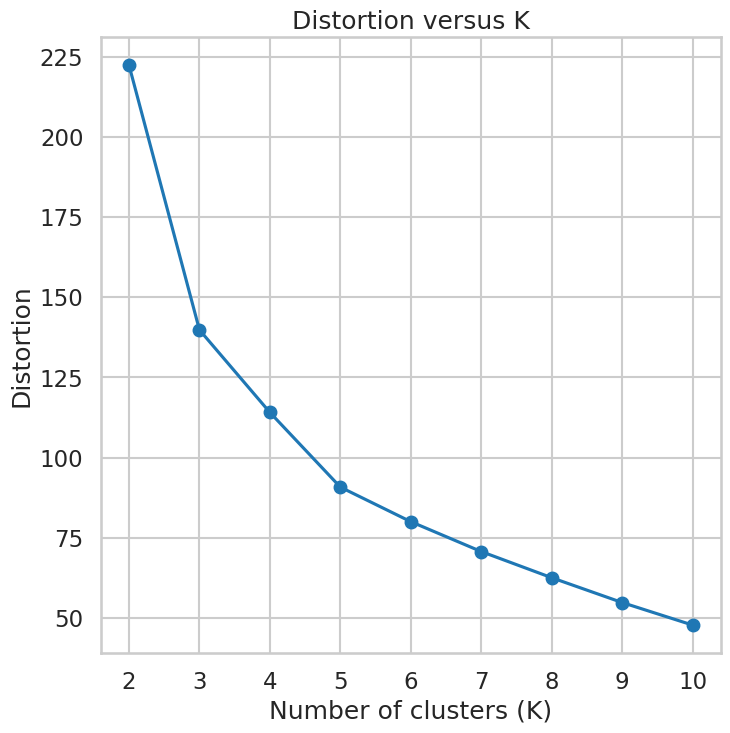

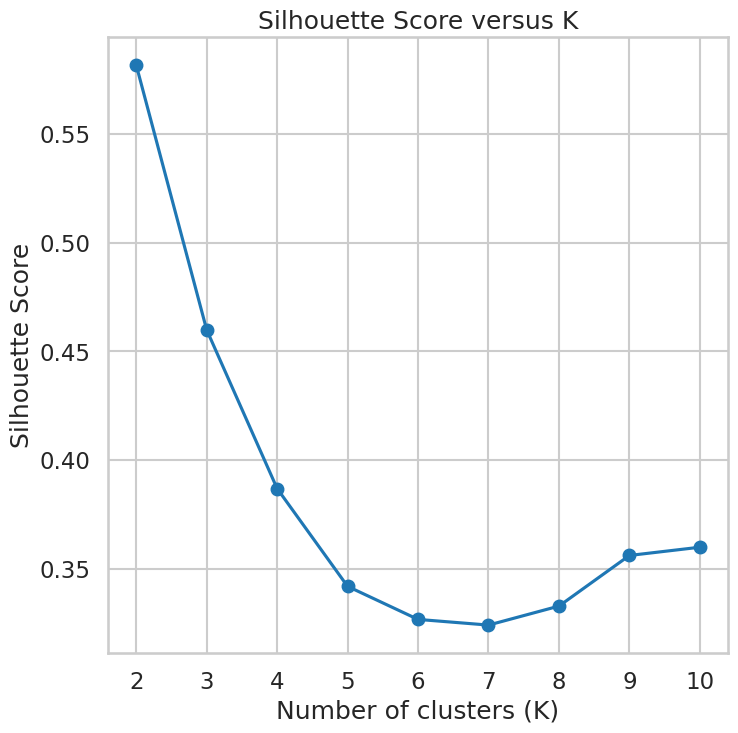

In [ ]:
from sklearn.decomposition import PCA

# Perform K-means clustering with different values of K
K_values = range(2, 11)  # Values of K to try
distortions = []  # List to store distortion values
silhouette_scores = []  # List to store silhouette scores

# Function to display clusters
def display_cluster(X, km, k):
    pca = PCA(n_components=2)
    X_pca = pca.fit_transform(X)
    centroids = pca.transform(km.cluster_centers_)
    plt.scatter(X_pca[:, 0], X_pca[:, 1], c=km.labels_, cmap='viridis', s=50, alpha=0.5)
    plt.scatter(centroids[:, 0], centroids[:, 1], c='red', marker='x', s=200, label='Centroids')
    plt.xlabel('Principal Component 1')
    plt.ylabel('Principal Component 2')
    plt.title('K-means clustering with K={}'.format(k))
    plt.legend()
    plt.show()

for k in K_values:
    km = KMeans(n_clusters=k, random_state=42)
    km.fit(iris_data_normalized)
    distortions.append(km.inertia_)  # Sum of squared distances to closest cluster center
    silhouette_scores.append(silhouette_score(iris_data_normalized, km.labels_))  # Silhouette score

    # Display clusters for each value of K
    plt.figure()
    plt.title("K-means clustering with K={}".format(k))
    display_cluster(iris_data_normalized, km, k)

# Plot distortion function versus K
plt.figure()
plt.plot(K_values, distortions, marker='o')
plt.xlabel('Number of clusters (K)')
plt.ylabel('Distortion')
plt.title('Distortion versus K')

# Plot silhouette score versus K
plt.figure()
plt.plot(K_values, silhouette_scores, marker='o')
plt.xlabel('Number of clusters (K)')
plt.ylabel('Silhouette Score')
plt.title('Silhouette Score versus K')

# Find the best value of K based on silhouette score
best_K = K_values[np.argmax(silhouette_scores)]
print("Best value of K based on silhouette score:", best_K)
print("Best silhouette score:", np.max(silhouette_scores))
plt.show()


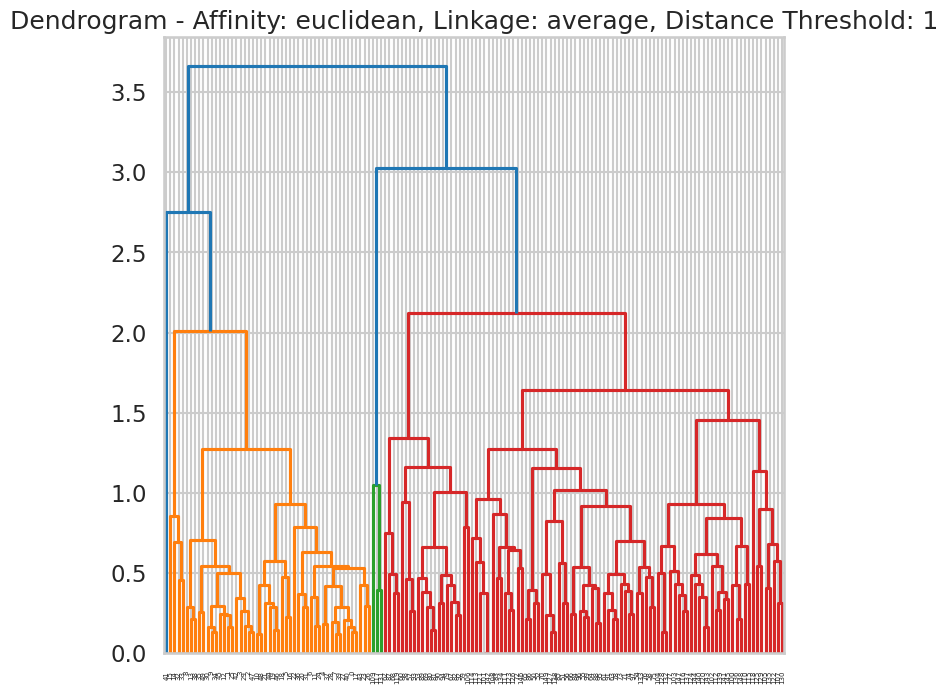

LENGTHHHHHHHHH ::::::::::::::::: 17


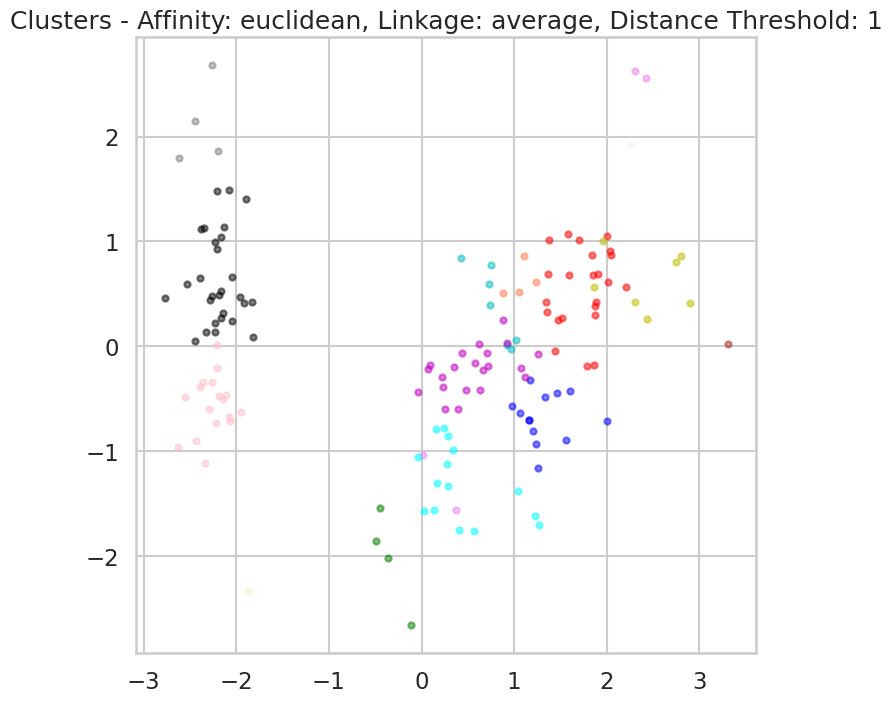

Silhouette Score - Affinity: euclidean, Linkage: average, Distance Threshold: 1: 0.30087506250740886


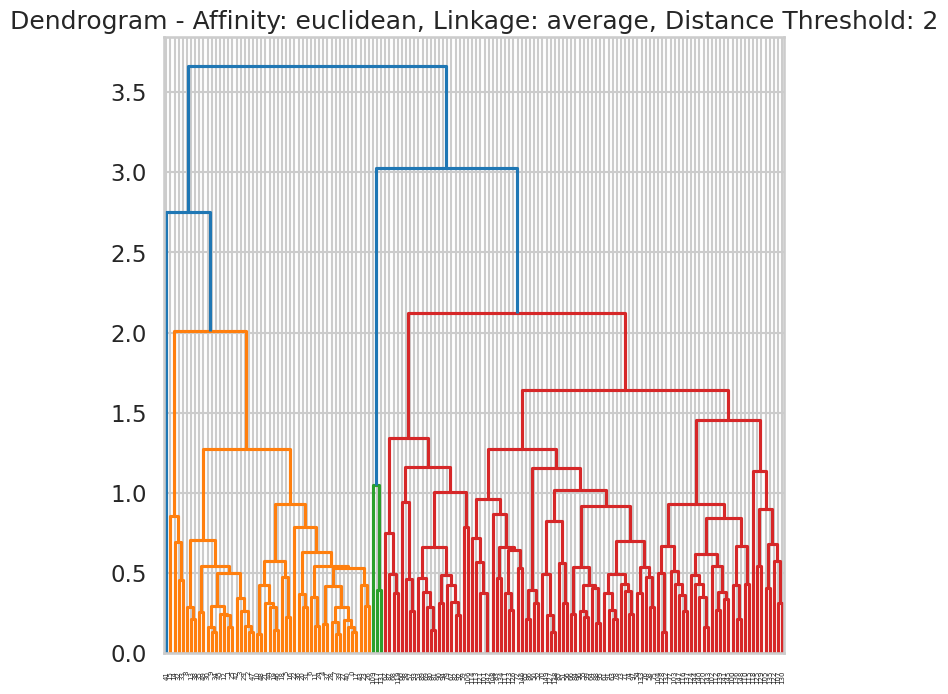

LENGTHHHHHHHHH ::::::::::::::::: 6


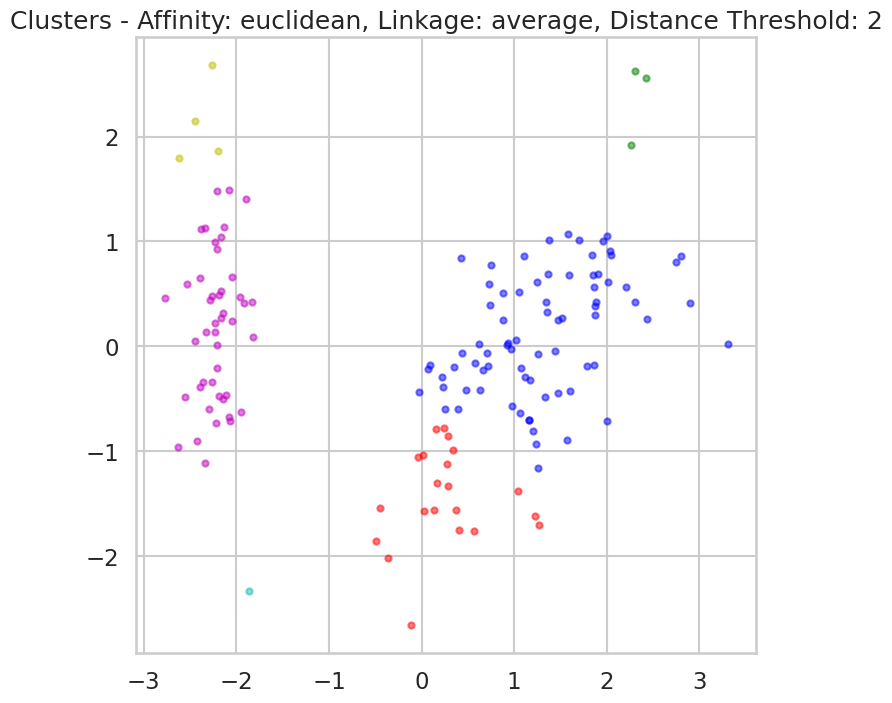

Silhouette Score - Affinity: euclidean, Linkage: average, Distance Threshold: 2: 0.3248248440740702
Only one cluster created - Affinity: euclidean, Linkage: average, Distance Threshold: 4. Skipping...


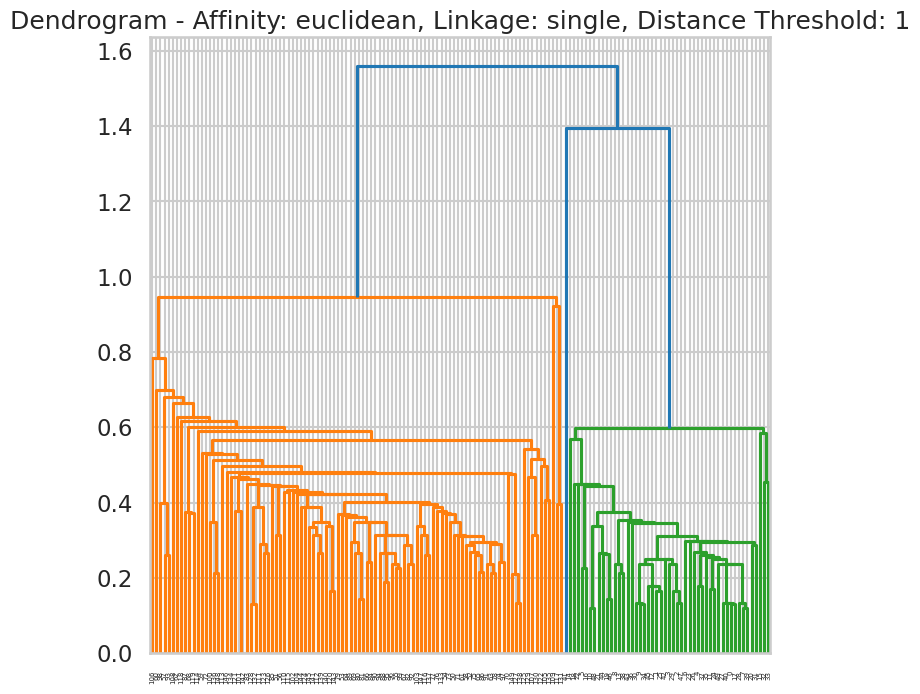

LENGTHHHHHHHHH ::::::::::::::::: 3


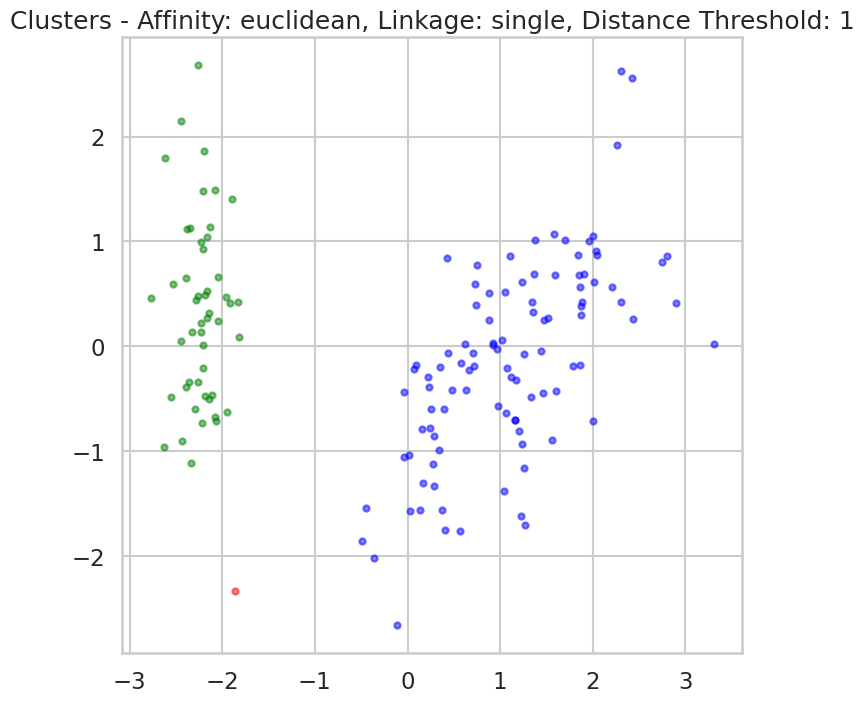

Silhouette Score - Affinity: euclidean, Linkage: single, Distance Threshold: 1: 0.504645610832545
Only one cluster created - Affinity: euclidean, Linkage: single, Distance Threshold: 2. Skipping...
Only one cluster created - Affinity: euclidean, Linkage: single, Distance Threshold: 4. Skipping...


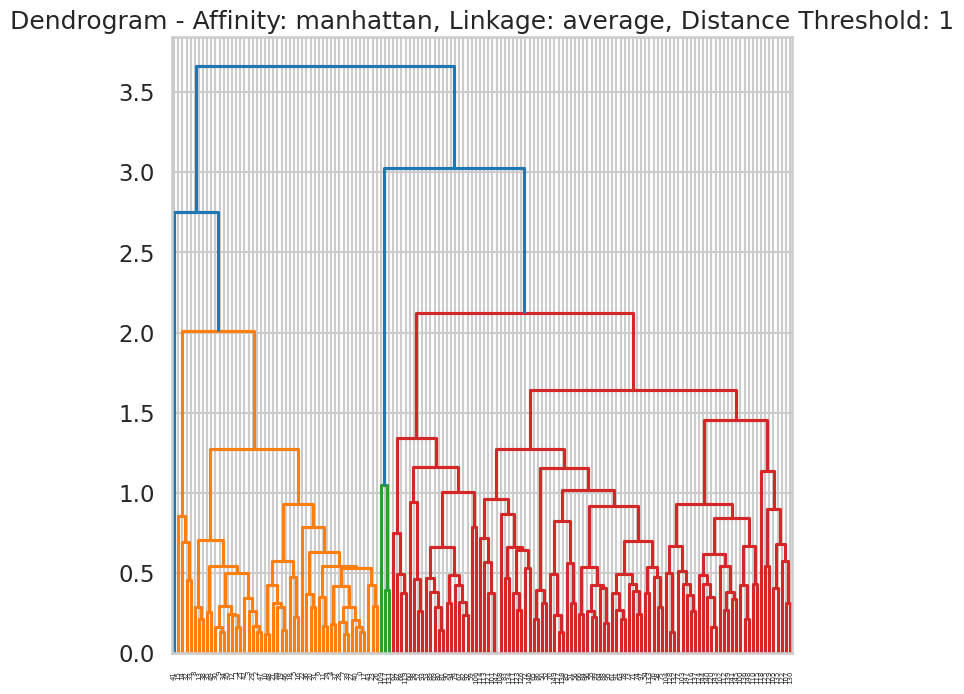

LENGTHHHHHHHHH ::::::::::::::::: 41


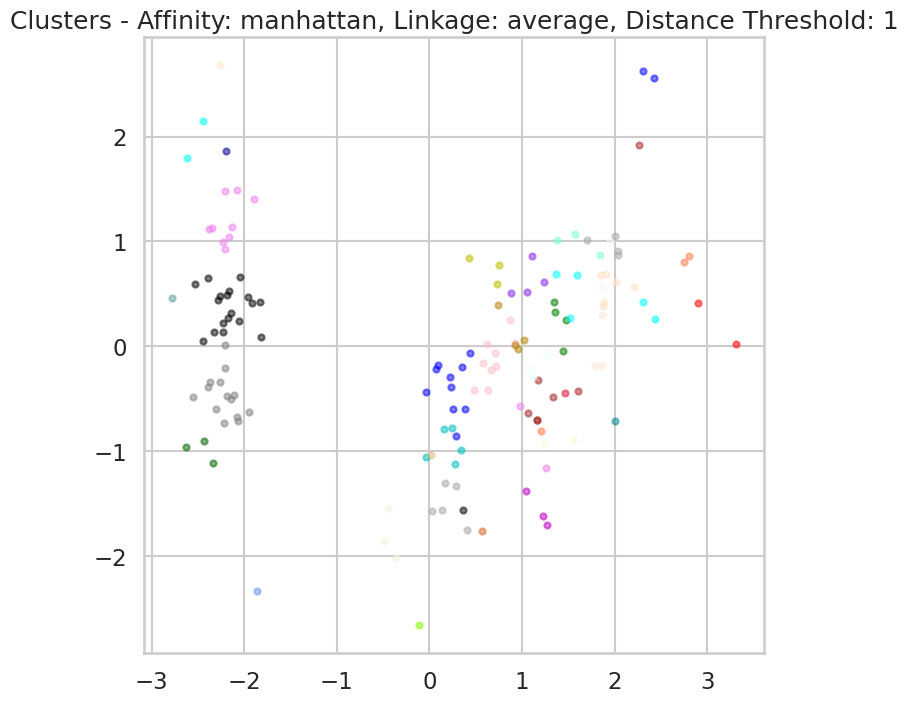

Silhouette Score - Affinity: manhattan, Linkage: average, Distance Threshold: 1: 0.2732481526741257


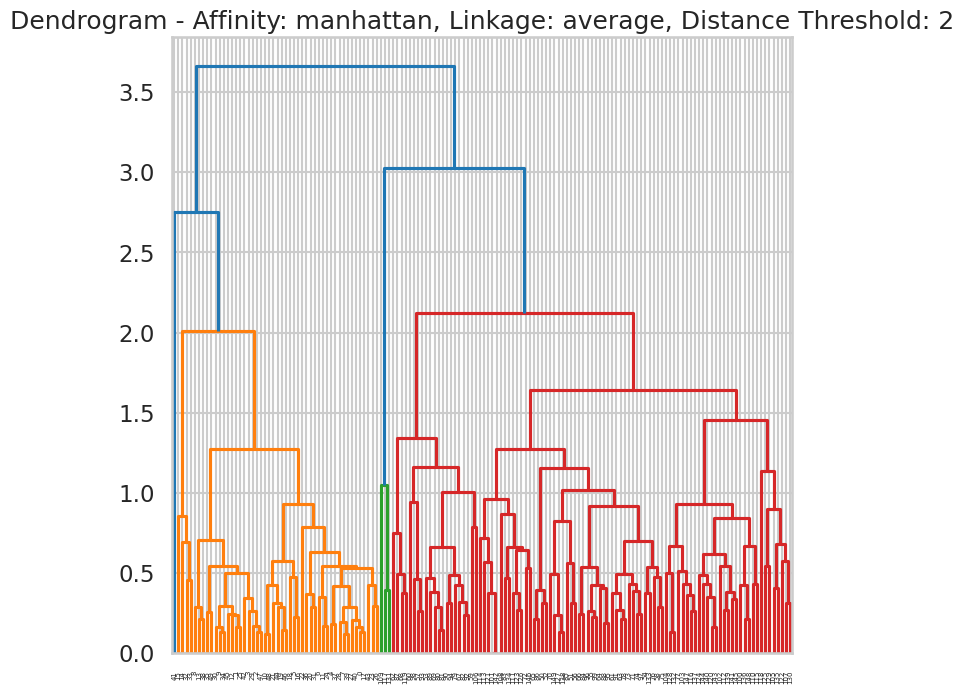

LENGTHHHHHHHHH ::::::::::::::::: 12


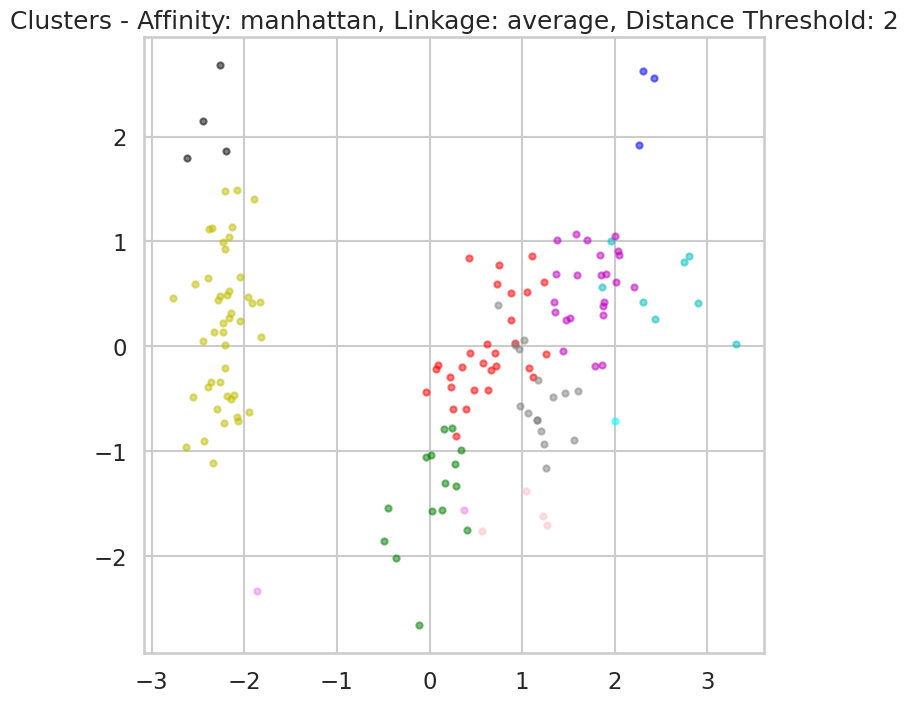

Silhouette Score - Affinity: manhattan, Linkage: average, Distance Threshold: 2: 0.2967728660671392


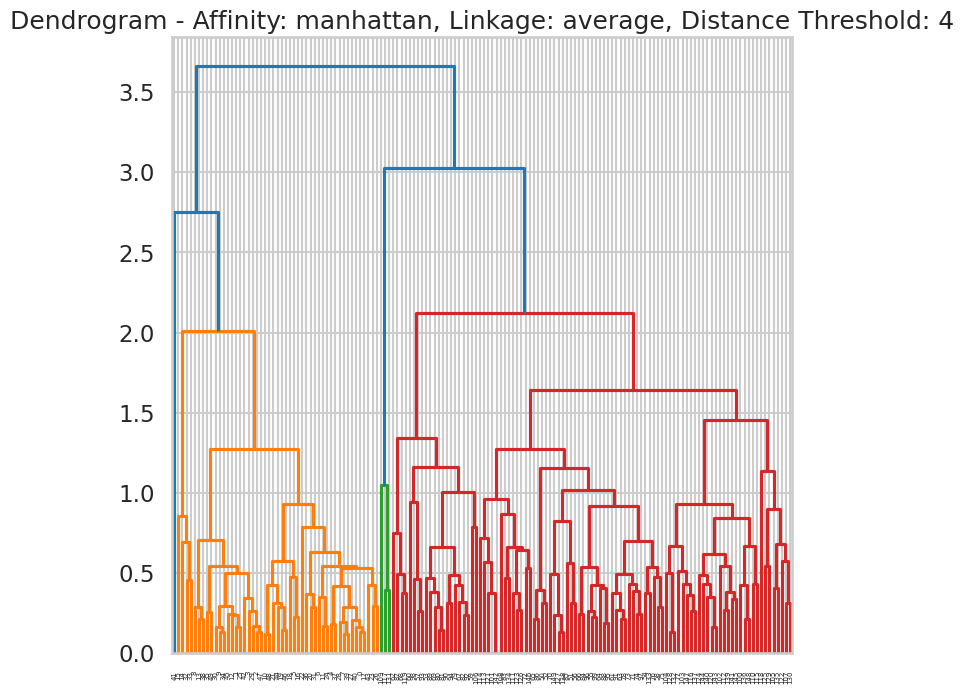

LENGTHHHHHHHHH ::::::::::::::::: 2


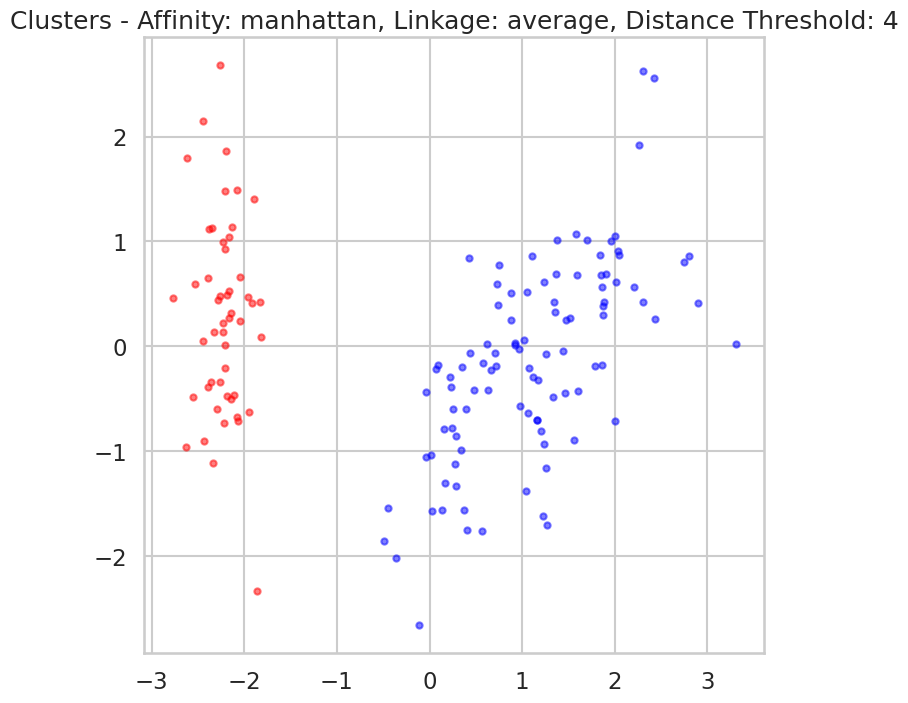

Silhouette Score - Affinity: manhattan, Linkage: average, Distance Threshold: 4: 0.5817500491982808


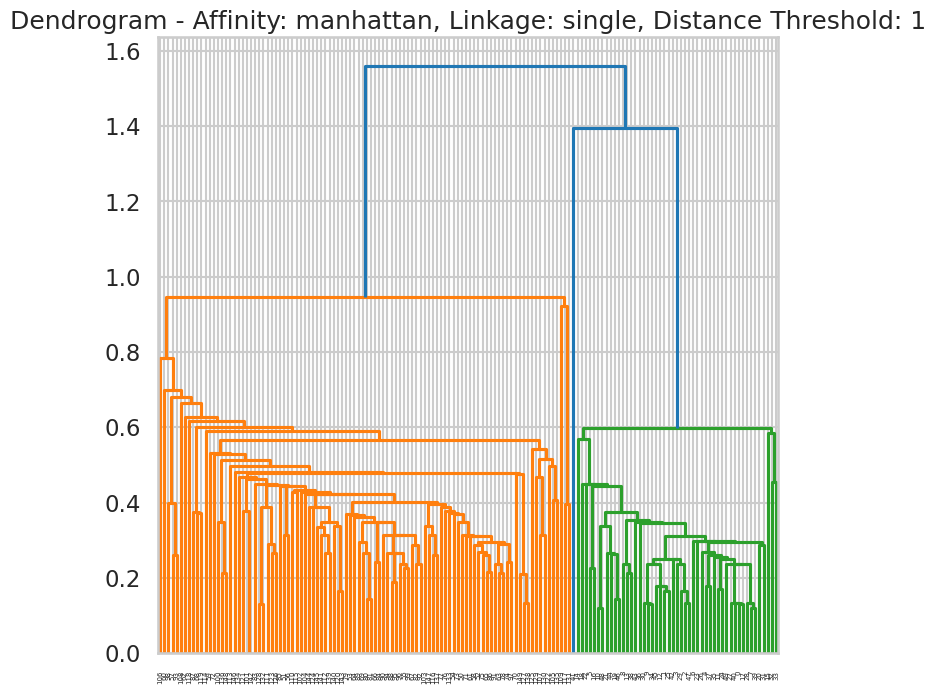

LENGTHHHHHHHHH ::::::::::::::::: 10


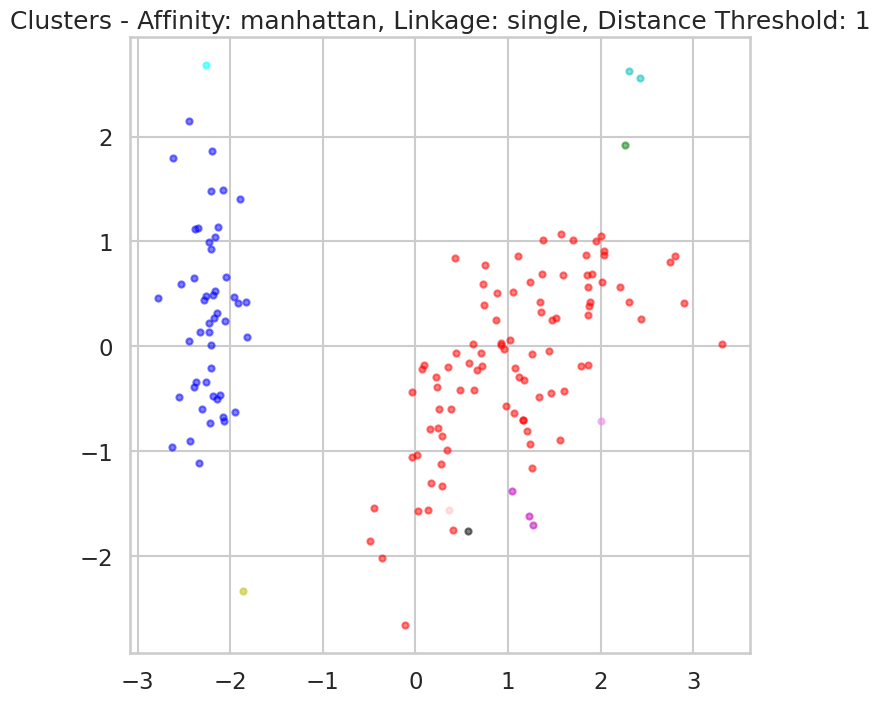

Silhouette Score - Affinity: manhattan, Linkage: single, Distance Threshold: 1: 0.05331724159191082


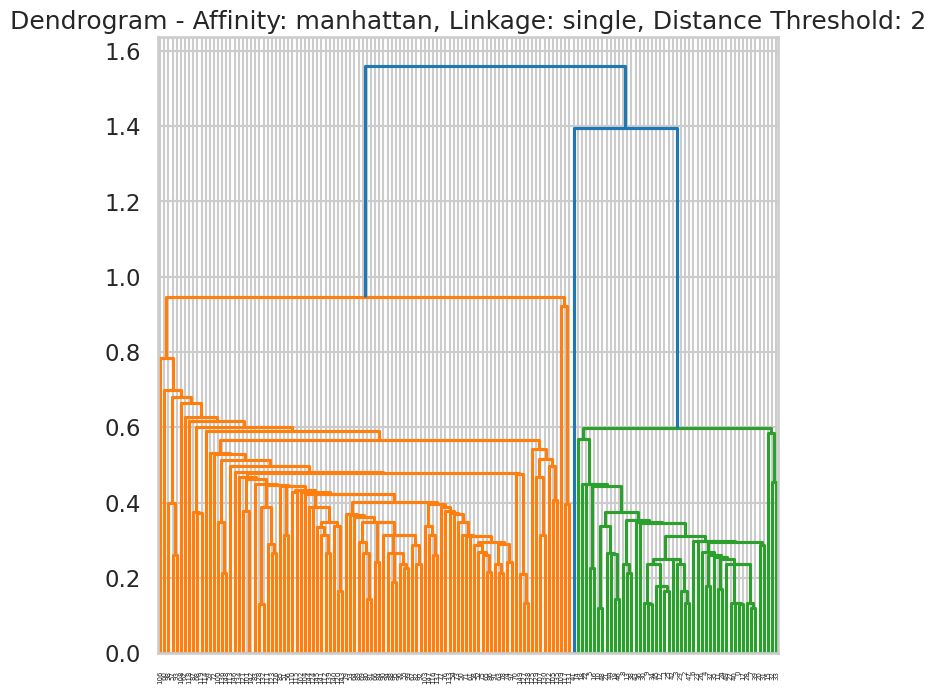

LENGTHHHHHHHHH ::::::::::::::::: 2


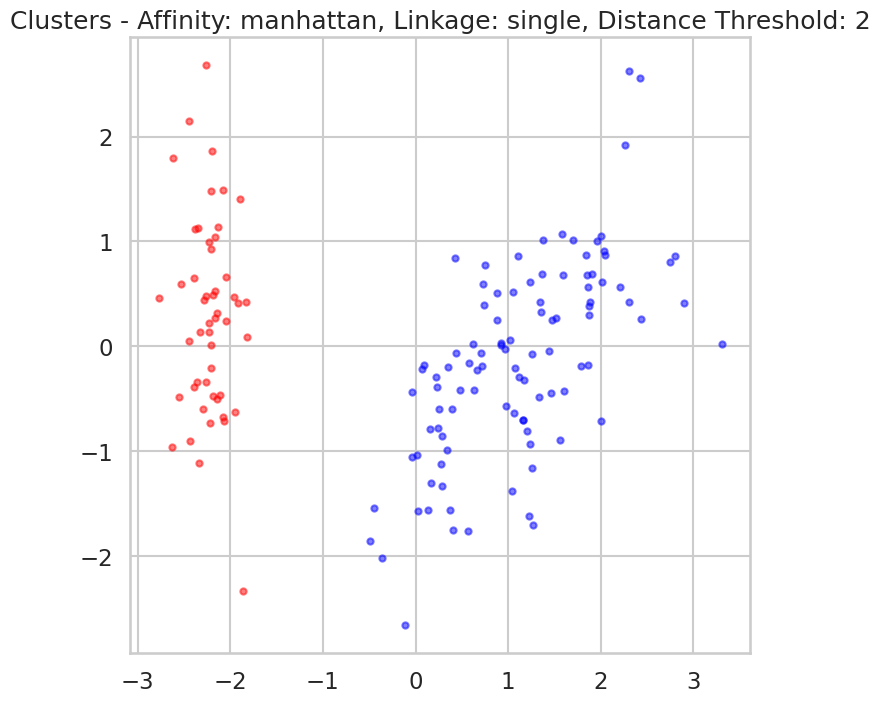

Silhouette Score - Affinity: manhattan, Linkage: single, Distance Threshold: 2: 0.5817500491982808
Only one cluster created - Affinity: manhattan, Linkage: single, Distance Threshold: 4. Skipping...


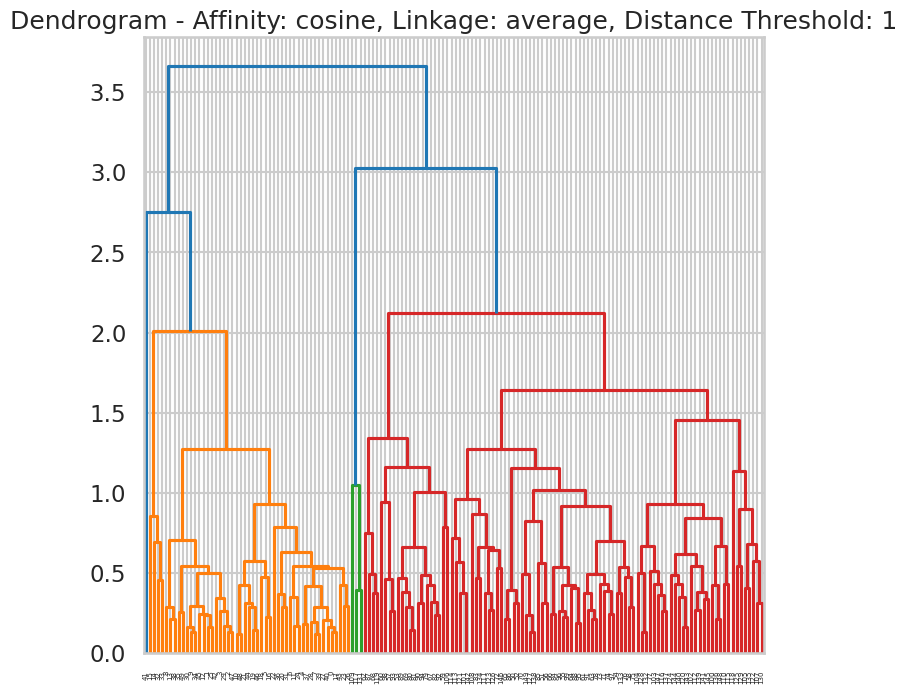

LENGTHHHHHHHHH ::::::::::::::::: 2


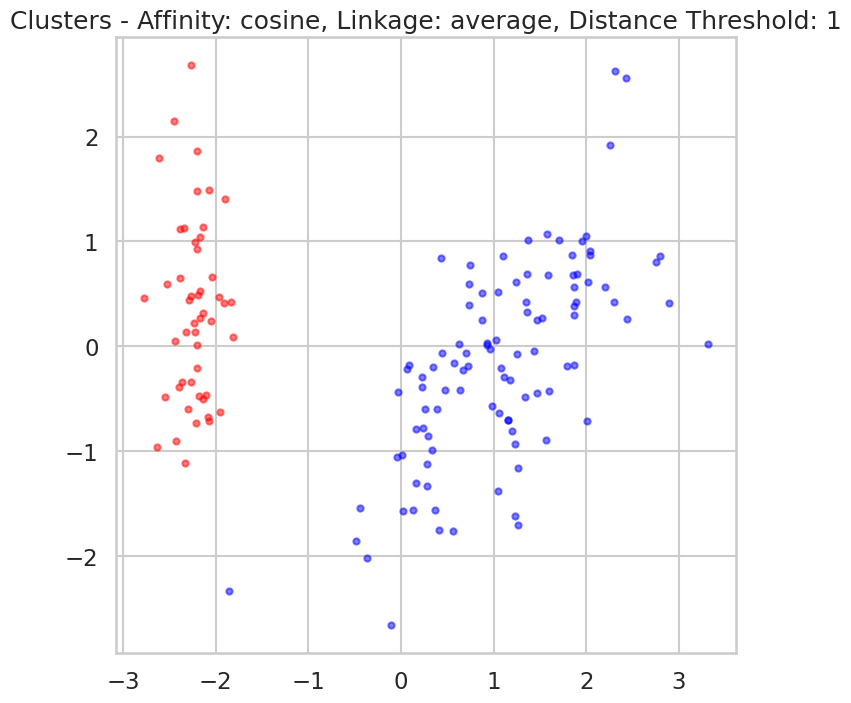

Silhouette Score - Affinity: cosine, Linkage: average, Distance Threshold: 1: 0.5770346019475988
Only one cluster created - Affinity: cosine, Linkage: average, Distance Threshold: 2. Skipping...
Only one cluster created - Affinity: cosine, Linkage: average, Distance Threshold: 4. Skipping...
Only one cluster created - Affinity: cosine, Linkage: single, Distance Threshold: 1. Skipping...
Only one cluster created - Affinity: cosine, Linkage: single, Distance Threshold: 2. Skipping...
Only one cluster created - Affinity: cosine, Linkage: single, Distance Threshold: 4. Skipping...

Best parameters: {'affinity': 'manhattan', 'linkage': 'average', 'distance_threshold': 4}
Best silhouette score: 0.5817500491982808


In [ ]:
from scipy.cluster.hierarchy import dendrogram
from sklearn.cluster import AgglomerativeClustering
import seaborn as sns
from scipy.cluster.hierarchy import dendrogram, linkage
import scipy


# Helper function to display clusters
def display_cluster(X, labels):
    pca = PCA(n_components=2)
    X_pca = pca.fit_transform(X)
    color = ['b', 'r', 'g', 'c', 'm', 'y', 'k', 'violet', 'aqua', 'pink', 'violet','grey', 'coral', 'brown']  # List of colors
    alpha = 0.5  # Color opacity
    s = 20
    print('LENGTHHHHHHHHH :::::::::::::::::',len(np.unique(labels)))
    for i in range(len(np.unique(labels))):
        plt.scatter(X_pca[labels == i, 0], X_pca[labels == i, 1], c=colors[i], alpha=alpha, s=s)



# Define parameter values to try
affinities = ['euclidean', 'manhattan', 'cosine']
linkages = ['average', 'single']
distance_thresholds = [1, 2, 4]

best_score = -1
best_params = {}

# Iterate over different parameter combinations
for affinity in affinities:
    for linkage in linkages:
        for distance_threshold in distance_thresholds:
            n_clusters = None
            model = AgglomerativeClustering(n_clusters=n_clusters, affinity=affinity, linkage=linkage, distance_threshold=distance_threshold)
            labels = model.fit_predict(iris_data_normalized)
            if len(np.unique(labels)) > 1:
                score = silhouette_score(iris_data_normalized, labels)

                # Display dendrogram
                Z = scipy.cluster.hierarchy.linkage(iris_data_normalized, method=linkage)
                plt.figure()
                plt.title(f'Dendrogram - Affinity: {affinity}, Linkage: {linkage}, Distance Threshold: {distance_threshold}')
                dendrogram(Z)
                plt.show()

                # Display resulting clusters
                plt.figure()
                plt.title(f'Clusters - Affinity: {affinity}, Linkage: {linkage}, Distance Threshold: {distance_threshold}')
                display_cluster(iris_data_normalized, labels)
                plt.show()

                print(f'Silhouette Score - Affinity: {affinity}, Linkage: {linkage}, Distance Threshold: {distance_threshold}: {score}')

                # Update best score and parameters if current score is better
                if score > best_score:
                    best_score = score
                    best_params['affinity'] = affinity
                    best_params['linkage'] = linkage
                    best_params['distance_threshold'] = distance_threshold
            else:
                print(f'Only one cluster created - Affinity: {affinity}, Linkage: {linkage}, Distance Threshold: {distance_threshold}. Skipping...')
                # best_params['distance_threshold'] = distance_threshold

# Print best parameters and score
print("\nBest parameters:", best_params)
print("Best silhouette score:", best_score)


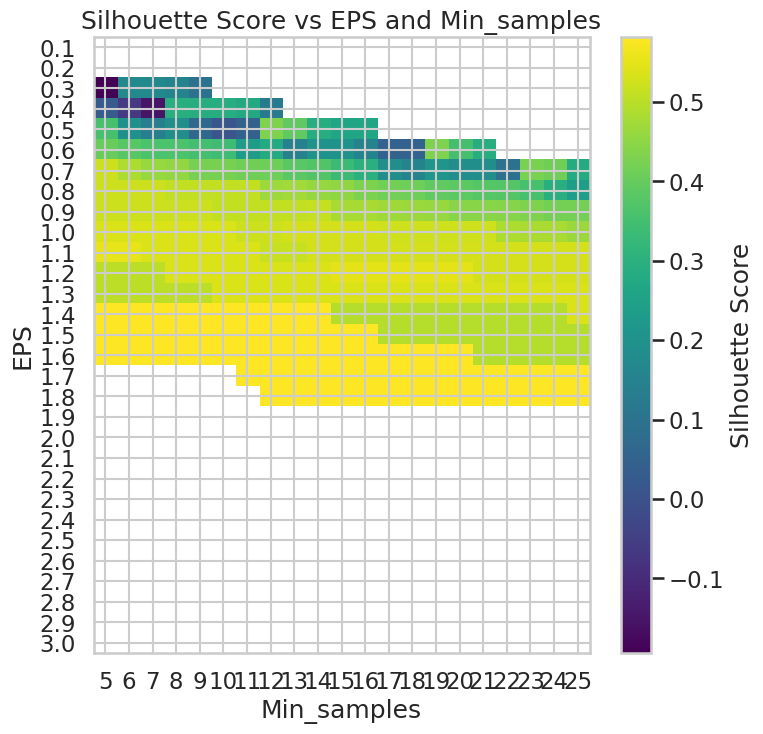


Best parameters: {'EPS': 1.4, 'Min_samples': 5}
Best silhouette score: 0.5817500491982808


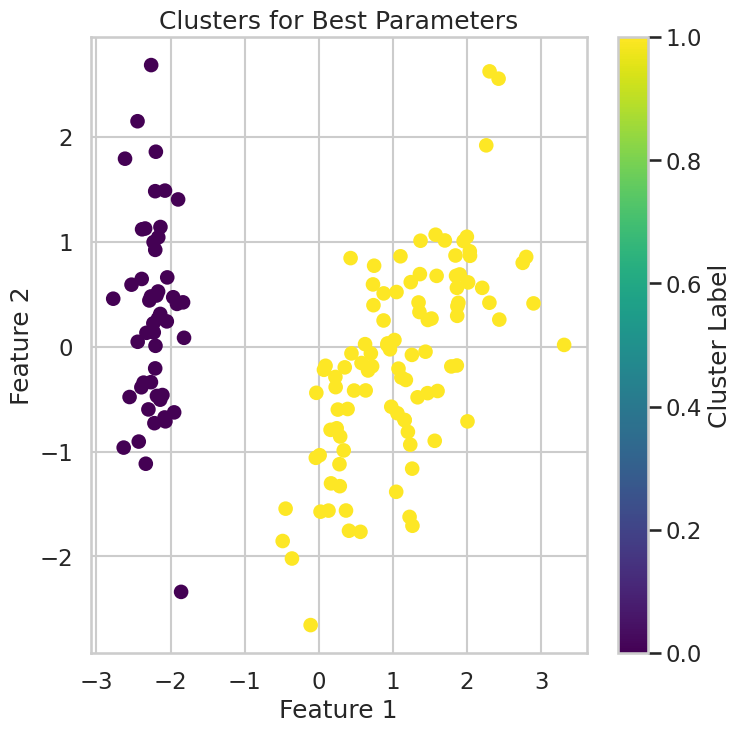

In [ ]:
# Define parameter values to try
EPS_values = np.linspace(0.1, 3, 30)
Min_samples_values = np.arange(5, 26)

best_score = -1
best_params = {}

# Iterate over different parameter combinations
for EPS in EPS_values:
    for Min_samples in Min_samples_values:
        model = DBSCAN(eps=EPS, min_samples=Min_samples)
        labels = model.fit_predict(iris_data_normalized)

        # Exclude outliers (-1) from silhouette score calculation
        if len(np.unique(labels)) > 1:
            score = silhouette_score(iris_data_normalized, labels)
            # Update best score and parameters if current score is better
            if score > best_score:
                best_score = score
                best_params['EPS'] = EPS
                best_params['Min_samples'] = Min_samples

# Plot silhouette score versus EPS and Min_samples
scores = np.zeros((len(EPS_values), len(Min_samples_values)))
for i, EPS in enumerate(EPS_values):
    for j, Min_samples in enumerate(Min_samples_values):
        model = DBSCAN(eps=EPS, min_samples=Min_samples)
        labels = model.fit_predict(iris_data_normalized)
        if len(np.unique(labels)) > 1:
            scores[i, j] = silhouette_score(iris_data_normalized, labels)
        else:
            scores[i, j] = np.nan

plt.figure()
plt.imshow(scores, interpolation='nearest', cmap='viridis', aspect='auto')
plt.colorbar(label='Silhouette Score')
plt.xticks(np.arange(len(Min_samples_values)), Min_samples_values)
plt.xlabel('Min_samples')
plt.yticks(np.arange(len(EPS_values)), np.round(EPS_values, 2))
plt.ylabel('EPS')
plt.title('Silhouette Score vs EPS and Min_samples')
plt.show()

# Print best parameters and score
print("\nBest parameters:", best_params)
print("Best silhouette score:", best_score)
best_model = DBSCAN(eps=best_params['EPS'], min_samples=best_params['Min_samples'])
best_labels = best_model.fit_predict(iris_data_normalized)

pca = PCA(n_components=2)
X_pca = pca.fit_transform(iris_data_normalized)
plt.figure()
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=best_model.labels_, cmap='viridis')
plt.title('Clusters for Best Parameters')
plt.xlabel('Feature 1')
plt.ylabel('Feature 2')
plt.colorbar(label='Cluster Label')
plt.show()


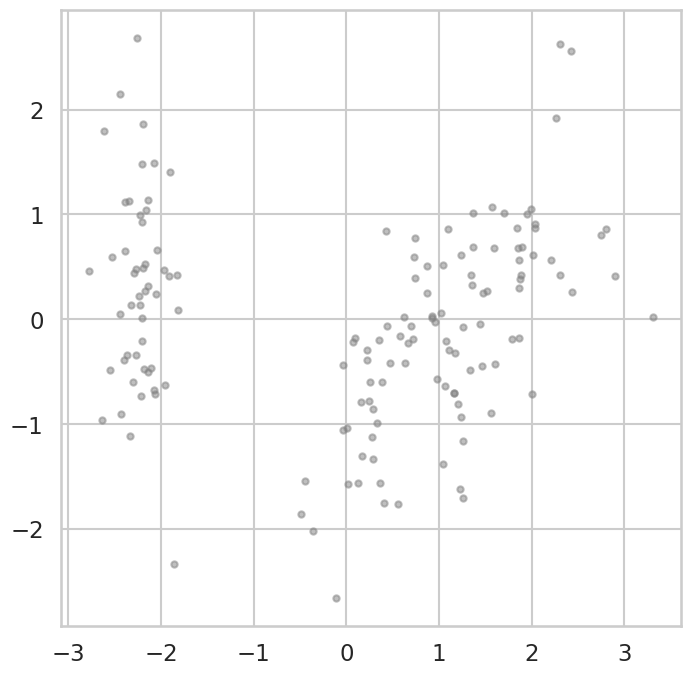

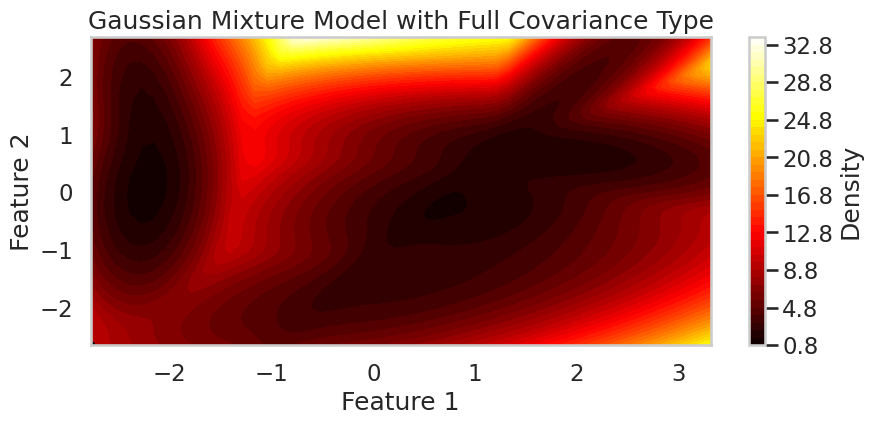

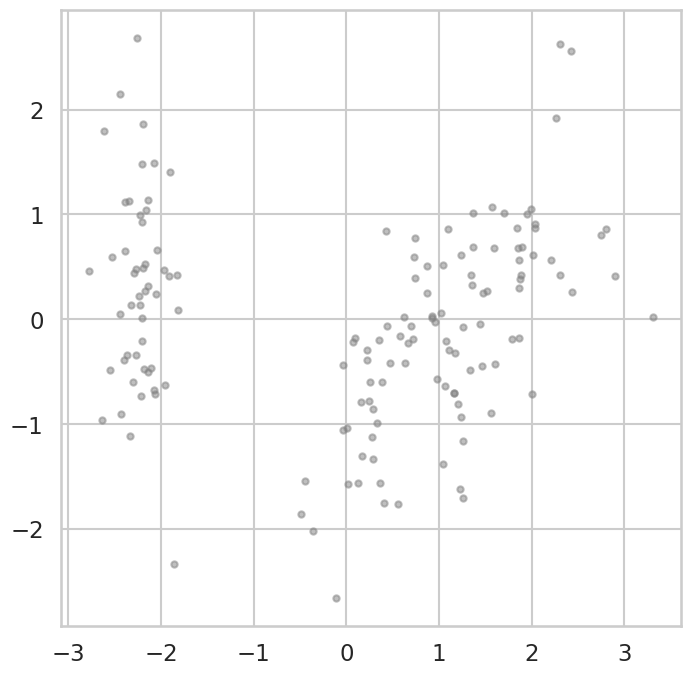

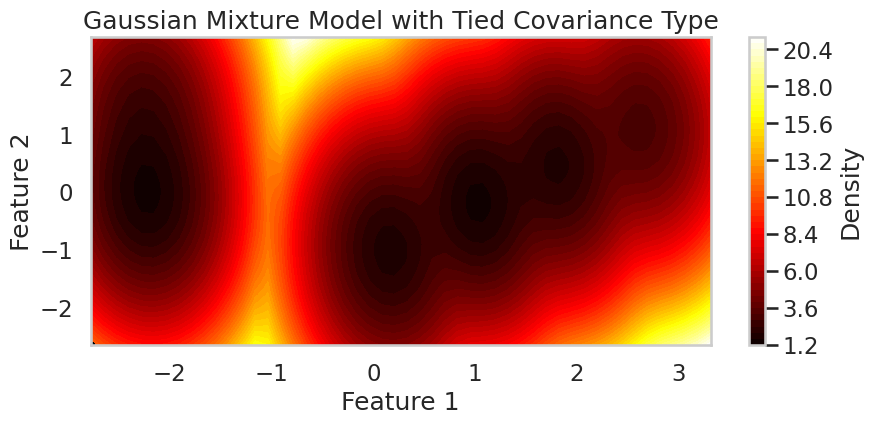

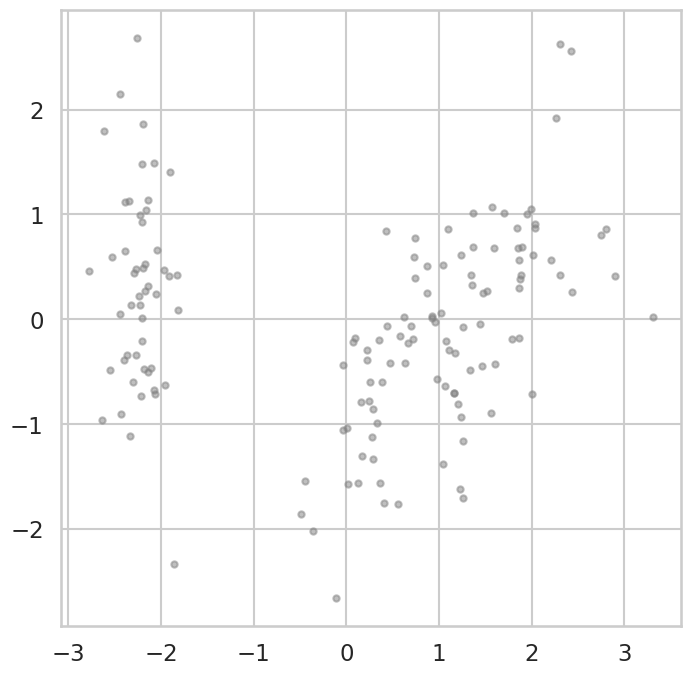

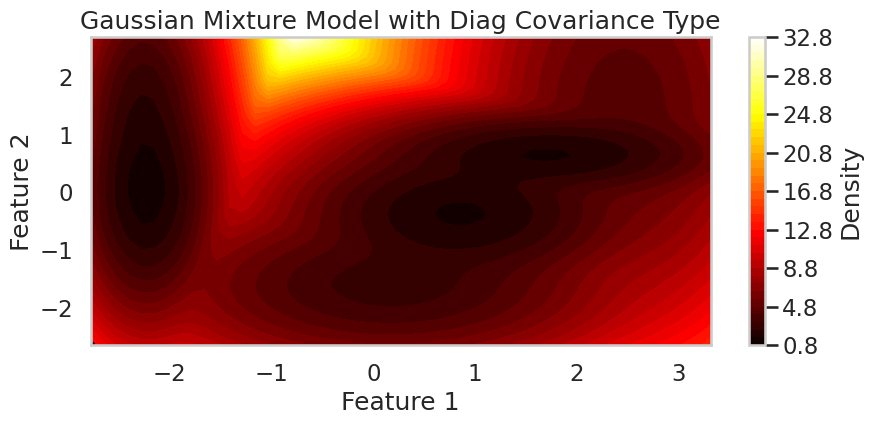

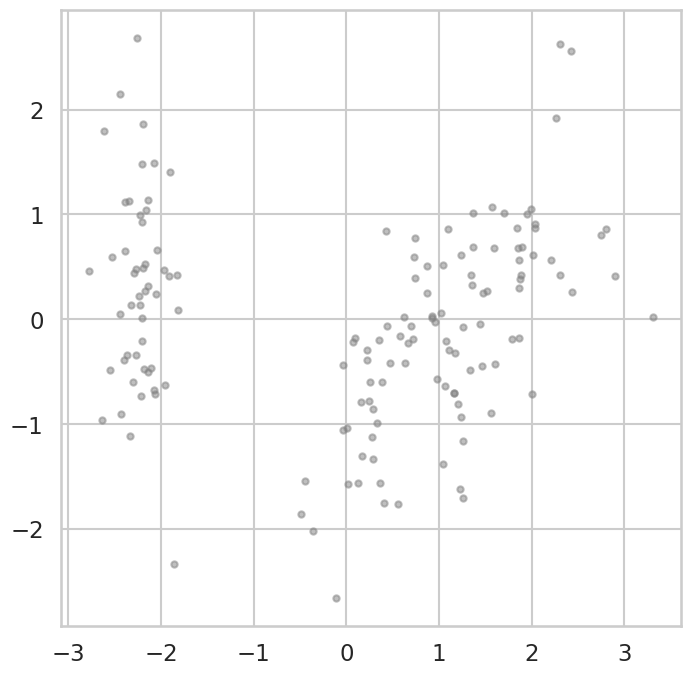

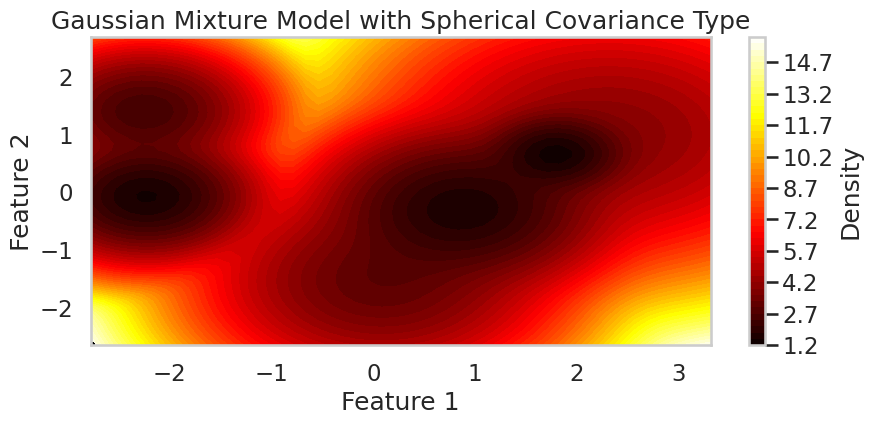

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.datasets import load_iris
from sklearn.mixture import GaussianMixture
import seaborn as sns


# Define covariance types to try
covariance_types = ['full', 'tied', 'diag', 'spherical']

# Plot all features against each other in pairs
# sns.pairplot(sns.load_dataset("iris"), diag_kind='kde', markers='.')
# plt.suptitle('Pairplot of Iris Dataset', y=1.02)
# plt.show()

# Fit Gaussian mixture models with different covariance types
for cov_type in covariance_types:
    pca = PCA(n_components=2)
    X_pca = pca.fit_transform(iris_data_normalized)
    plt.figure()
    plt.scatter(X_pca[:, 0], X_pca[:, 1], marker='.', color='gray', alpha=0.5, label='Data')
    gmm = GaussianMixture(n_components=6, covariance_type=cov_type, random_state=42)
    gmm.fit(X_pca[:, :2])  # Use only the first two features for visualization
    x = np.linspace(X_pca[:, 0].min(), X_pca[:, 0].max())
    y = np.linspace(X_pca[:, 1].min(), X_pca[:, 1].max())
    X, Y = np.meshgrid(x, y)
    XX = np.array([X.ravel(), Y.ravel()]).T
    Z = -gmm.score_samples(XX)
    Z = Z.reshape(X.shape)
    plt.figure(figsize=(10, 4))
    plt.contourf(X, Y, Z, cmap='hot', levels=50)  # 'hot' colormap for heatmap-like colors
    plt.colorbar(label='Density')
    plt.xlim(X.min(), X.max())
    plt.ylim(Y.min(), Y.max())
    plt.scatter(X[:, 0], X[:, 1], s=10, color='black')  # Scatter plot of the data points
    plt.title(f'Gaussian Mixture Model with {cov_type.capitalize()} Covariance Type')
    plt.xlabel('Feature 1')
    plt.ylabel('Feature 2')
    plt.show()
    # CS = plt.contour(X, Y, Z, levels=10, linewidths=1, alpha=0.5, label=cov_type)
    # plt.colorbar(CS, shrink=0.8, extend='both')
    # plt.title(f'Gaussian Mixture Model with {cov_type.capitalize()} Covariance Type')
    # plt.xlabel('Feature 0')
    # plt.ylabel('Feature 1')
    # plt.legend()
    # plt.show()


* Repeat all the above clustering approaches and steps on the above data
* Normalize the data then repeat all the above steps
* Compare between the different clustering approaches

## Customer dataset
Repeat all the above on the customer data set

In [ ]:
data_array = np.genfromtxt('/content/Customer data.csv', delimiter=',')
data_array =data_array[1:,1:]

from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()

# Fit and transform the data
data_array_normalized = scaler.fit_transform(data_array)

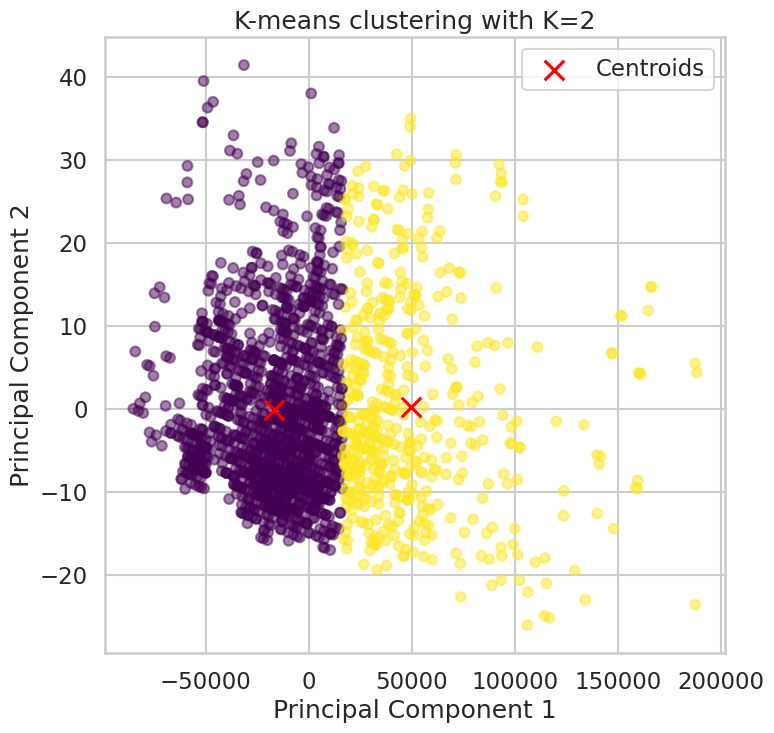

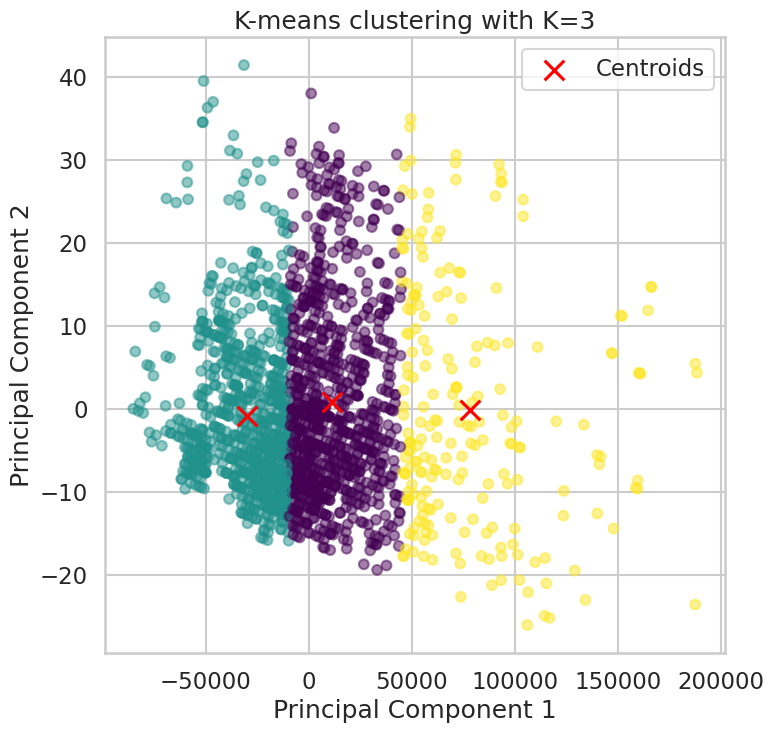

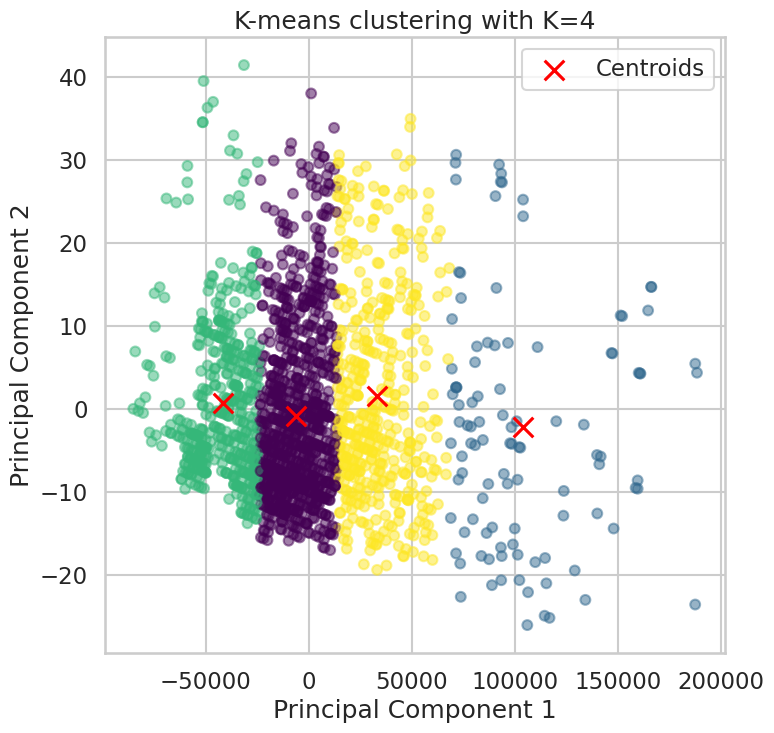

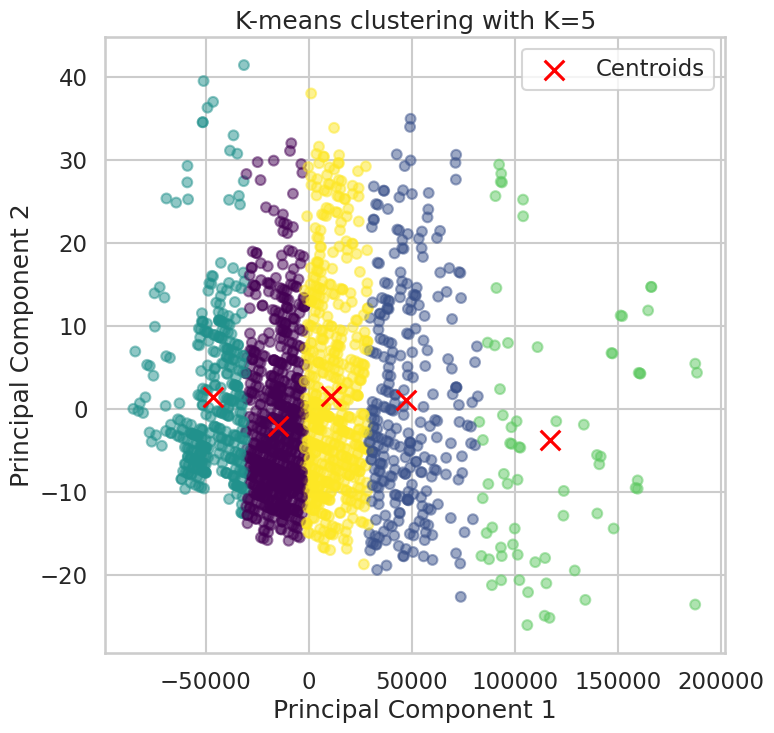

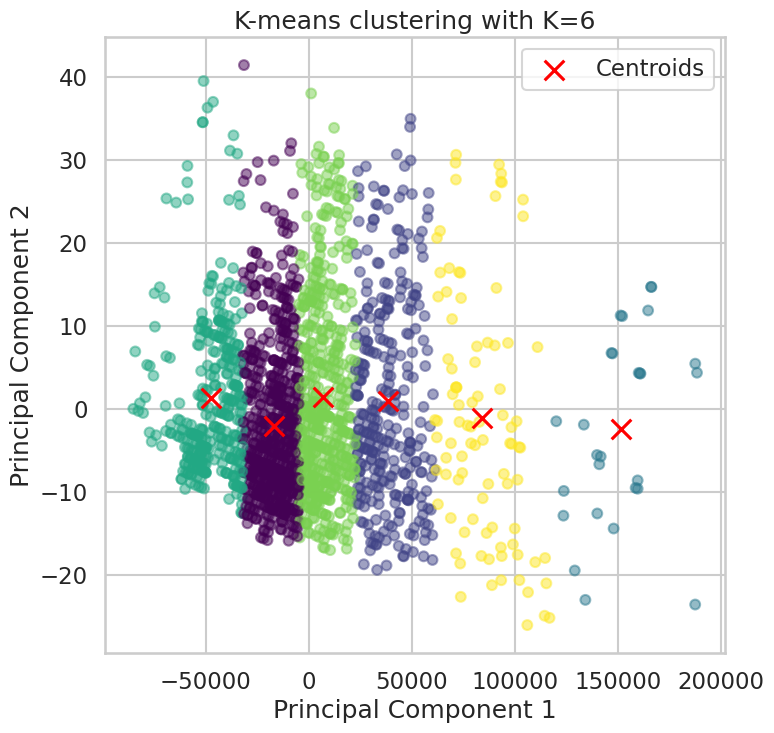

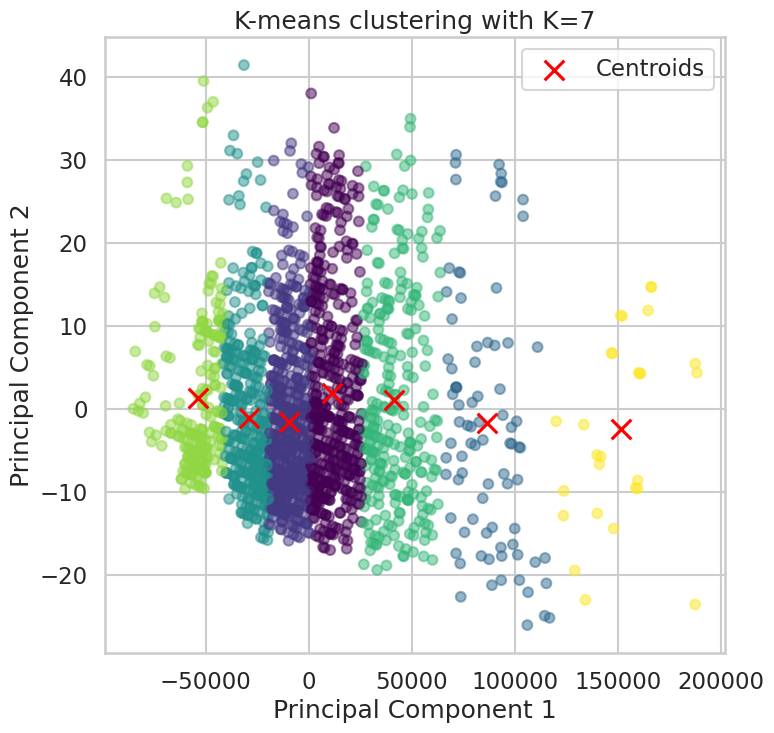

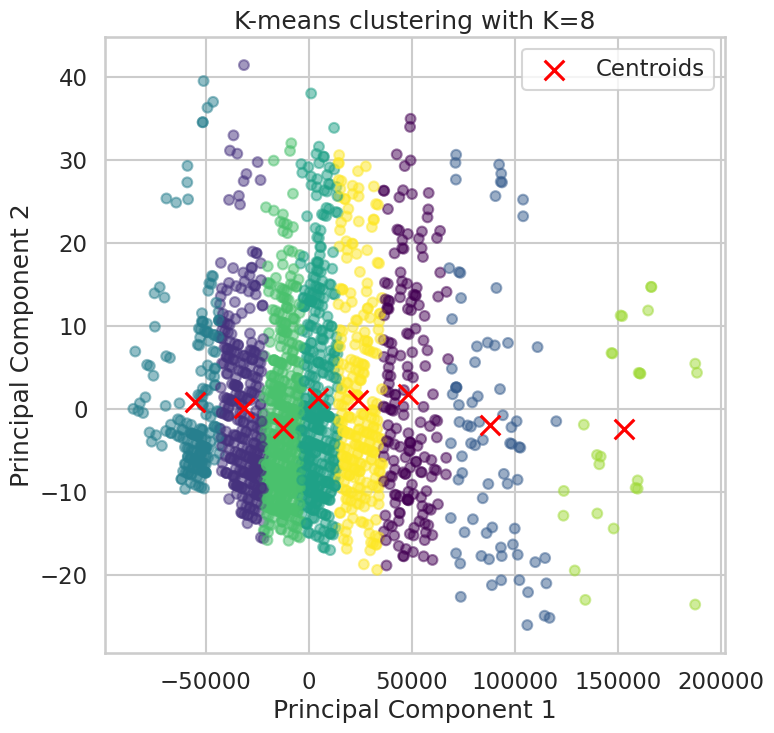

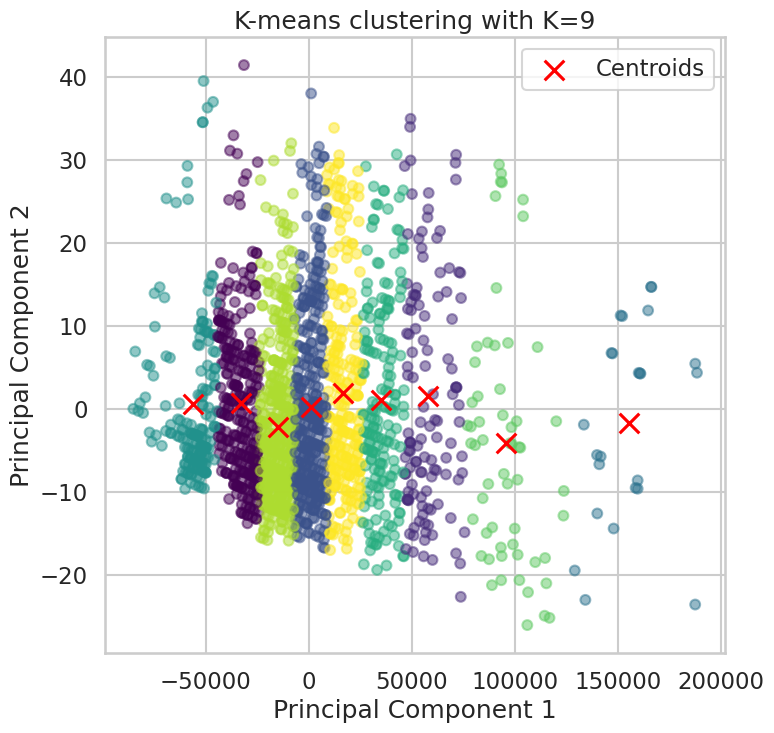

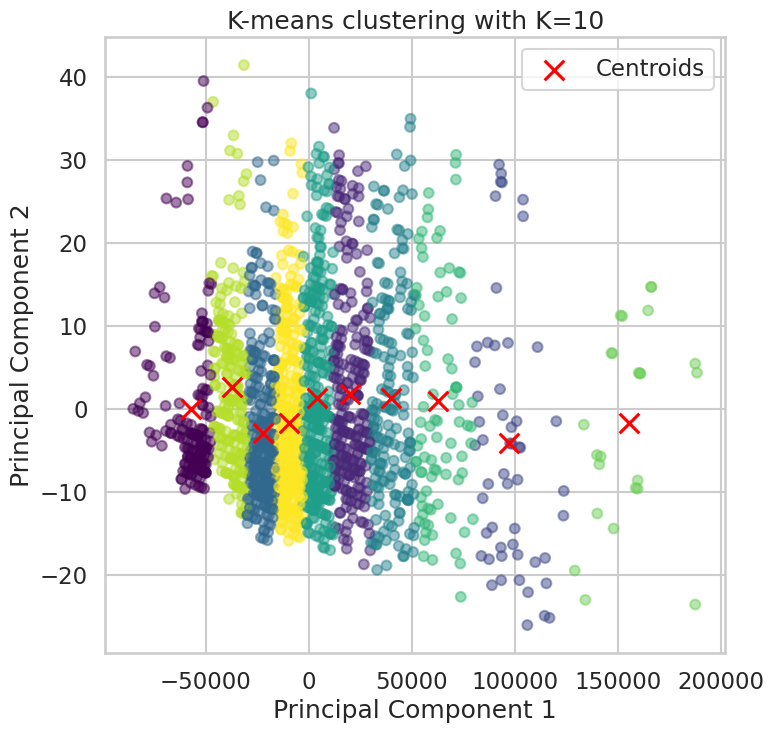

Best value of K based on silhouette score: 2
Best silhouette score: 0.5834469001696239


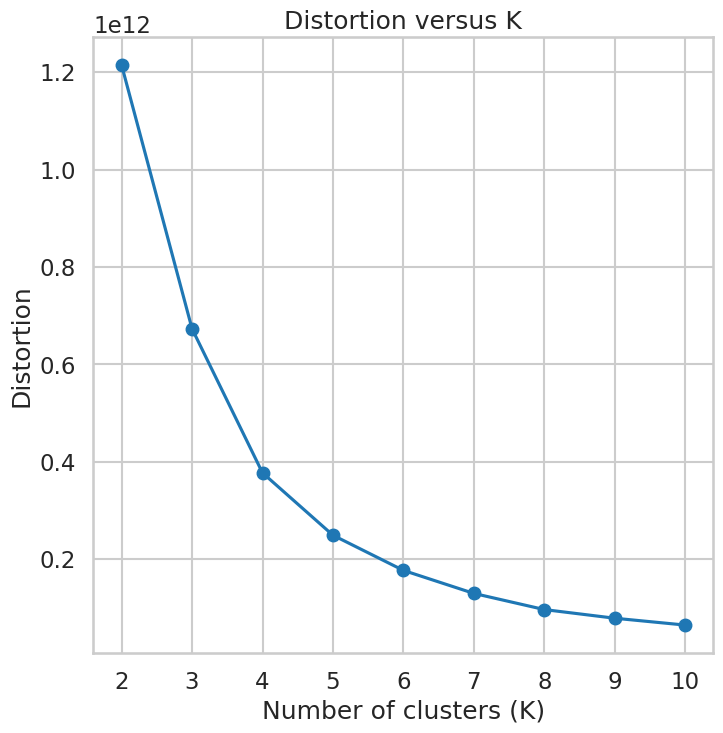

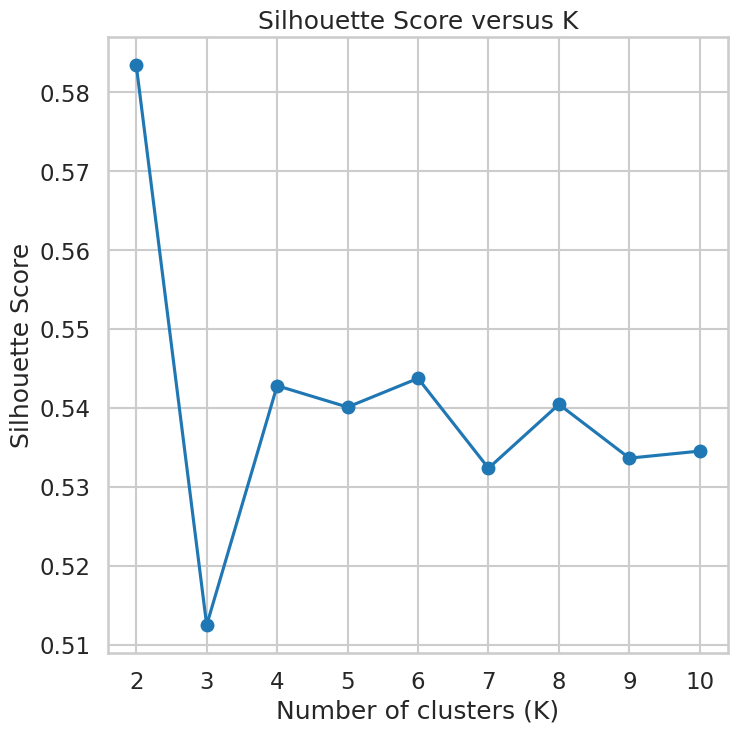

In [ ]:
from sklearn.decomposition import PCA

# Perform K-means clustering with different values of K
K_values = range(2, 11)  # Values of K to try
distortions = []  # List to store distortion values
silhouette_scores = []  # List to store silhouette scores

# Function to display clusters
def display_cluster(X, km, k):
    pca = PCA(n_components=2)
    X_pca = pca.fit_transform(X)
    centroids = pca.transform(km.cluster_centers_)
    plt.scatter(X_pca[:, 0], X_pca[:, 1], c=km.labels_, cmap='viridis', s=50, alpha=0.5)
    plt.scatter(centroids[:, 0], centroids[:, 1], c='red', marker='x', s=200, label='Centroids')
    plt.xlabel('Principal Component 1')
    plt.ylabel('Principal Component 2')
    plt.title('K-means clustering with K={}'.format(k))
    plt.legend()
    plt.show()

for k in K_values:
    km = KMeans(n_clusters=k, random_state=42)
    km.fit(data_array)
    distortions.append(km.inertia_)  # Sum of squared distances to closest cluster center
    silhouette_scores.append(silhouette_score(data_array, km.labels_))  # Silhouette score

    # Display clusters for each value of K
    plt.figure()
    plt.title("K-means clustering with K={}".format(k))
    display_cluster(data_array, km, k)

# Plot distortion function versus K
plt.figure()
plt.plot(K_values, distortions, marker='o')
plt.xlabel('Number of clusters (K)')
plt.ylabel('Distortion')
plt.title('Distortion versus K')

# Plot silhouette score versus K
plt.figure()
plt.plot(K_values, silhouette_scores, marker='o')
plt.xlabel('Number of clusters (K)')
plt.ylabel('Silhouette Score')
plt.title('Silhouette Score versus K')

# Find the best value of K based on silhouette score
best_K = K_values[np.argmax(silhouette_scores)]
print("Best value of K based on silhouette score:", best_K)
print("Best silhouette score:", np.max(silhouette_scores))
plt.show()

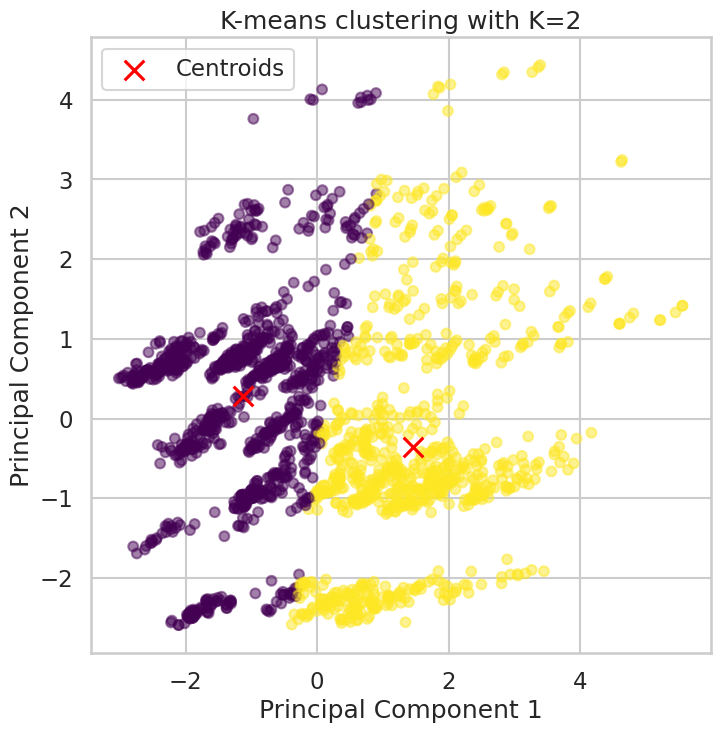

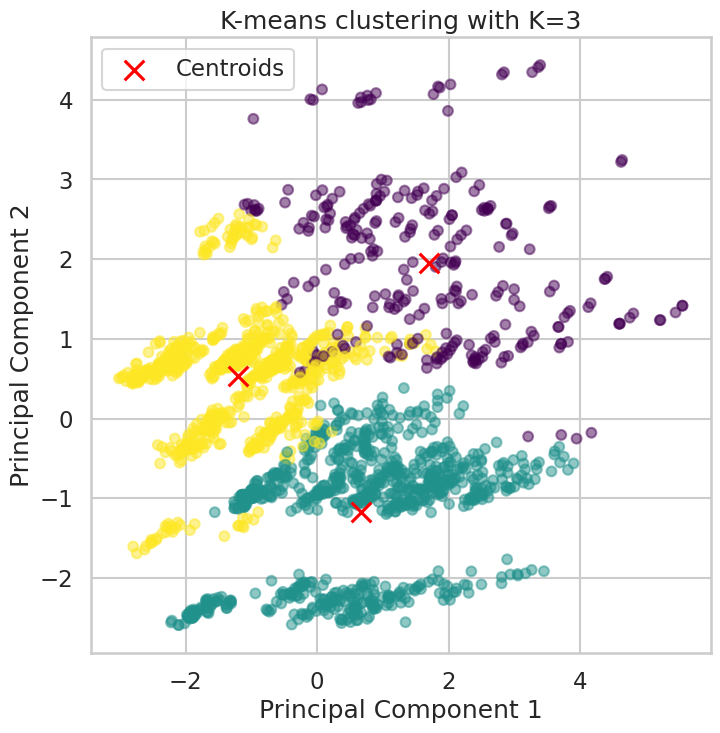

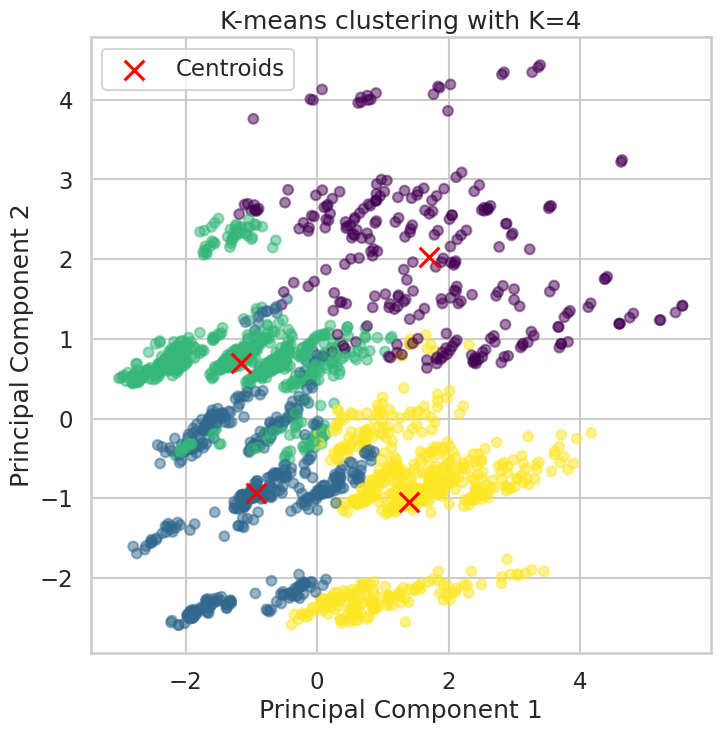

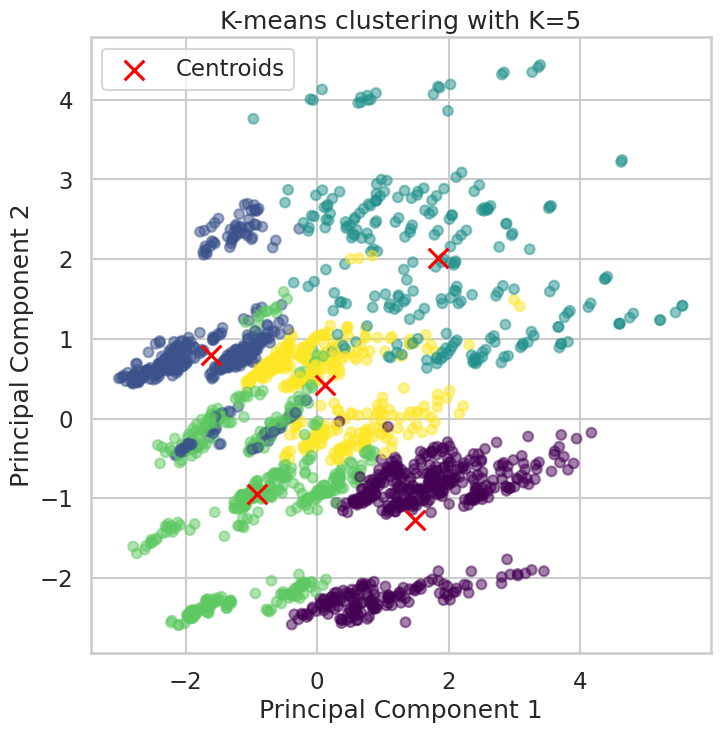

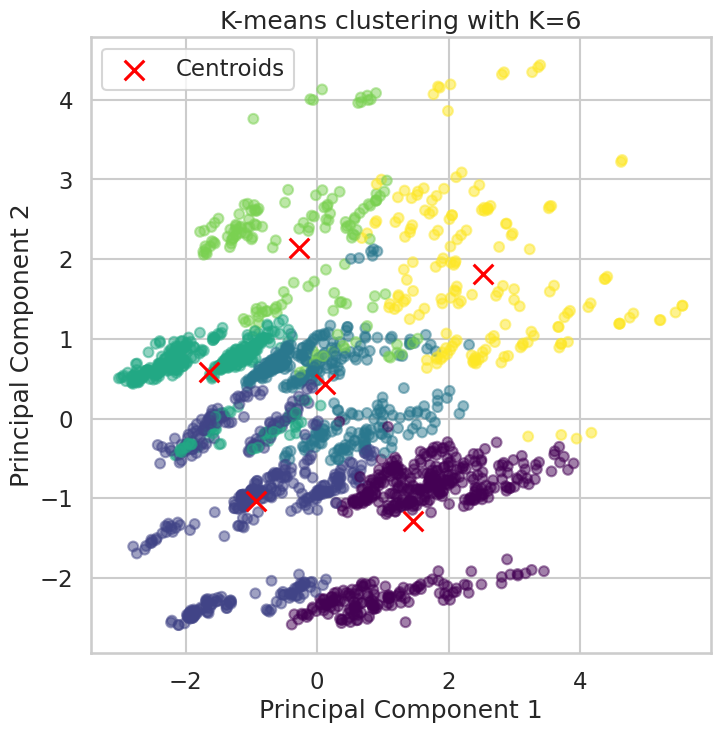

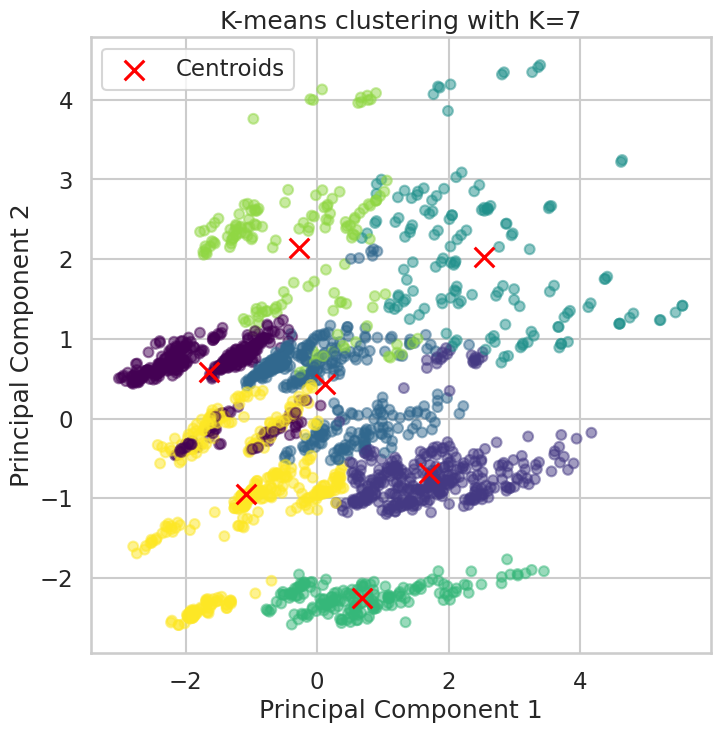

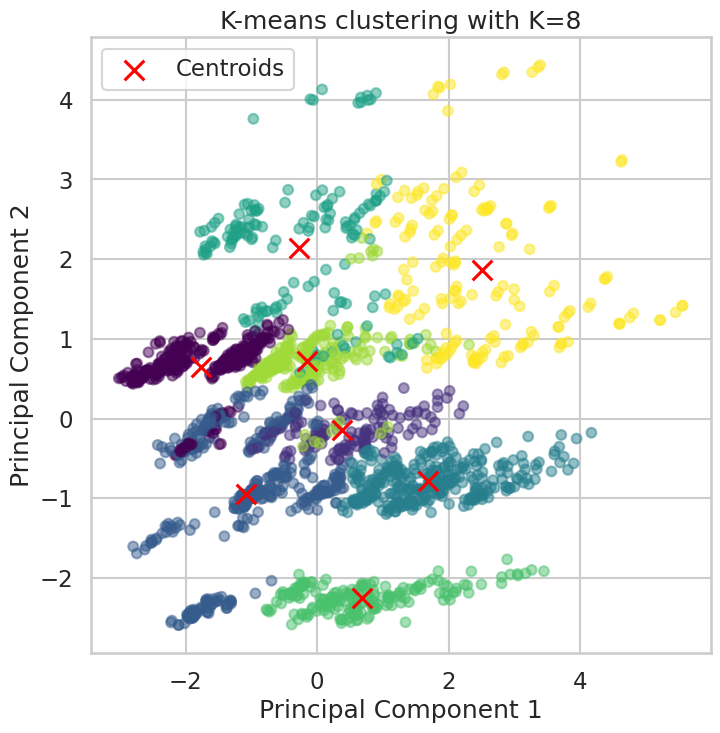

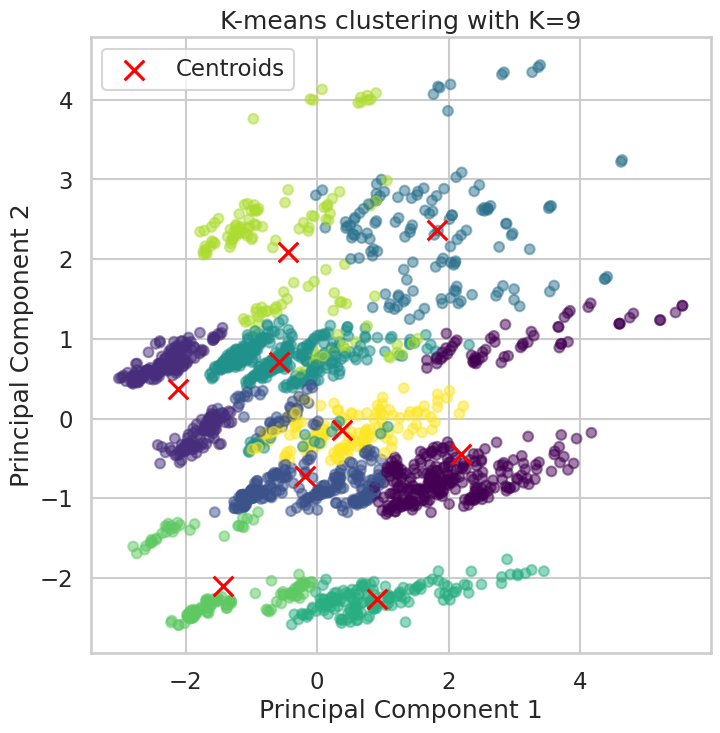

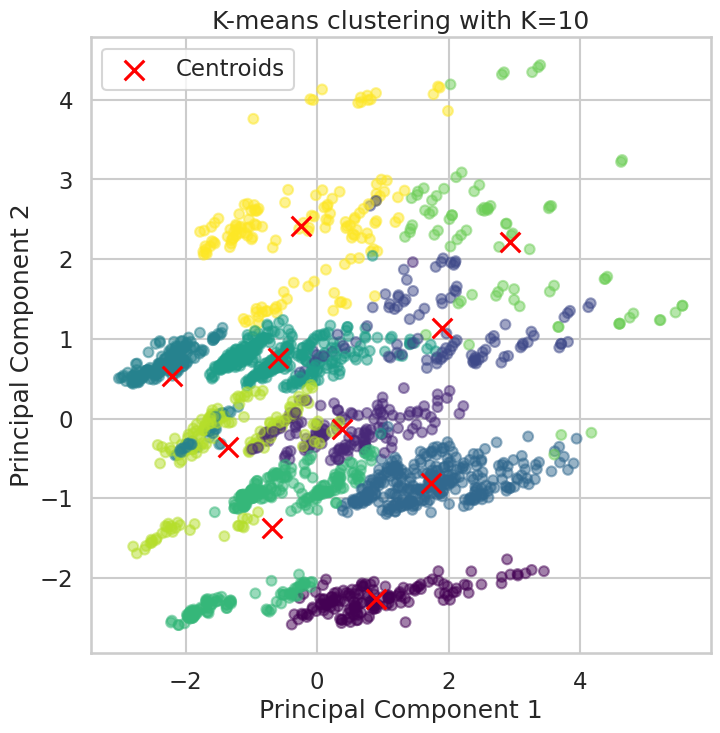

Best value of K based on silhouette score: 10
Best silhouette score: 0.3138853577035059


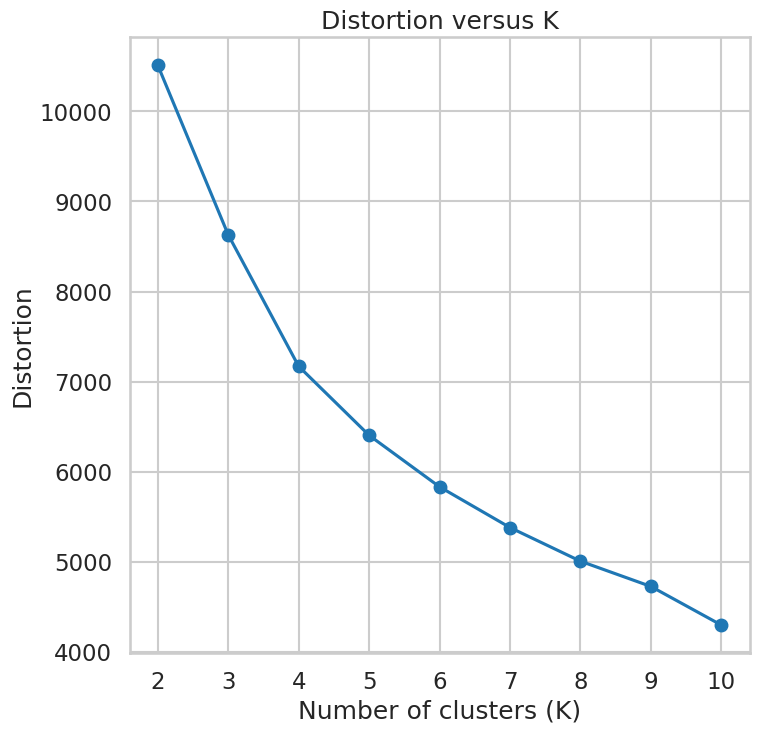

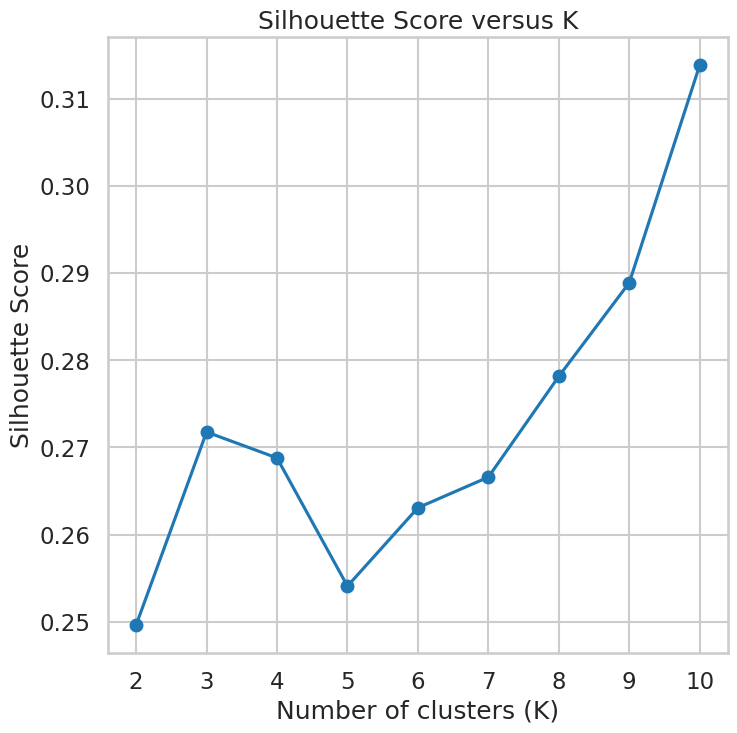

In [ ]:
from sklearn.decomposition import PCA

# Perform K-means clustering with different values of K
K_values = range(2, 11)  # Values of K to try
distortions = []  # List to store distortion values
silhouette_scores = []  # List to store silhouette scores

# Function to display clusters
def display_cluster(X, km, k):
    pca = PCA(n_components=2)
    X_pca = pca.fit_transform(X)
    centroids = pca.transform(km.cluster_centers_)
    plt.scatter(X_pca[:, 0], X_pca[:, 1], c=km.labels_, cmap='viridis', s=50, alpha=0.5)
    plt.scatter(centroids[:, 0], centroids[:, 1], c='red', marker='x', s=200, label='Centroids')
    plt.xlabel('Principal Component 1')
    plt.ylabel('Principal Component 2')
    plt.title('K-means clustering with K={}'.format(k))
    plt.legend()
    plt.show()

for k in K_values:
    km = KMeans(n_clusters=k, random_state=42)
    km.fit(data_array_normalized)
    distortions.append(km.inertia_)  # Sum of squared distances to closest cluster center
    silhouette_scores.append(silhouette_score(data_array_normalized, km.labels_))  # Silhouette score

    # Display clusters for each value of K
    plt.figure()
    plt.title("K-means clustering with K={}".format(k))
    display_cluster(data_array_normalized, km, k)

# Plot distortion function versus K
plt.figure()
plt.plot(K_values, distortions, marker='o')
plt.xlabel('Number of clusters (K)')
plt.ylabel('Distortion')
plt.title('Distortion versus K')

# Plot silhouette score versus K
plt.figure()
plt.plot(K_values, silhouette_scores, marker='o')
plt.xlabel('Number of clusters (K)')
plt.ylabel('Silhouette Score')
plt.title('Silhouette Score versus K')

# Find the best value of K based on silhouette score
best_K = K_values[np.argmax(silhouette_scores)]
print("Best value of K based on silhouette score:", best_K)
print("Best silhouette score:", np.max(silhouette_scores))
plt.show()

In [ ]:
from scipy.cluster.hierarchy import dendrogram
from sklearn.cluster import AgglomerativeClustering
import seaborn as sns
from scipy.cluster.hierarchy import dendrogram, linkage
import scipy


# Helper function to display clusters
def display_cluster(X, labels):
    pca = PCA(n_components=2)
    X_pca = pca.fit_transform(X)
    color = ['b', 'r', 'g', 'c', 'm', 'y', 'k', 'violet', 'aqua', 'pink', 'violet','grey', 'coral', 'brown']  # List of colors
    alpha = 0.5  # Color opacity
    s = 20
    print('LENGTHHHHHHHHH :::::::::::::::::',len(np.unique(labels)))
    for i in range(len(np.unique(labels))):
        plt.scatter(X_pca[labels == i, 0], X_pca[labels == i, 1], c=colors[i], alpha=alpha, s=s)



# Define parameter values to try
affinities = ['euclidean', 'manhattan', 'cosine']
linkages = ['average', 'single']
distance_thresholds = [1, 2, 4]

best_score = -1
best_params = {}

# Iterate over different parameter combinations
for affinity in affinities:
    for linkage in linkages:
        for distance_threshold in distance_thresholds:
            n_clusters = None
            model = AgglomerativeClustering(n_clusters=n_clusters, affinity=affinity, linkage=linkage, distance_threshold=distance_threshold)
            labels = model.fit_predict(data_array)
            if len(np.unique(labels)) > 1:
                score = silhouette_score(data_array, labels)

                # Display dendrogram
                Z = scipy.cluster.hierarchy.linkage(data_array, method=linkage)
                plt.figure()
                plt.title(f'Dendrogram - Affinity: {affinity}, Linkage: {linkage}, Distance Threshold: {distance_threshold}')
                dendrogram(Z)
                plt.show()

                # Display resulting clusters
                plt.figure()
                plt.title(f'Clusters - Affinity: {affinity}, Linkage: {linkage}, Distance Threshold: {distance_threshold}')
                display_cluster(data_array, labels)
                plt.show()

                print(f'Silhouette Score - Affinity: {affinity}, Linkage: {linkage}, Distance Threshold: {distance_threshold}: {score}')

                # Update best score and parameters if current score is better
                if score > best_score:
                    best_score = score
                    best_params['affinity'] = affinity
                    best_params['linkage'] = linkage
                    best_params['distance_threshold'] = distance_threshold
            else:
                print(f'Only one cluster created - Affinity: {affinity}, Linkage: {linkage}, Distance Threshold: {distance_threshold}. Skipping...')
                best_params['distance_threshold'] = distance_threshold

# Print best parameters and score
print("\nBest parameters:", best_params)
print("Best silhouette score:", best_score)


ValueError: Number of labels is 2000. Valid values are 2 to n_samples - 1 (inclusive)

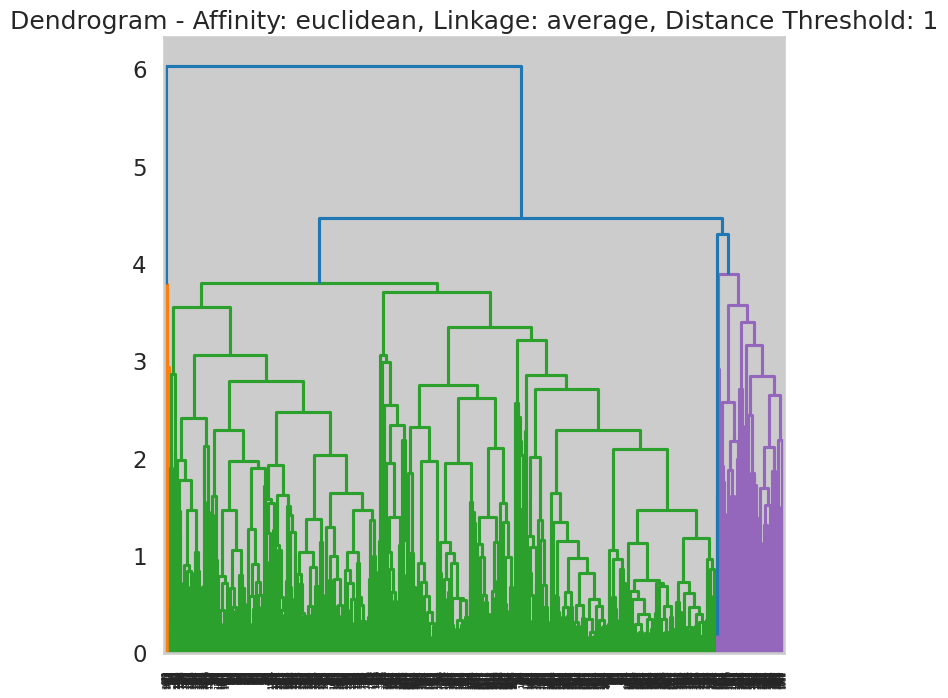

LENGTHHHHHHHHH ::::::::::::::::: 187


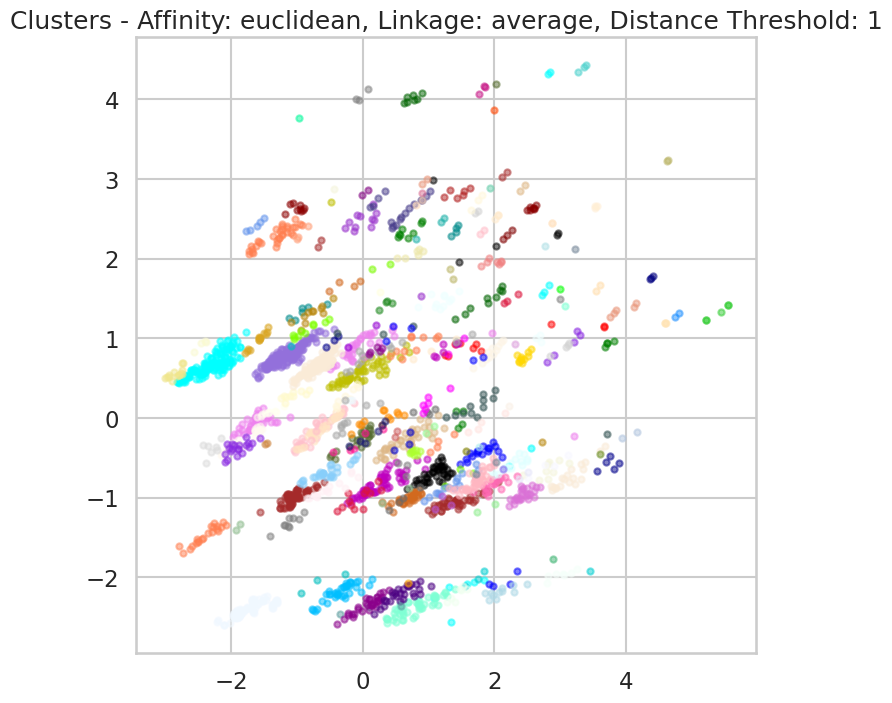

Silhouette Score - Affinity: euclidean, Linkage: average, Distance Threshold: 1: 0.4554103873486009


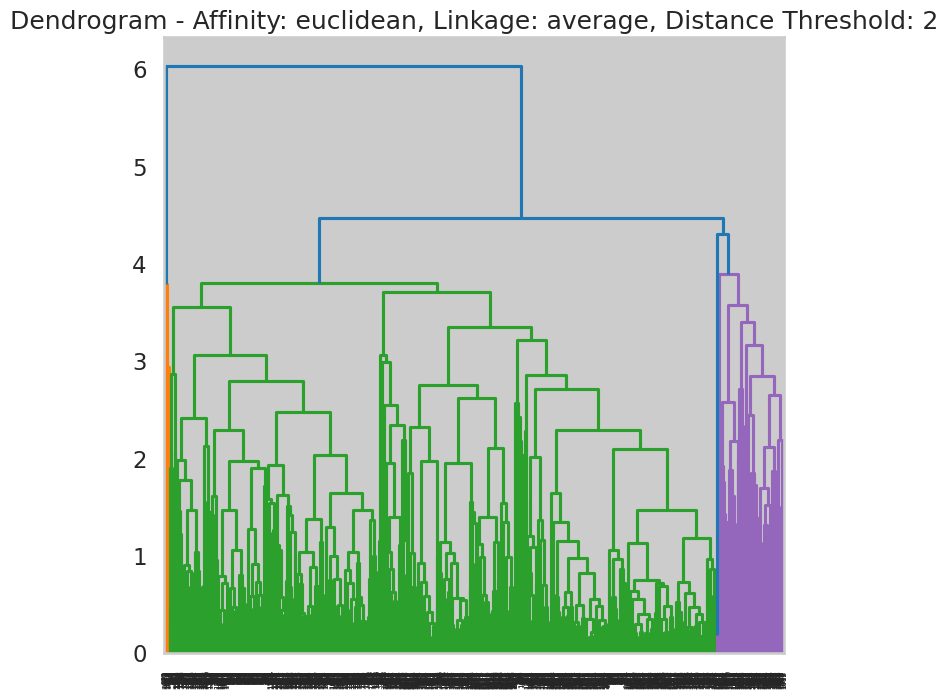

LENGTHHHHHHHHH ::::::::::::::::: 58


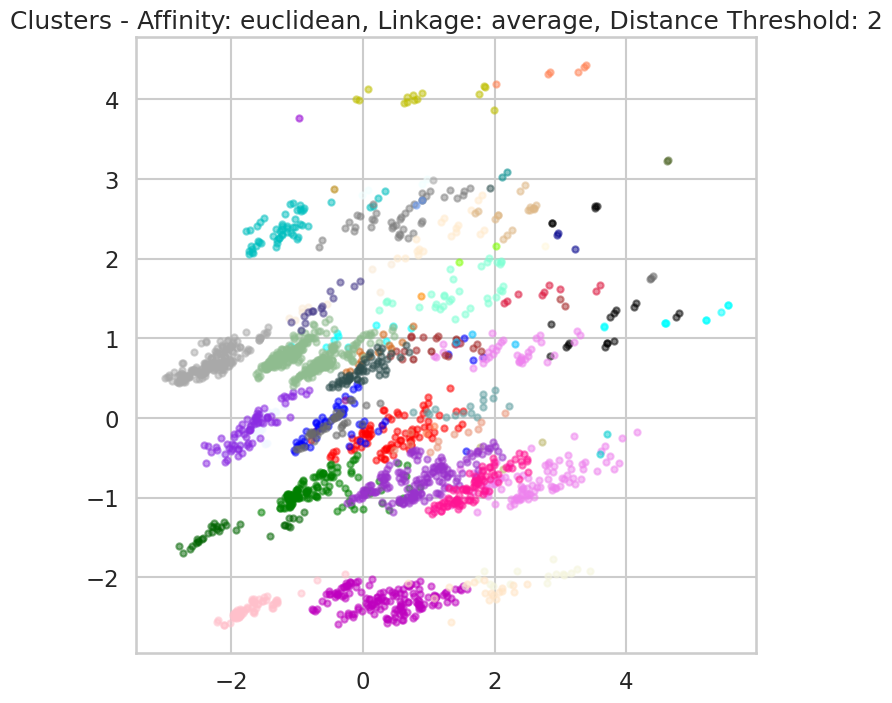

Silhouette Score - Affinity: euclidean, Linkage: average, Distance Threshold: 2: 0.40107597037040665


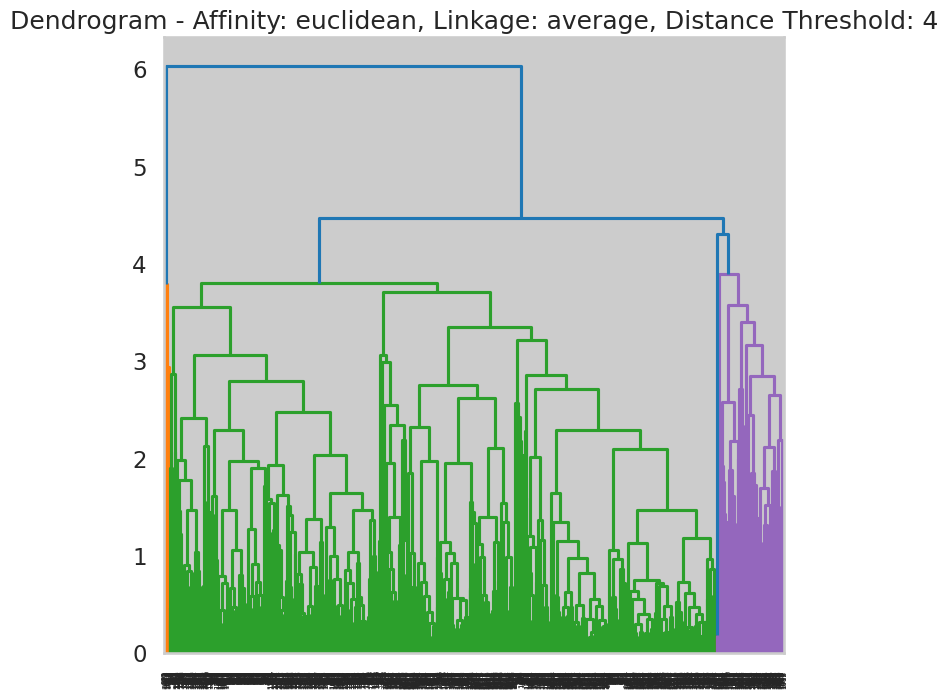

LENGTHHHHHHHHH ::::::::::::::::: 4


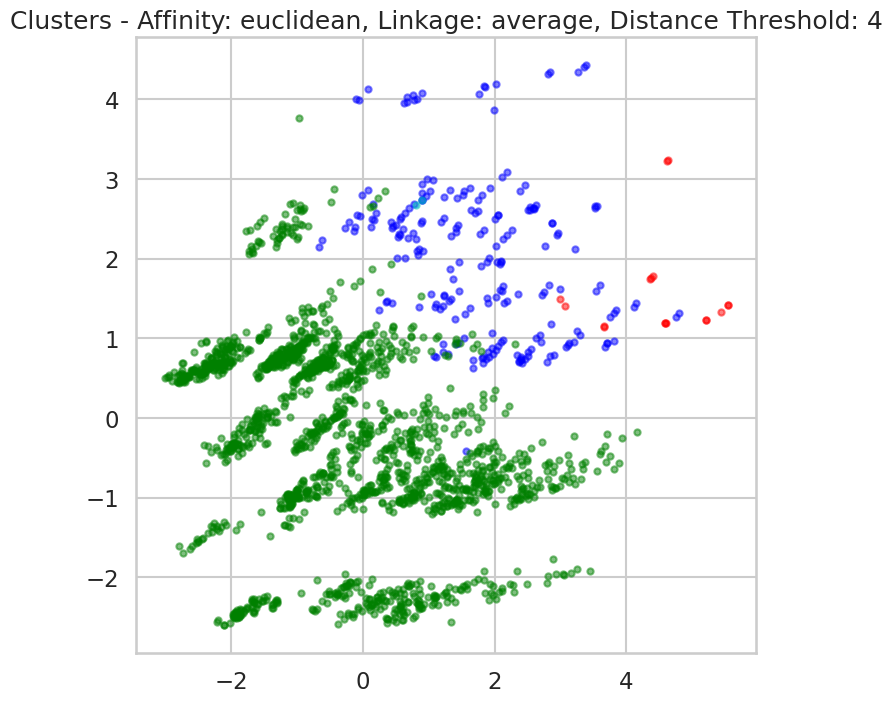

Silhouette Score - Affinity: euclidean, Linkage: average, Distance Threshold: 4: 0.24621026669418214


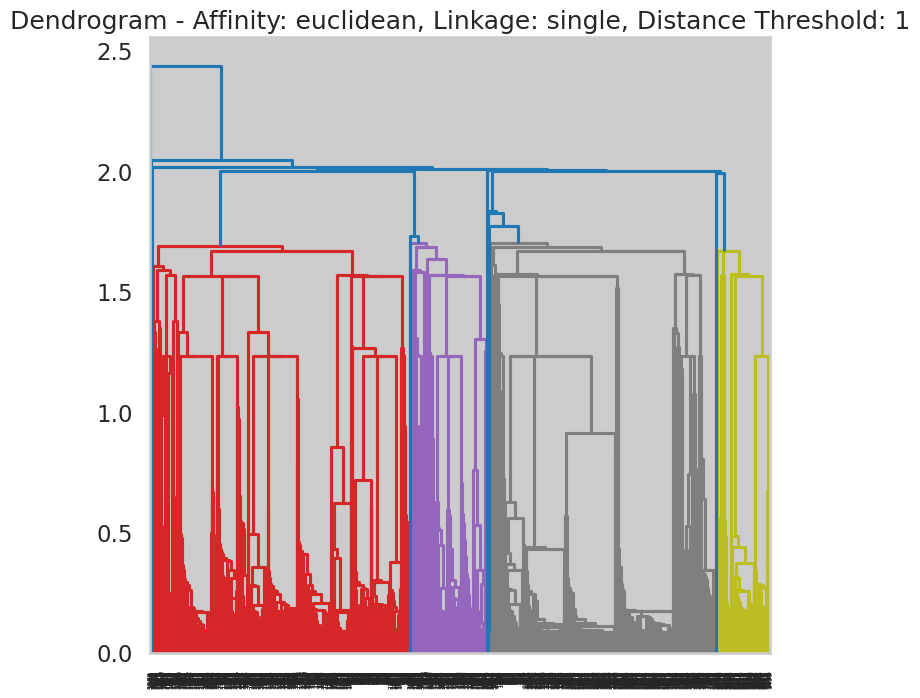

LENGTHHHHHHHHH ::::::::::::::::: 114


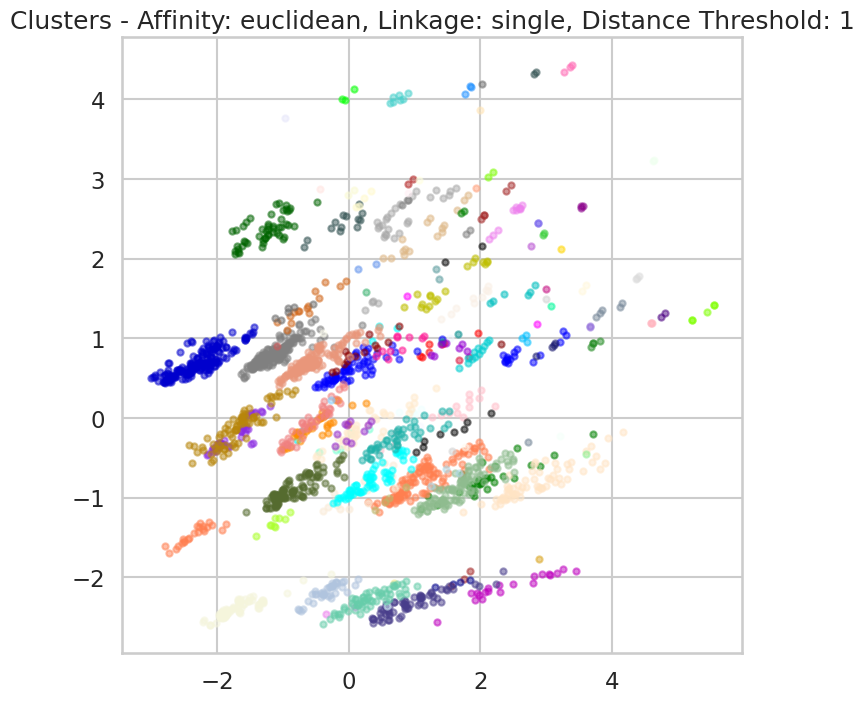

Silhouette Score - Affinity: euclidean, Linkage: single, Distance Threshold: 1: 0.4659514420616944


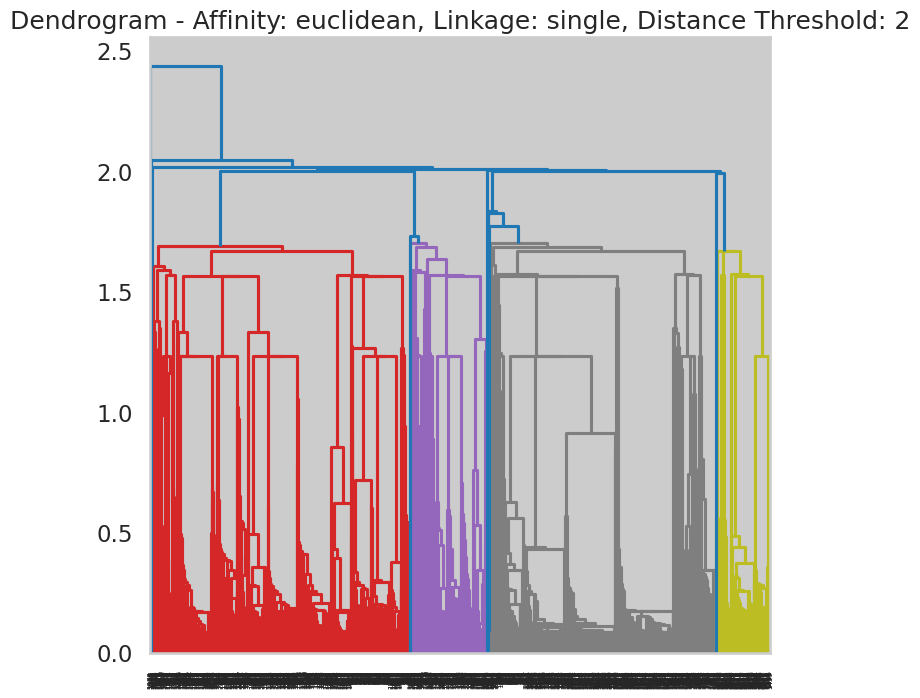

LENGTHHHHHHHHH ::::::::::::::::: 8


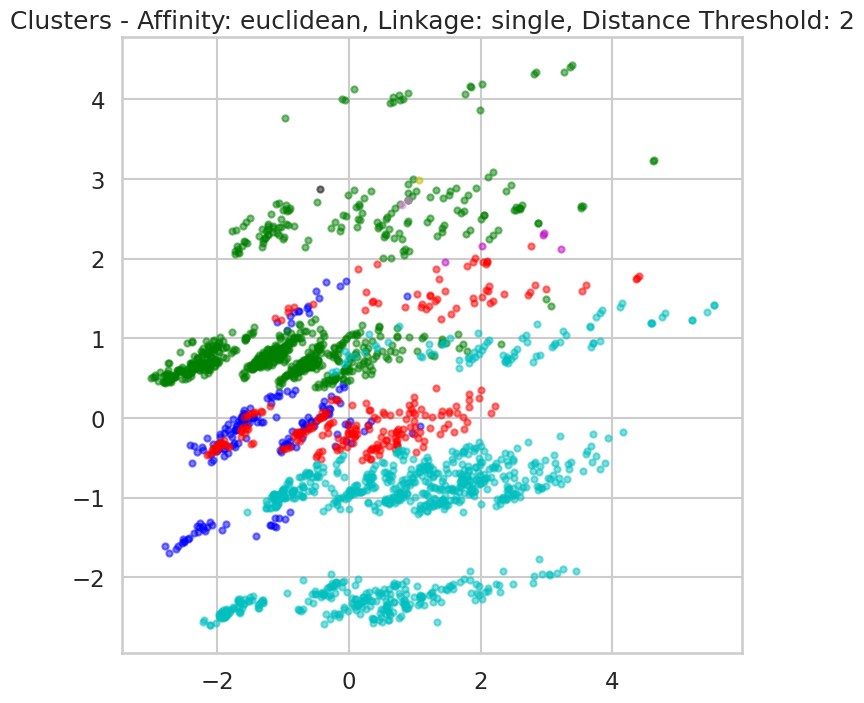

Silhouette Score - Affinity: euclidean, Linkage: single, Distance Threshold: 2: 0.15033454446230707
Only one cluster created - Affinity: euclidean, Linkage: single, Distance Threshold: 4. Skipping...


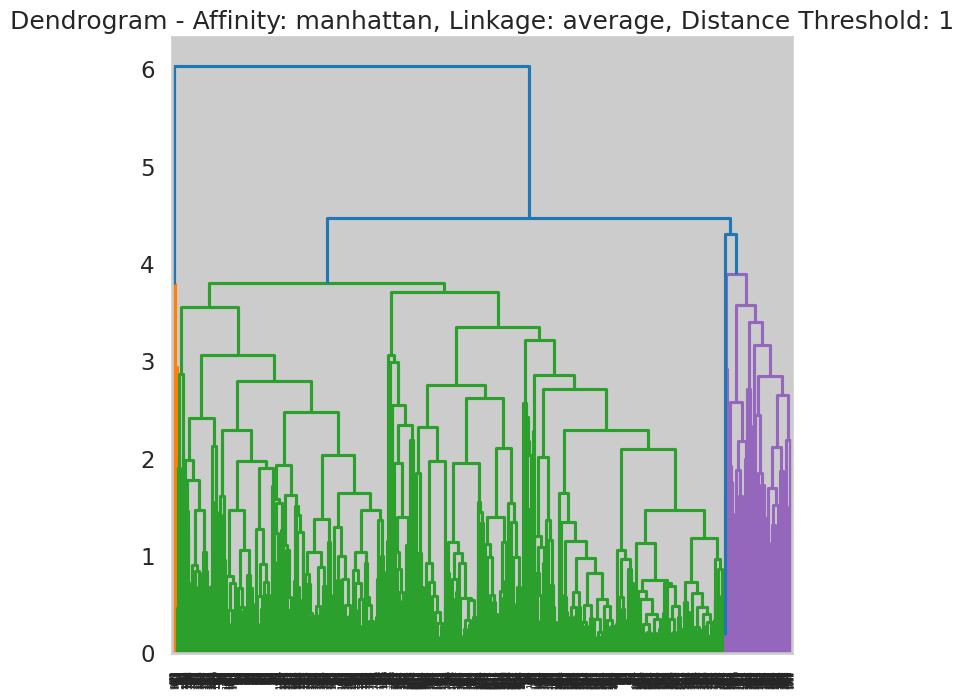

LENGTHHHHHHHHH ::::::::::::::::: 235


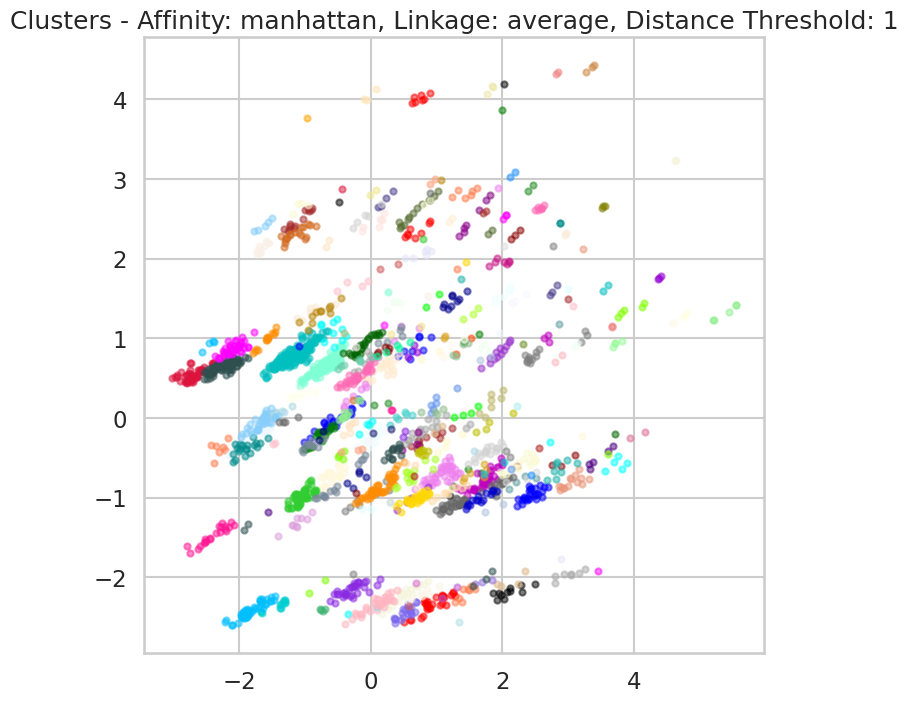

Silhouette Score - Affinity: manhattan, Linkage: average, Distance Threshold: 1: 0.45613519286921184


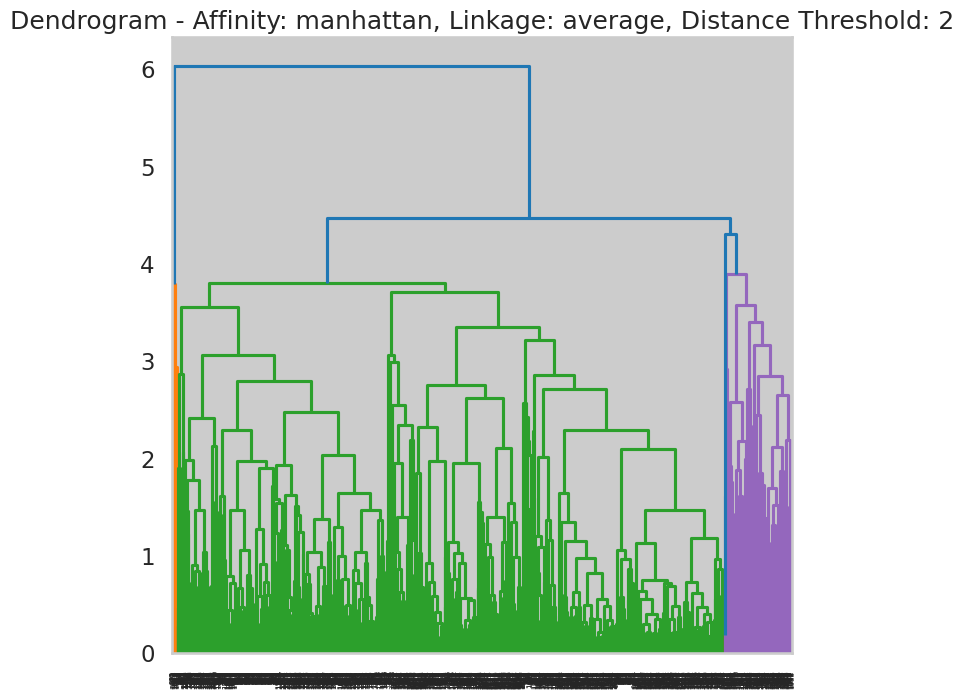

LENGTHHHHHHHHH ::::::::::::::::: 108


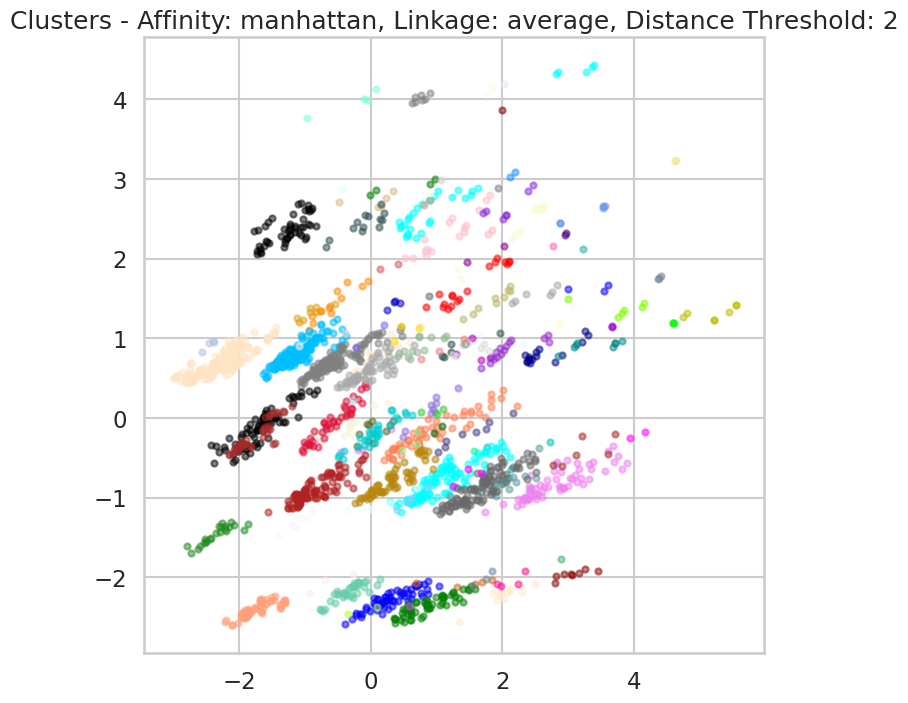

Silhouette Score - Affinity: manhattan, Linkage: average, Distance Threshold: 2: 0.46414927524605853


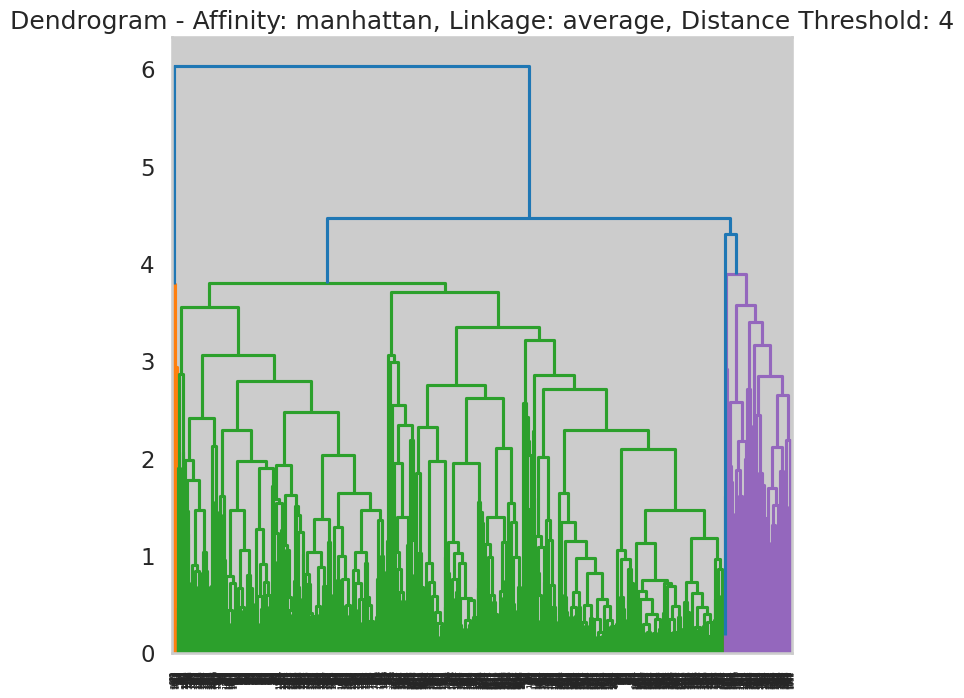

LENGTHHHHHHHHH ::::::::::::::::: 32


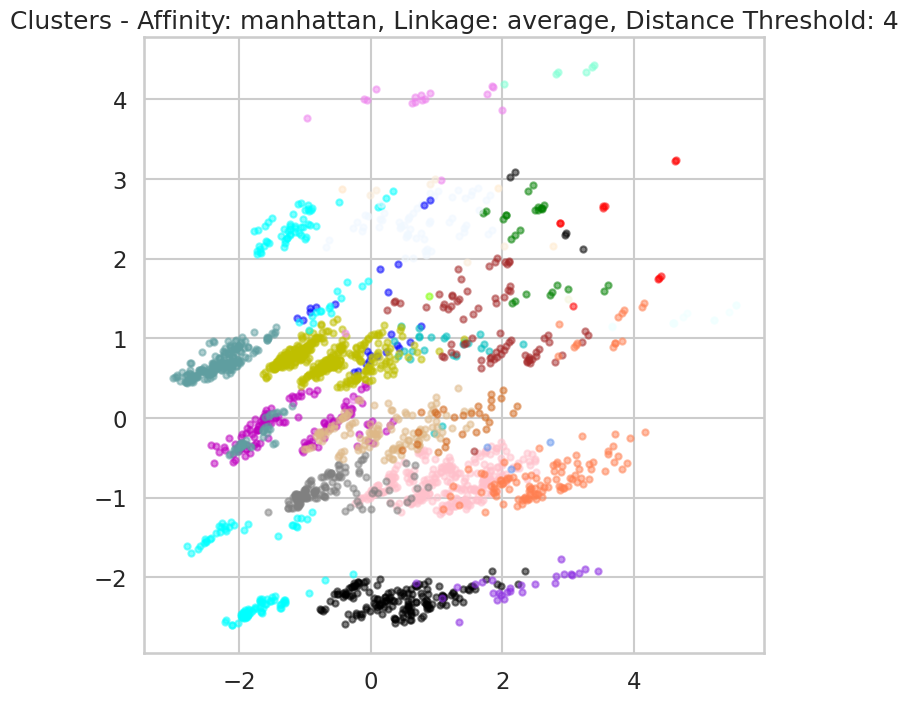

Silhouette Score - Affinity: manhattan, Linkage: average, Distance Threshold: 4: 0.34752085445136094


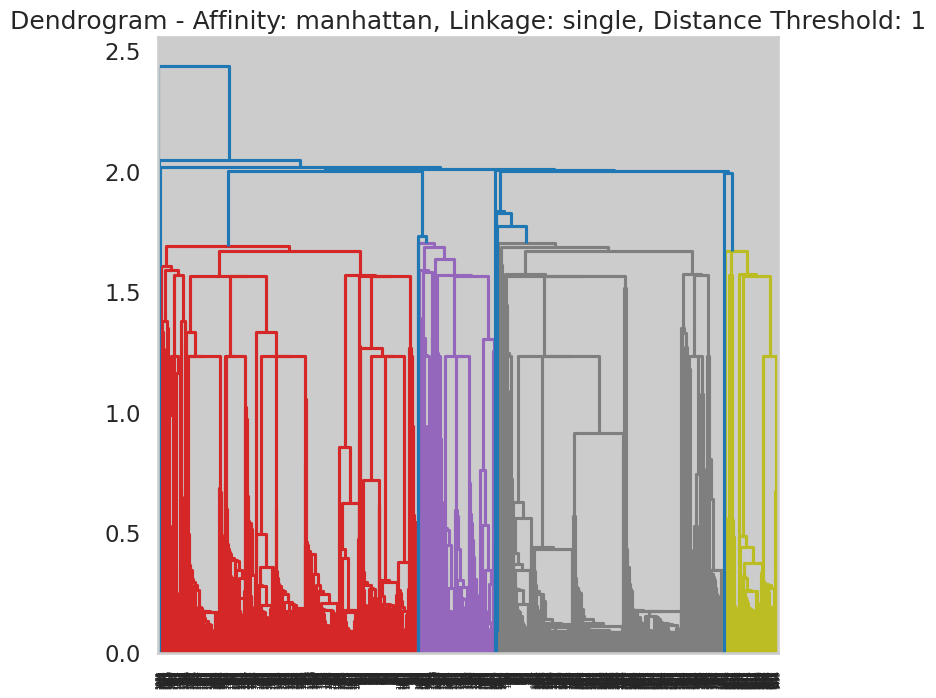

LENGTHHHHHHHHH ::::::::::::::::: 124


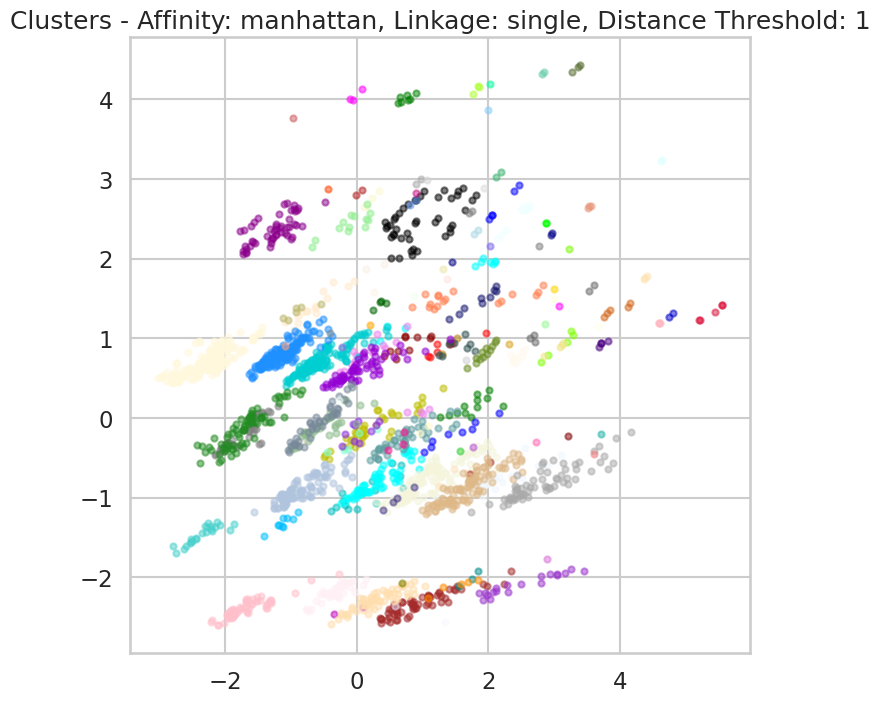

Silhouette Score - Affinity: manhattan, Linkage: single, Distance Threshold: 1: 0.46947118801456617


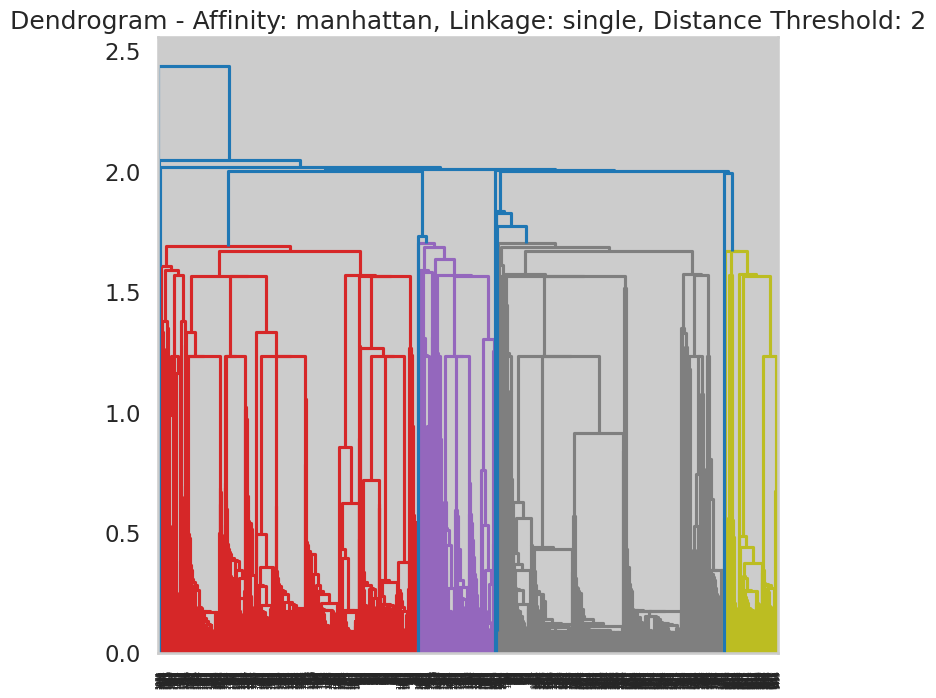

LENGTHHHHHHHHH ::::::::::::::::: 18


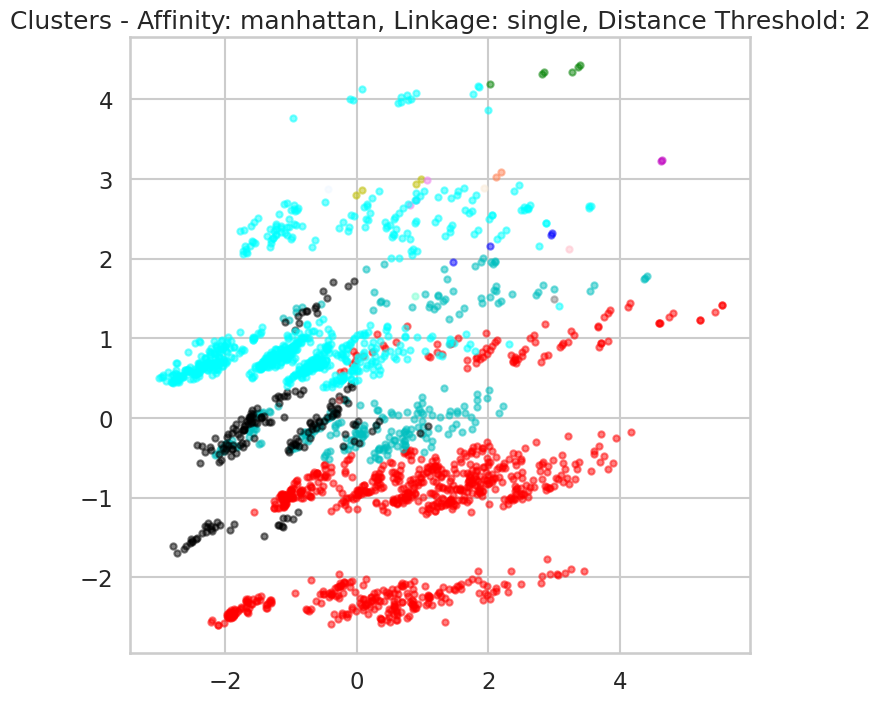

Silhouette Score - Affinity: manhattan, Linkage: single, Distance Threshold: 2: 0.10485701252284237


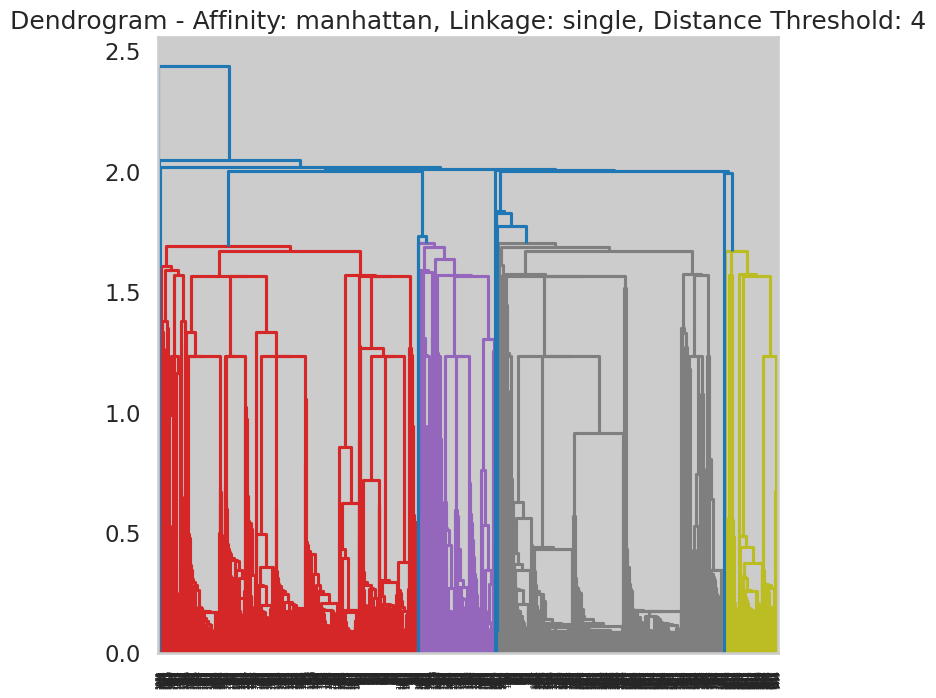

LENGTHHHHHHHHH ::::::::::::::::: 2


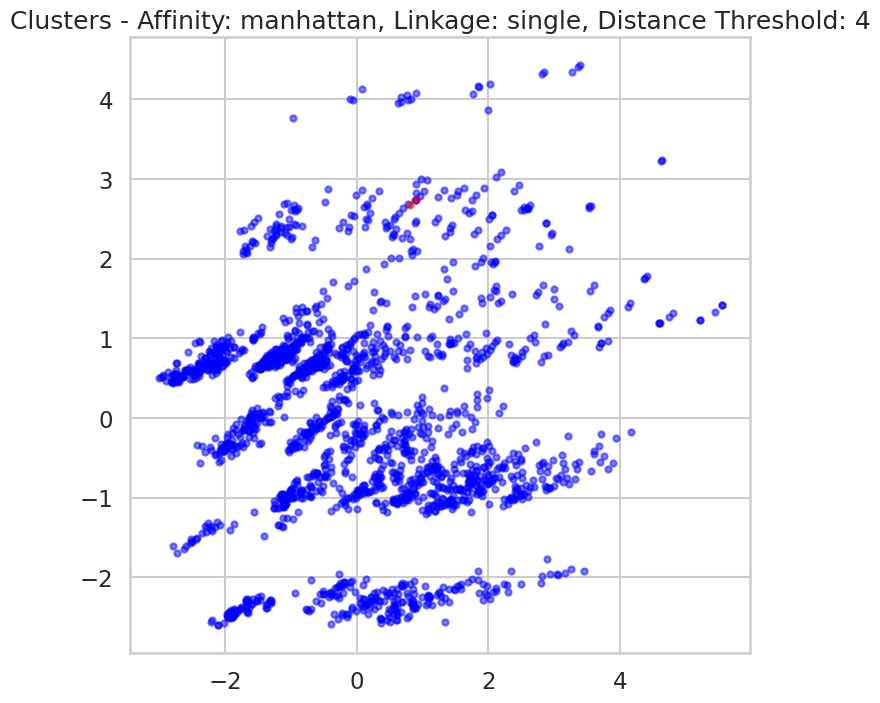

Silhouette Score - Affinity: manhattan, Linkage: single, Distance Threshold: 4: 0.34916658225914377


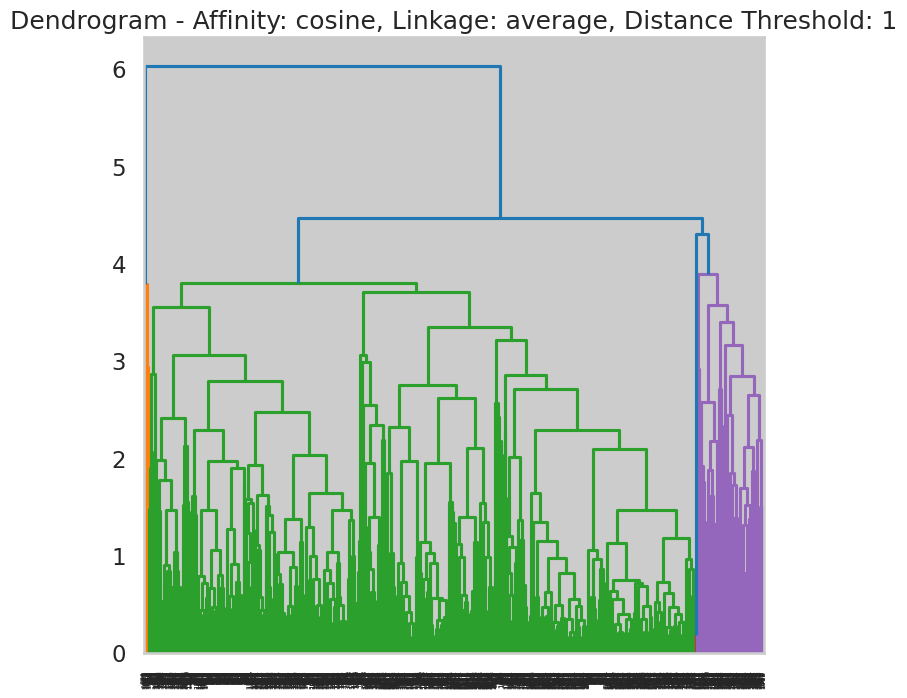

LENGTHHHHHHHHH ::::::::::::::::: 3


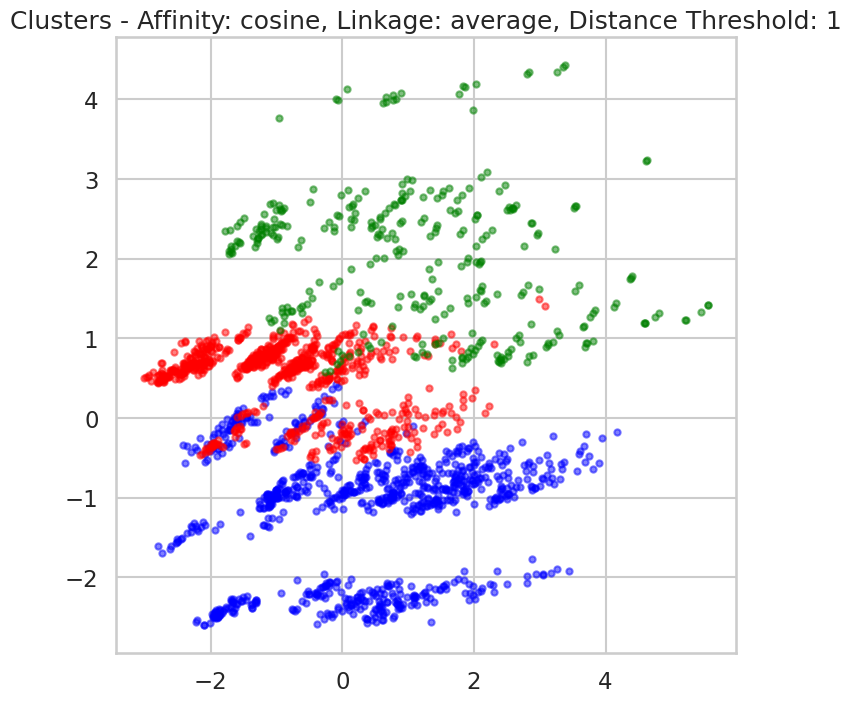

Silhouette Score - Affinity: cosine, Linkage: average, Distance Threshold: 1: 0.25731098431237015
Only one cluster created - Affinity: cosine, Linkage: average, Distance Threshold: 2. Skipping...
Only one cluster created - Affinity: cosine, Linkage: average, Distance Threshold: 4. Skipping...
Only one cluster created - Affinity: cosine, Linkage: single, Distance Threshold: 1. Skipping...
Only one cluster created - Affinity: cosine, Linkage: single, Distance Threshold: 2. Skipping...
Only one cluster created - Affinity: cosine, Linkage: single, Distance Threshold: 4. Skipping...

Best parameters: {'affinity': 'manhattan', 'linkage': 'single', 'distance_threshold': 1}
Best silhouette score: 0.46947118801456617


In [ ]:
from scipy.cluster.hierarchy import dendrogram
from sklearn.cluster import AgglomerativeClustering
import seaborn as sns
from scipy.cluster.hierarchy import dendrogram, linkage
import scipy


# Helper function to display clusters
def display_cluster(X, labels):
    pca = PCA(n_components=2)
    X_pca = pca.fit_transform(X)
    color = ['b', 'r', 'g', 'c', 'm', 'y', 'k', 'violet', 'aqua', 'pink', 'violet','grey', 'coral', 'brown']  # List of colors
    alpha = 0.5  # Color opacity
    s = 20
    print('LENGTHHHHHHHHH :::::::::::::::::',len(np.unique(labels)))
    for i in range(len(np.unique(labels))):
        plt.scatter(X_pca[labels == i, 0], X_pca[labels == i, 1], c=colors[i], alpha=alpha, s=s)



# Define parameter values to try
affinities = ['euclidean', 'manhattan', 'cosine']
linkages = ['average', 'single']
distance_thresholds = [1, 2, 4]

best_score = -1
best_params = {}

# Iterate over different parameter combinations
for affinity in affinities:
    for linkage in linkages:
        for distance_threshold in distance_thresholds:
            n_clusters = None
            model = AgglomerativeClustering(n_clusters=n_clusters, affinity=affinity, linkage=linkage, distance_threshold=distance_threshold)
            labels = model.fit_predict(data_array_normalized)
            if len(np.unique(labels)) > 1:
                score = silhouette_score(data_array_normalized, labels)

                # Display dendrogram
                Z = scipy.cluster.hierarchy.linkage(data_array_normalized, method=linkage)
                plt.figure()
                plt.title(f'Dendrogram - Affinity: {affinity}, Linkage: {linkage}, Distance Threshold: {distance_threshold}')
                dendrogram(Z)
                plt.show()

                # Display resulting clusters
                plt.figure()
                plt.title(f'Clusters - Affinity: {affinity}, Linkage: {linkage}, Distance Threshold: {distance_threshold}')
                display_cluster(data_array_normalized, labels)
                plt.show()

                print(f'Silhouette Score - Affinity: {affinity}, Linkage: {linkage}, Distance Threshold: {distance_threshold}: {score}')

                # Update best score and parameters if current score is better
                if score > best_score:
                    best_score = score
                    best_params['affinity'] = affinity
                    best_params['linkage'] = linkage
                    best_params['distance_threshold'] = distance_threshold
            else:
                print(f'Only one cluster created - Affinity: {affinity}, Linkage: {linkage}, Distance Threshold: {distance_threshold}. Skipping...')
                # best_params['distance_threshold'] = distance_threshold

# Print best parameters and score
print("\nBest parameters:", best_params)
print("Best silhouette score:", best_score)


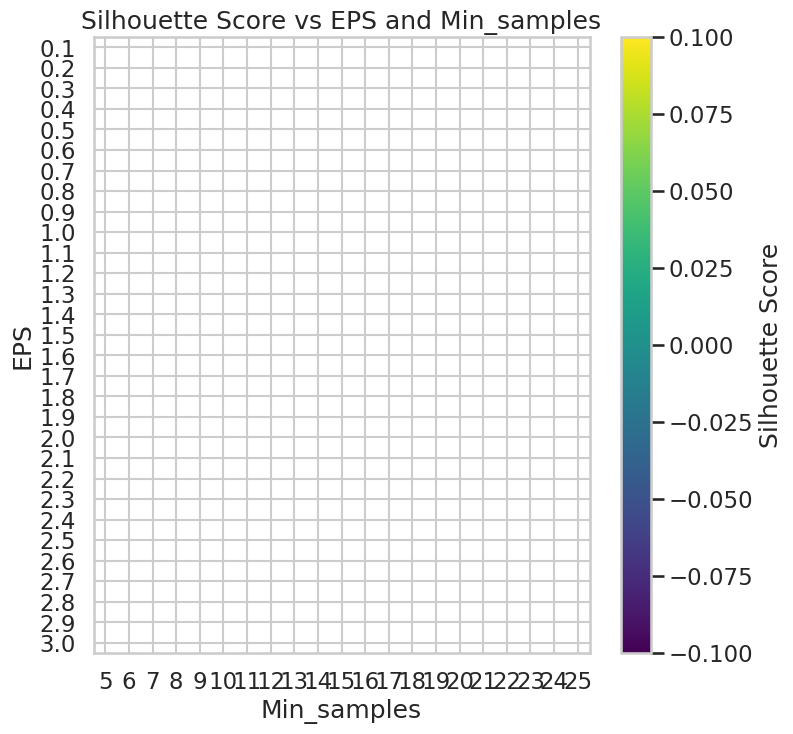


Best parameters: {}
Best silhouette score: -1


KeyError: 'EPS'

In [ ]:
# Define parameter values to try
EPS_values = np.linspace(0.1, 3, 30)
Min_samples_values = np.arange(5, 26)

best_score = -1
best_params = {}

# Iterate over different parameter combinations
for EPS in EPS_values:
    for Min_samples in Min_samples_values:
        model = DBSCAN(eps=EPS, min_samples=Min_samples)
        labels = model.fit_predict(data_array)

        # Exclude outliers (-1) from silhouette score calculation
        if len(np.unique(labels)) > 1:
            score = silhouette_score(data_array, labels)
            # Update best score and parameters if current score is better
            if score > best_score:
                best_score = score
                best_params['EPS'] = EPS
                best_params['Min_samples'] = Min_samples

# Plot silhouette score versus EPS and Min_samples
scores = np.zeros((len(EPS_values), len(Min_samples_values)))
for i, EPS in enumerate(EPS_values):
    for j, Min_samples in enumerate(Min_samples_values):
        model = DBSCAN(eps=EPS, min_samples=Min_samples)
        labels = model.fit_predict(data_array)
        if len(np.unique(labels)) > 1:
            scores[i, j] = silhouette_score(data_array, labels)
        else:
            scores[i, j] = np.nan

plt.figure()
plt.imshow(scores, interpolation='nearest', cmap='viridis', aspect='auto')
plt.colorbar(label='Silhouette Score')
plt.xticks(np.arange(len(Min_samples_values)), Min_samples_values)
plt.xlabel('Min_samples')
plt.yticks(np.arange(len(EPS_values)), np.round(EPS_values, 2))
plt.ylabel('EPS')
plt.title('Silhouette Score vs EPS and Min_samples')
plt.show()

# Print best parameters and score
print("\nBest parameters:", best_params)
print("Best silhouette score:", best_score)
best_model = DBSCAN(eps=best_params['EPS'], min_samples=best_params['Min_samples'])
best_labels = best_model.fit_predict(data_array)

pca = PCA(n_components=2)
X_pca = pca.fit_transform(data_array)
plt.figure()
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=best_model.labels_, cmap='viridis')
plt.title('Clusters for Best Parameters')
plt.xlabel('Feature 1')
plt.ylabel('Feature 2')
plt.colorbar(label='Cluster Label')
plt.show()


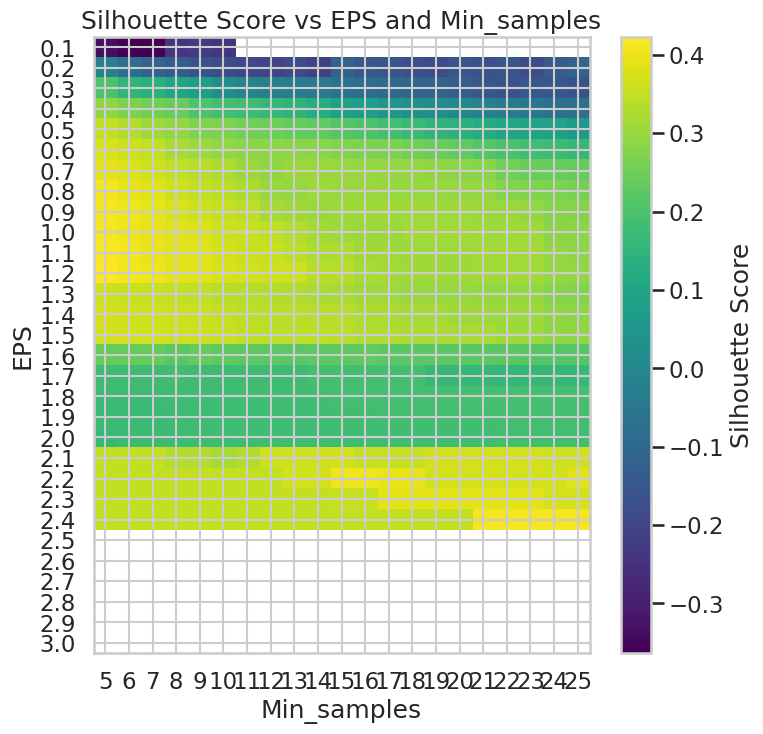


Best parameters: {'EPS': 1.2, 'Min_samples': 5}
Best silhouette score: 0.4225606832617864


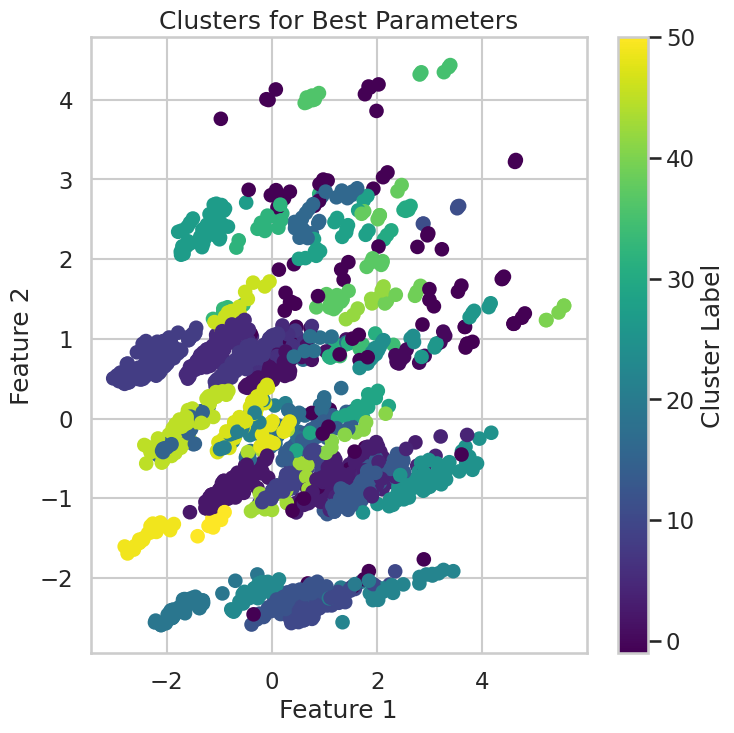

In [ ]:
# Define parameter values to try
EPS_values = np.linspace(0.1, 3, 30)
Min_samples_values = np.arange(5, 26)

best_score = -1
best_params = {}

# Iterate over different parameter combinations
for EPS in EPS_values:
    for Min_samples in Min_samples_values:
        model = DBSCAN(eps=EPS, min_samples=Min_samples)
        labels = model.fit_predict(data_array_normalized)

        # Exclude outliers (-1) from silhouette score calculation
        if len(np.unique(labels)) > 1:
            score = silhouette_score(data_array_normalized, labels)
            # Update best score and parameters if current score is better
            if score > best_score:
                best_score = score
                best_params['EPS'] = EPS
                best_params['Min_samples'] = Min_samples

# Plot silhouette score versus EPS and Min_samples
scores = np.zeros((len(EPS_values), len(Min_samples_values)))
for i, EPS in enumerate(EPS_values):
    for j, Min_samples in enumerate(Min_samples_values):
        model = DBSCAN(eps=EPS, min_samples=Min_samples)
        labels = model.fit_predict(data_array_normalized)
        if len(np.unique(labels)) > 1:
            scores[i, j] = silhouette_score(data_array_normalized, labels)
        else:
            scores[i, j] = np.nan

plt.figure()
plt.imshow(scores, interpolation='nearest', cmap='viridis', aspect='auto')
plt.colorbar(label='Silhouette Score')
plt.xticks(np.arange(len(Min_samples_values)), Min_samples_values)
plt.xlabel('Min_samples')
plt.yticks(np.arange(len(EPS_values)), np.round(EPS_values, 2))
plt.ylabel('EPS')
plt.title('Silhouette Score vs EPS and Min_samples')
plt.show()

# Print best parameters and score
print("\nBest parameters:", best_params)
print("Best silhouette score:", best_score)
best_model = DBSCAN(eps=best_params['EPS'], min_samples=best_params['Min_samples'])
best_labels = best_model.fit_predict(data_array_normalized)

pca = PCA(n_components=2)
X_pca = pca.fit_transform(data_array_normalized)
plt.figure()
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=best_model.labels_, cmap='viridis')
plt.title('Clusters for Best Parameters')
plt.xlabel('Feature 1')
plt.ylabel('Feature 2')
plt.colorbar(label='Cluster Label')
plt.show()


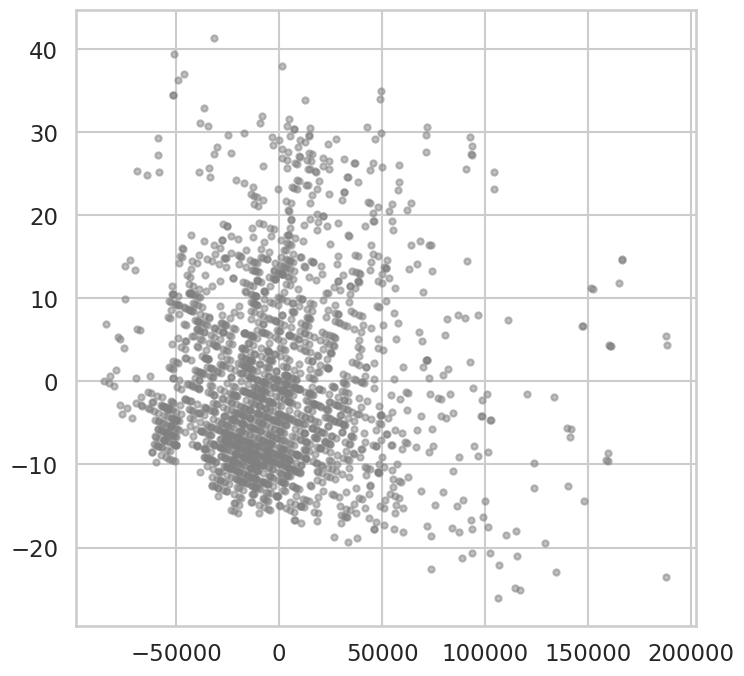

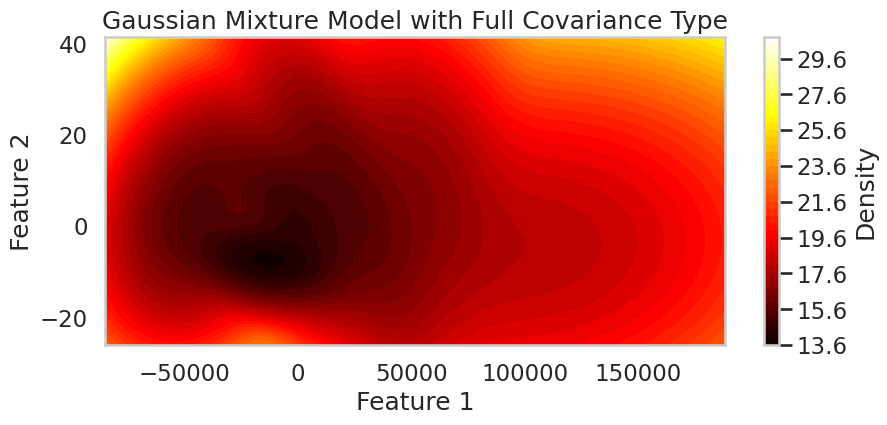

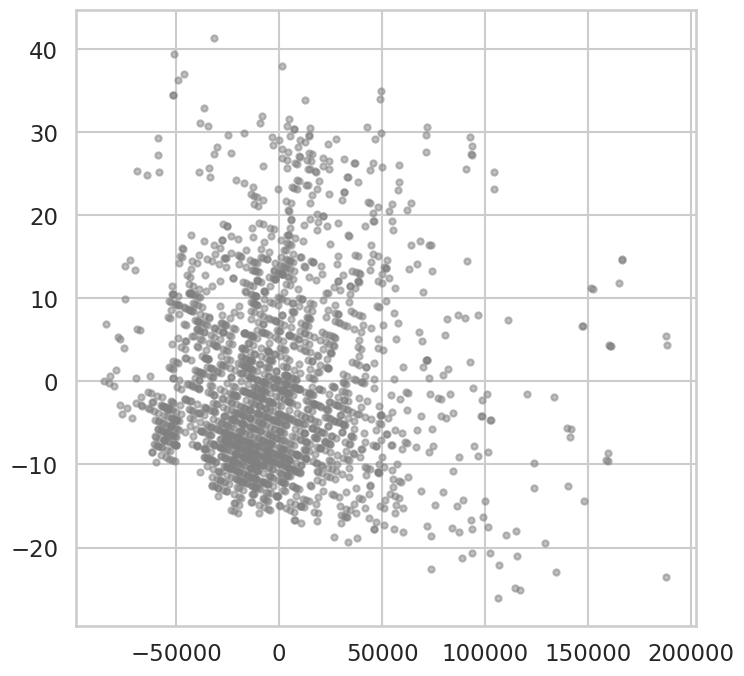

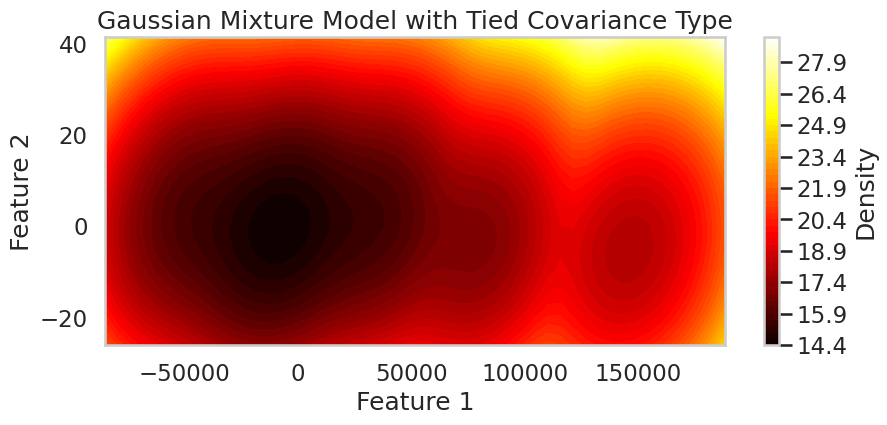

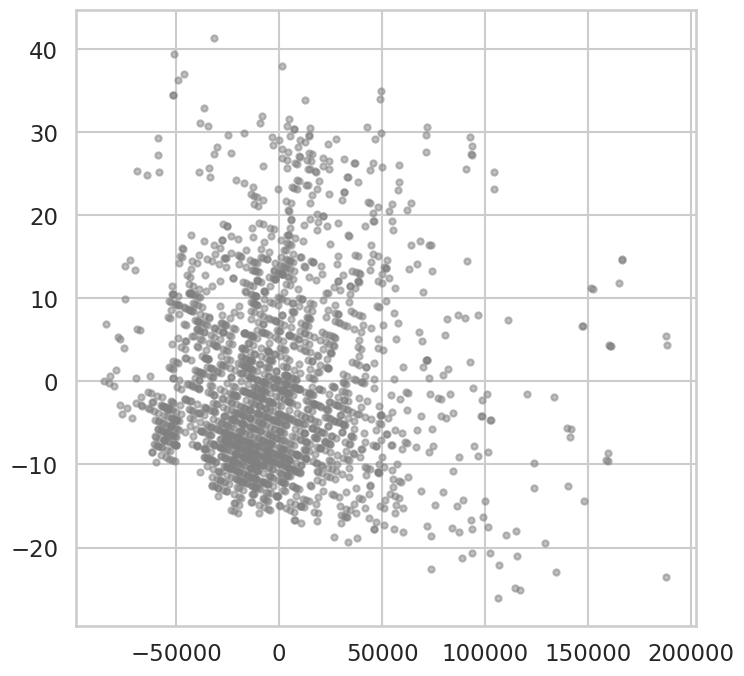

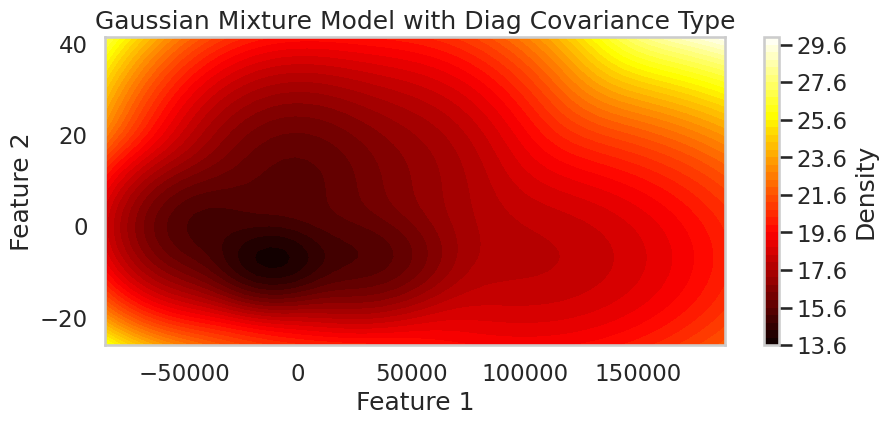

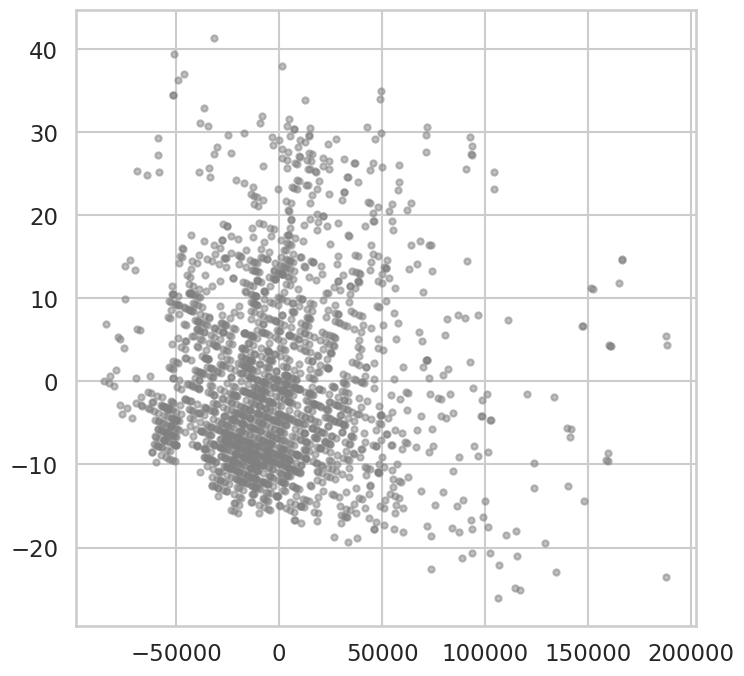

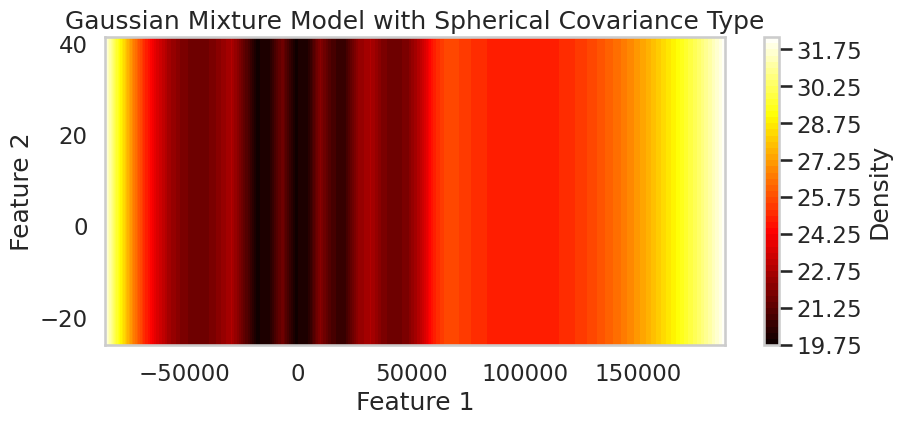

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.datasets import load_iris
from sklearn.mixture import GaussianMixture
import seaborn as sns


# Define covariance types to try
covariance_types = ['full', 'tied', 'diag', 'spherical']

# Plot all features against each other in pairs
# sns.pairplot(sns.load_dataset("iris"), diag_kind='kde', markers='.')
# plt.suptitle('Pairplot of Iris Dataset', y=1.02)
# plt.show()

# Fit Gaussian mixture models with different covariance types
for cov_type in covariance_types:
    pca = PCA(n_components=2)
    X_pca = pca.fit_transform(data_array)
    plt.figure()
    plt.scatter(X_pca[:, 0], X_pca[:, 1], marker='.', color='gray', alpha=0.5, label='Data')
    gmm = GaussianMixture(n_components=6, covariance_type=cov_type, random_state=42)
    gmm.fit(X_pca[:, :2])  # Use only the first two features for visualization
    x = np.linspace(X_pca[:, 0].min(), X_pca[:, 0].max())
    y = np.linspace(X_pca[:, 1].min(), X_pca[:, 1].max())
    X, Y = np.meshgrid(x, y)
    XX = np.array([X.ravel(), Y.ravel()]).T
    Z = -gmm.score_samples(XX)
    Z = Z.reshape(X.shape)
    plt.figure(figsize=(10, 4))
    plt.contourf(X, Y, Z, cmap='hot', levels=50)  # 'hot' colormap for heatmap-like colors
    plt.colorbar(label='Density')
    plt.xlim(X.min(), X.max())
    plt.ylim(Y.min(), Y.max())
    plt.scatter(X[:, 0], X[:, 1], s=10, color='black')  # Scatter plot of the data points
    plt.title(f'Gaussian Mixture Model with {cov_type.capitalize()} Covariance Type')
    plt.xlabel('Feature 1')
    plt.ylabel('Feature 2')
    plt.show()
    # CS = plt.contour(X, Y, Z, levels=10, linewidths=1, alpha=0.5, label=cov_type)
    # plt.colorbar(CS, shrink=0.8, extend='both')
    # plt.title(f'Gaussian Mixture Model with {cov_type.capitalize()} Covariance Type')
    # plt.xlabel('Feature 0')
    # plt.ylabel('Feature 1')
    # plt.legend()
    # plt.show()


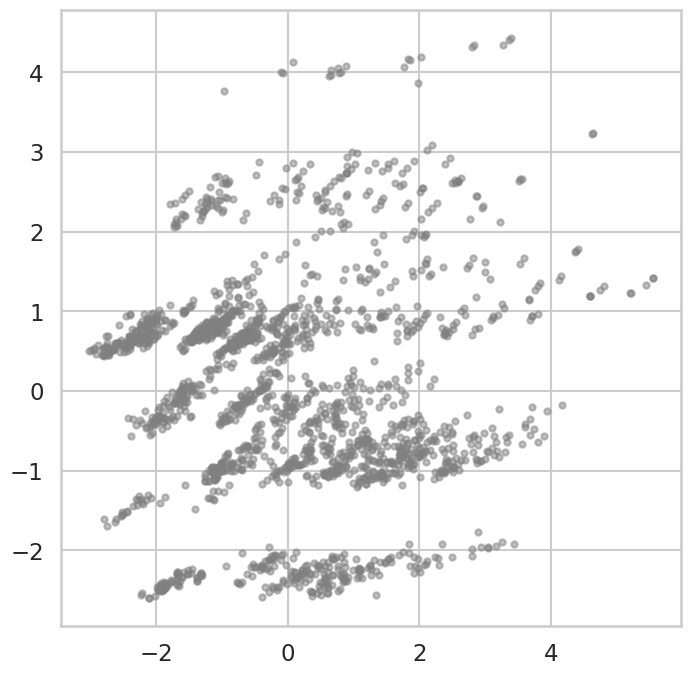

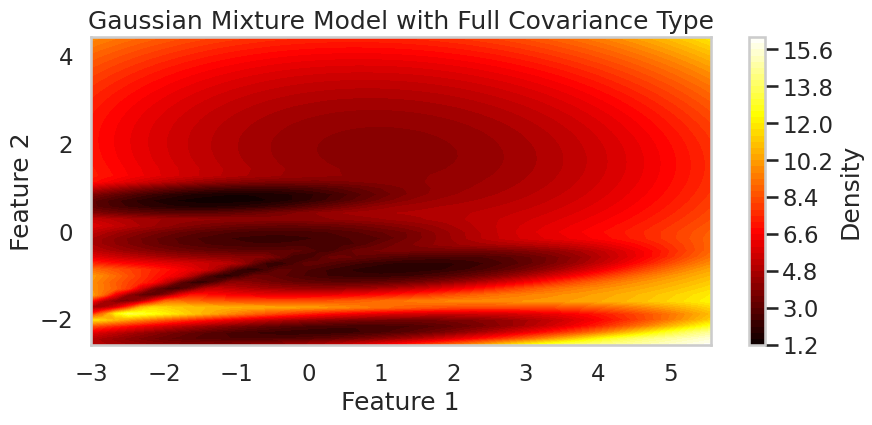

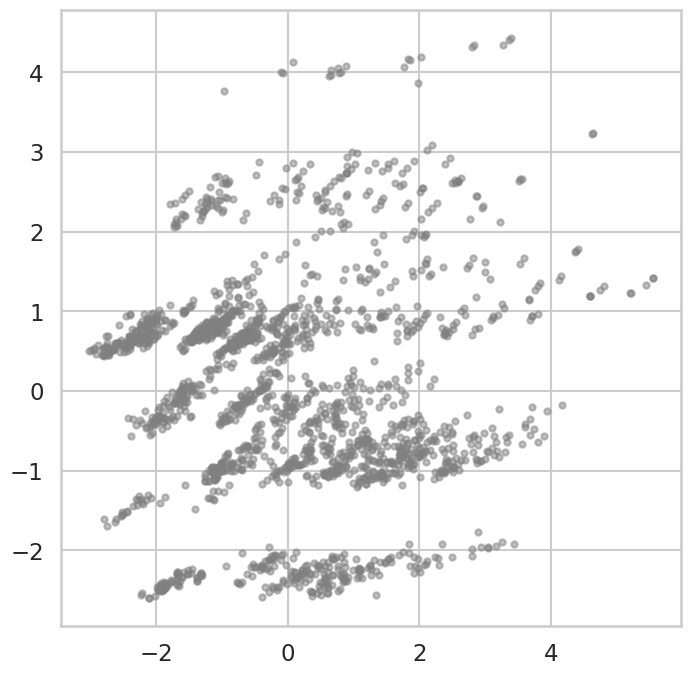

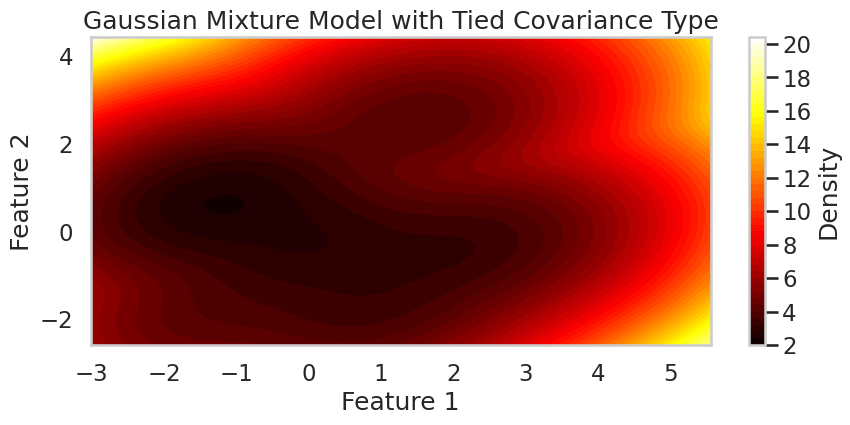

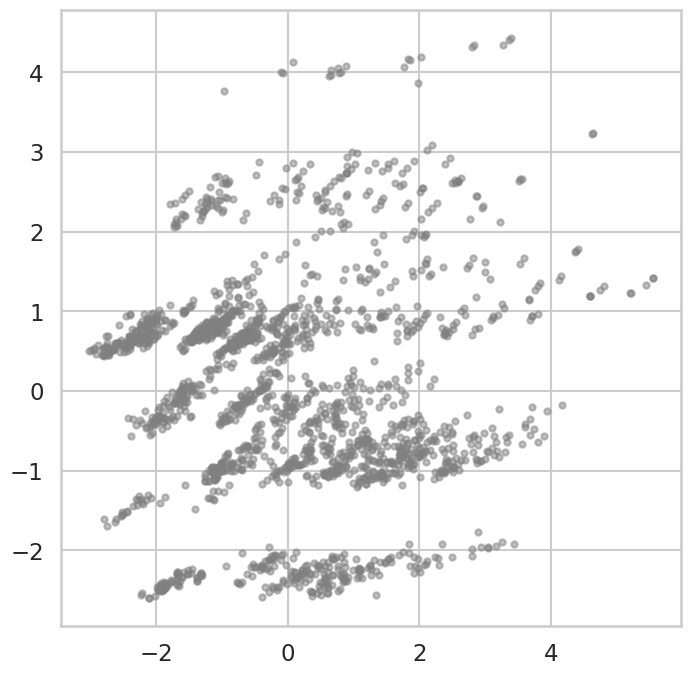

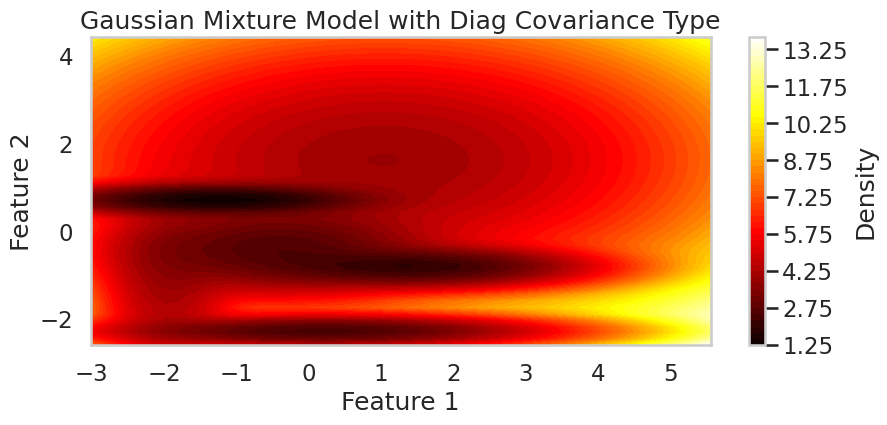

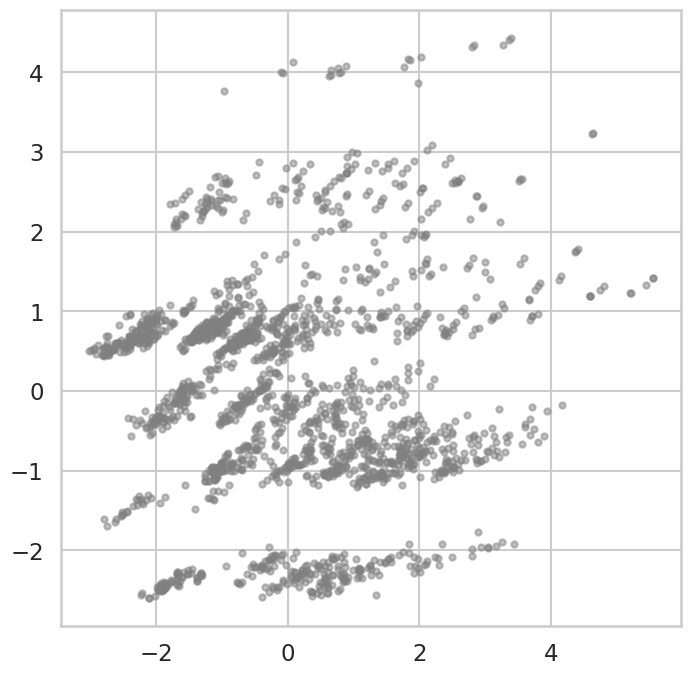

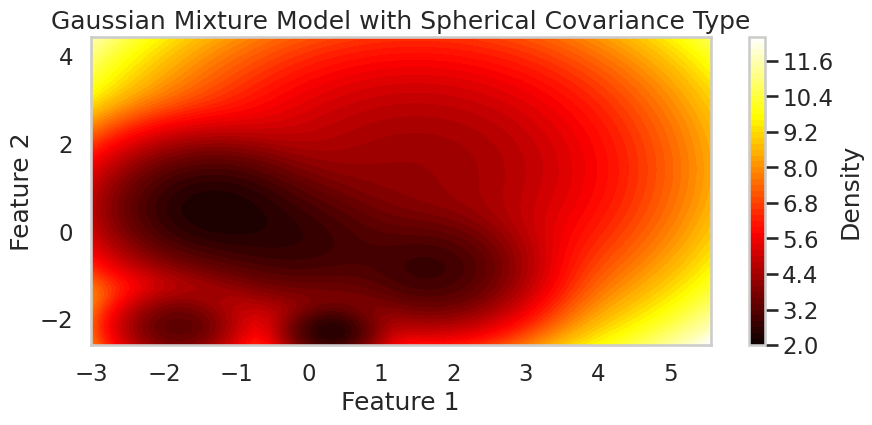

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.datasets import load_iris
from sklearn.mixture import GaussianMixture
import seaborn as sns


# Define covariance types to try
covariance_types = ['full', 'tied', 'diag', 'spherical']

# Plot all features against each other in pairs
# sns.pairplot(sns.load_dataset("iris"), diag_kind='kde', markers='.')
# plt.suptitle('Pairplot of Iris Dataset', y=1.02)
# plt.show()

# Fit Gaussian mixture models with different covariance types
for cov_type in covariance_types:
    pca = PCA(n_components=2)
    X_pca = pca.fit_transform(data_array_normalized)
    plt.figure()
    plt.scatter(X_pca[:, 0], X_pca[:, 1], marker='.', color='gray', alpha=0.5, label='Data')
    gmm = GaussianMixture(n_components=6, covariance_type=cov_type, random_state=42)
    gmm.fit(X_pca[:, :2])  # Use only the first two features for visualization
    x = np.linspace(X_pca[:, 0].min(), X_pca[:, 0].max())
    y = np.linspace(X_pca[:, 1].min(), X_pca[:, 1].max())
    X, Y = np.meshgrid(x, y)
    XX = np.array([X.ravel(), Y.ravel()]).T
    Z = -gmm.score_samples(XX)
    Z = Z.reshape(X.shape)
    plt.figure(figsize=(10, 4))
    plt.contourf(X, Y, Z, cmap='hot', levels=50)  # 'hot' colormap for heatmap-like colors
    plt.colorbar(label='Density')
    plt.xlim(X.min(), X.max())
    plt.ylim(Y.min(), Y.max())
    plt.scatter(X[:, 0], X[:, 1], s=10, color='black')  # Scatter plot of the data points
    plt.title(f'Gaussian Mixture Model with {cov_type.capitalize()} Covariance Type')
    plt.xlabel('Feature 1')
    plt.ylabel('Feature 2')
    plt.show()
    # CS = plt.contour(X, Y, Z, levels=10, linewidths=1, alpha=0.5, label=cov_type)
    # plt.colorbar(CS, shrink=0.8, extend='both')
    # plt.title(f'Gaussian Mixture Model with {cov_type.capitalize()} Covariance Type')
    # plt.xlabel('Feature 0')
    # plt.ylabel('Feature 1')
    # plt.legend()
    # plt.show()
